# Install MMSegmentation

In [2]:
!nvidia-smi

Sun Jun 19 03:39:26 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   46C    P0    31W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

1.11.0+cu113 True


In [4]:
# Install MMCV
!pip install mmcv-full -f https://download.openmmlab.com/mmcv/dist/cu113/torch1.11.0/index.html

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.openmmlab.com/mmcv/dist/cu113/torch1.11.0/index.html
     |████████████████████████████████| 38.0 MB 7.9 MB/s 
     |████████████████████████████████| 190 kB 5.2 MB/s 


In [5]:
!rm -rf mmsegmentation
!git clone https://github.com/museonghwang/mmsegmentation.git
%cd mmsegmentation
!pip install -e .

Cloning into 'mmsegmentation'...
remote: Enumerating objects: 7003, done.
remote: Total 7003 (delta 0), reused 0 (delta 0), pack-reused 7003
Receiving objects: 100% (7003/7003), 12.82 MiB | 22.40 MiB/s, done.
Resolving deltas: 100% (5197/5197), done.
/content/mmsegmentation
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Obtaining file:///content/mmsegmentation
     |████████████████████████████████| 577 kB 4.9 MB/s 
     |████████████████████████████████| 631 kB 41.7 MB/s 
  Created wheel for imgaug: filename=imgaug-0.2.6-py3-none-any.whl size=654017 sha256=df412a2f9fb047f59b3ac5a733cd9f7b7f337d19edc1e60d1a1234885624a178
  Stored in directory: /root/.cache/pip/wheels/89/72/98/3ebfdba1069a9a8eaaa7ae7265cfd67d63ef0197aaee2e5f9c
Successfully built imgaug
  Attempting uninstall: imgaug
    Found existing installation: imgaug 0.2.9
    Uninstalling imgaug-0.2.9:
      Successfully uninstalled imgaug-0.2.9
  Running setup.py develop for mms

In [ ]:
# 런타임 -> 런타임 "다시 시작" 후 아래 수행. 
# Check Pytorch installation
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

# Check MMSegmentation installation
import mmseg
print(mmseg.__version__)

1.11.0+cu113 True
0.24.1


# Run Inference with MMSeg trained weight

In [ ]:
%cd mmsegmentation
!mkdir checkpoints
!wget https://download.openmmlab.com/mmsegmentation/v0.5/hrnet/fcn_hr48_512x512_160k_ade20k/fcn_hr48_512x512_160k_ade20k_20200614_214407-a52fc02c.pth -P checkpoints

/content/mmsegmentation
--2022-06-04 07:16:06--  https://download.openmmlab.com/mmsegmentation/v0.5/hrnet/fcn_hr48_512x512_160k_ade20k/fcn_hr48_512x512_160k_ade20k_20200614_214407-a52fc02c.pth
Resolving download.openmmlab.com (download.openmmlab.com)... 47.75.20.18
Connecting to download.openmmlab.com (download.openmmlab.com)|47.75.20.18|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 264512327 (252M) [application/octet-stream]
Saving to: ‘checkpoints/fcn_hr48_512x512_160k_ade20k_20200614_214407-a52fc02c.pth’

fcn_hr48_512x512_16 100%[===================>] 252.26M  16.2MB/s    in 15s     

2022-06-04 07:16:22 (16.6 MB/s) - ‘checkpoints/fcn_hr48_512x512_160k_ade20k_20200614_214407-a52fc02c.pth’ saved [264512327/264512327]



In [ ]:
from mmseg.apis import inference_segmentor, init_segmentor, show_result_pyplot
from mmseg.core.evaluation import get_palette

In [ ]:
config_file = '/content/mmsegmentation/configs/hrnet/fcn_hr48_512x512_160k_ade20k.py'
checkpoint_file = '/content/mmsegmentation/checkpoints/fcn_hr48_512x512_160k_ade20k_20200614_214407-a52fc02c.pth'

In [ ]:
# build the model from a config file and a checkpoint file
model = init_segmentor(config_file, checkpoint_file, device='cuda:0')

/content/mmsegmentation/mmseg/models/losses/cross_entropy_loss.py:236: UserWarning: Default ``avg_non_ignore`` is False, if you would like to ignore the certain label and average loss over non-ignore labels, which is the same with PyTorch official cross_entropy, set ``avg_non_ignore=True``.
  'Default ``avg_non_ignore`` is False, if you would like to '


load checkpoint from local path: /content/mmsegmentation/checkpoints/fcn_hr48_512x512_160k_ade20k_20200614_214407-a52fc02c.pth


In [ ]:
# test a single image
img = '/content/mmsegmentation/demo/demo.png'
result = inference_segmentor(model, img)

/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


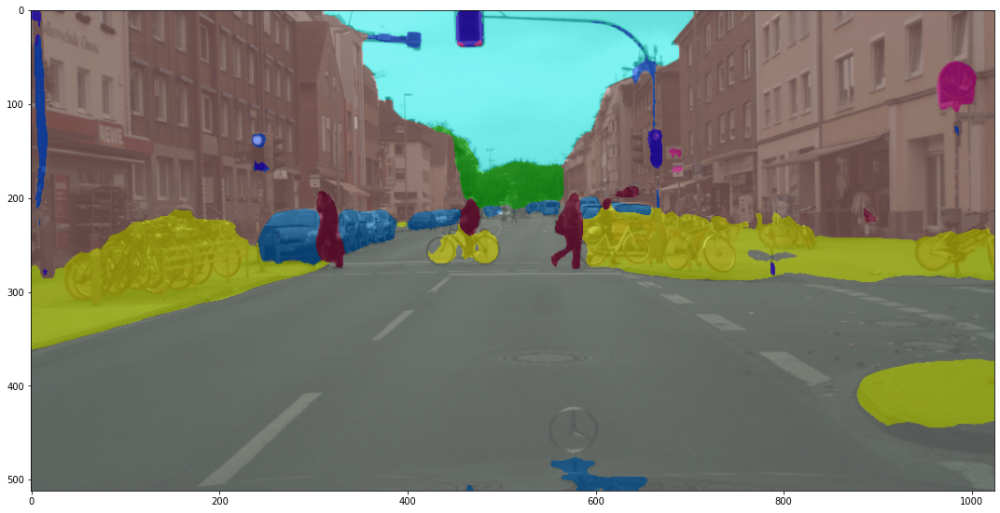

In [ ]:
# show the results
show_result_pyplot(model, img, result, get_palette('ade20k'))

## Train a semantic segmentation model on a new dataset

To train on a customized dataset, the following steps are necessary. 
1. Add a new dataset class. 
2. Create a config file accordingly. 
3. Perform training and evaluation. 

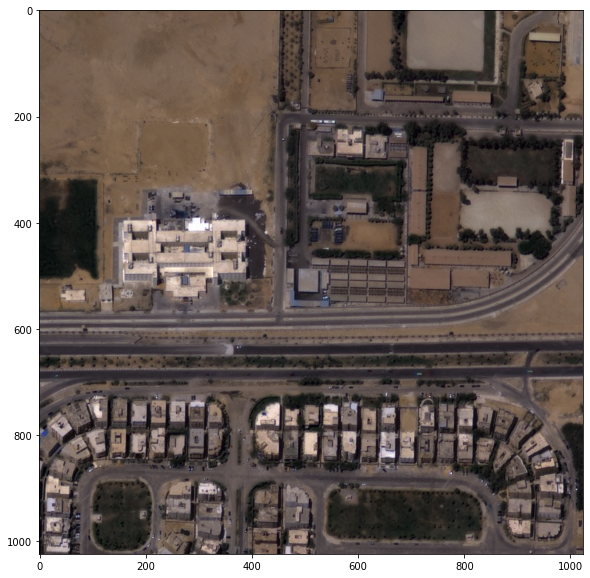

In [ ]:
# Let's take a look at the dataset
import mmcv
import matplotlib.pyplot as plt

img = mmcv.imread('/content/drive/Shareddrives/msmg/level2/dataset/train/building/image/BLD00006_PS3_K3A_NIA0276.png')
plt.figure(figsize=(10, 10))
plt.imshow(mmcv.bgr2rgb(img))
plt.show()

In [ ]:
import os.path as osp
import numpy as np
from PIL import Image
import cv2

# convert dataset annotation to semantic segmentation map
data_root = '/content/drive/Shareddrives/msmg/level2/dataset/train/building'
img_dir = 'image'
ann_dir = 'annotation'

# define class and plaette for better visualization
classes = ('background', 'building', 'border')
palette = [[0, 0, 0], [0, 0, 255], [255, 0, 0]]

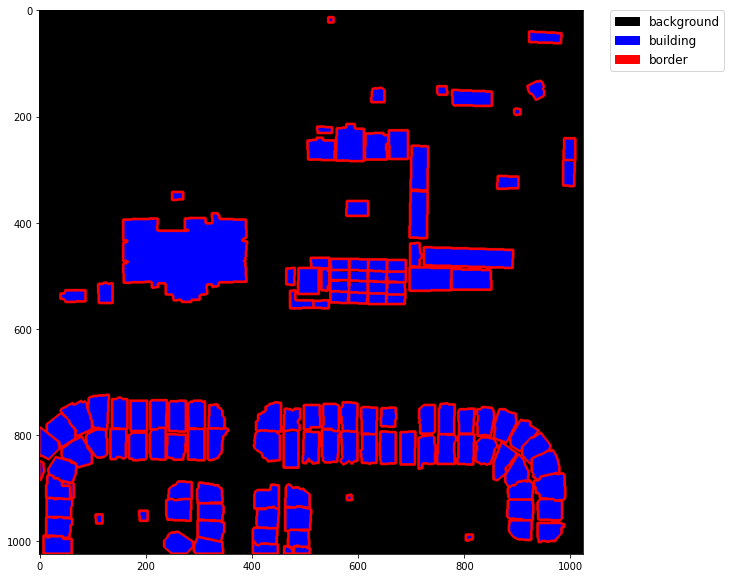

In [ ]:
# Let's take a look at the segmentation map we got
import matplotlib.patches as mpatches

img = Image.open('/content/drive/Shareddrives/msmg/level2/dataset/train/building/annotation/BLD00006_PS3_K3A_NIA0276.png')
plt.figure(figsize=(10, 10))
im = plt.imshow(np.array(img.convert('RGB')))

# create a patch (proxy artist) for every color 
patches = [mpatches.Patch(color=np.array(palette[i])/255., label=classes[i]) for i in range(3)]

# put those patched as legend-handles into the legend
plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize='large')

plt.show()

# Create a config file
In the next step, we need to modify the config for the training. To accelerate the process, we finetune the model from trained weights.

In [ ]:
config_file = '/content/mmsegmentation/configs/hrnet/fcn_hr48_512x512_160k_ade20k.py'
checkpoint_file = '/content/mmsegmentation/checkpoints/fcn_hr48_512x512_160k_ade20k_20200614_214407-a52fc02c.pth'
save_pth_path = '/content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint'

In [ ]:
# convert dataset annotation to semantic segmentation map
data_root = '/content/drive/Shareddrives/msmg/level2/dataset/train/building'
img_dir = 'image'
ann_dir = 'annotation'

# define class and plaette for better visualization
classes = ('background', 'building', 'border')
palette = [[0, 0, 0], [0, 0, 255], [255, 0, 0]]

In [ ]:
from mmseg.datasets.builder import DATASETS
from mmseg.datasets.custom import CustomDataset

@DATASETS.register_module(force=True)
class BuildingSemanticSegmentation(CustomDataset):
    CLASSES = classes
    PALETTE = palette
    def __init__(self, split, **kwargs):
        super().__init__(img_suffix='.png', seg_map_suffix='.png', split=split, **kwargs)
        assert osp.exists(self.img_dir) and self.split is not None

In [ ]:
from mmcv import Config

cfg = Config.fromfile(config_file)

In [ ]:
from mmseg.apis import set_random_seed

# add CLASSES and PALETTE to checkpoint
cfg.checkpoint_config.meta = dict(
    CLASSES=classes,
    PALETTE=palette)

# Since we use only one GPU, BN is used instead of SyncBN
cfg.norm_cfg = dict(type='BN', requires_grad=True)

#cfg.model.backbone.norm_cfg = cfg.norm_cfg
cfg.model.decode_head.norm_cfg = cfg.norm_cfg
cfg.model.backbone.norm_cfg = cfg.norm_cfg

# modify num classes of the model in decode/auxiliary head
cfg.model.decode_head.num_classes = 3

# modify loss function crossentropy
cfg.model.decode_head.loss_decode = [
                                     dict(type='CrossEntropyLoss', loss_weight = 1.0),
                                     dict(type='LovaszLoss', loss_weight = 10.0, reduction='none')]


# Modify dataset type and path
cfg.dataset_type = 'BuildingSemanticSegmentation'
cfg.data_root = data_root

cfg.data.samples_per_gpu = 8
cfg.data.workers_per_gpu = 8

# pipline
cfg.img_norm_cfg = dict(
    mean=[123.675, 116.28, 103.53], std=[58.395, 57.12, 57.375], to_rgb=True)
cfg.crop_size = (512, 512)
cfg.train_pipeline = [
    dict(type='LoadImageFromFile'),
    dict(type='LoadAnnotations'),
    dict(type='Resize', img_scale=(1024, 1024), ratio_range=(0.5, 1.5)),
    dict(type='RandomCrop', crop_size=cfg.crop_size, cat_max_ratio=0.75),
    dict(type='RandomFlip', flip_ratio=0.5),
    dict(type='PhotoMetricDistortion'),
    dict(type='Normalize', **cfg.img_norm_cfg),
    dict(type='Pad', size=cfg.crop_size, pad_val=0, seg_pad_val=255),
    dict(type='DefaultFormatBundle'),
    dict(type='Collect', keys=['img', 'gt_semantic_seg']),
]

cfg.test_pipeline = [
    dict(type='LoadImageFromFile'),
    dict(
        type='MultiScaleFlipAug',
        img_scale=(1024, 1024),
        # img_ratios=[0.5, 0.75, 1.0, 1.25, 1.5, 1.75],
        flip=False,
        transforms=[
            dict(type='Resize', keep_ratio=True),
            dict(type='RandomFlip'),
            dict(type='Normalize', **cfg.img_norm_cfg),
            dict(type='ImageToTensor', keys=['img']),
            dict(type='Collect', keys=['img']),
        ])
]

cfg.data.train.type = cfg.dataset_type
cfg.data.train.data_root = '/content/drive/Shareddrives/msmg/level2/dataset/train/building/'
cfg.data.train.img_dir = 'image'
cfg.data.train.ann_dir = 'annotation'
cfg.data.train.pipeline = cfg.train_pipeline
cfg.data.train.split = 'split/train_ratio95.txt'

cfg.data.val.type = cfg.dataset_type
cfg.data.val.data_root = '/content/drive/Shareddrives/msmg/level2/dataset/validation/building/'
cfg.data.val.img_dir = 'image'
cfg.data.val.ann_dir = 'annotation'
cfg.data.val.pipeline = cfg.test_pipeline
cfg.data.val.split = 'split/validation.txt'

cfg.data.test.type = cfg.dataset_type
cfg.data.test.data_root = '/content/drive/Shareddrives/msmg/level2/dataset/validation/building/'
cfg.data.test.img_dir = 'image'
cfg.data.test.ann_dir = 'annotation'
cfg.data.test.pipeline = cfg.test_pipeline
cfg.data.test.split = 'split/validation.txt'

# We can still use the pre-trained Mask RCNN model though we do not need to
# use the mask branch
cfg.load_from = checkpoint_file

# Set up working dir to save files and logs.
cfg.work_dir = save_pth_path

cfg.runner.max_iters = 30000
cfg.log_config.interval = 10
cfg.evaluation.interval = 100
cfg.evaluation.save_best = 'mIoU'
cfg.checkpoint_config.interval = 2000

# Set seed to facitate reproducing the result
cfg.seed = 0
set_random_seed(0, deterministic=False)
cfg.gpu_ids = range(1)

cfg.device='cuda' 

# We can also use tensorboard to log the training process
cfg.log_config.hooks = [
    dict(type='TextLoggerHook'),
    dict(type='TensorboardLoggerHook')]

# Let's have a look at the final config used for training
print(f'Config:\n{cfg.pretty_text}')

Config:
norm_cfg = dict(type='BN', requires_grad=True)
model = dict(
    type='EncoderDecoder',
    pretrained='open-mmlab://msra/hrnetv2_w48',
    backbone=dict(
        type='HRNet',
        norm_cfg=dict(type='BN', requires_grad=True),
        norm_eval=False,
        extra=dict(
            stage1=dict(
                num_modules=1,
                num_branches=1,
                block='BOTTLENECK',
                num_blocks=(4, ),
                num_channels=(64, )),
            stage2=dict(
                num_modules=1,
                num_branches=2,
                block='BASIC',
                num_blocks=(4, 4),
                num_channels=(48, 96)),
            stage3=dict(
                num_modules=4,
                num_branches=3,
                block='BASIC',
                num_blocks=(4, 4, 4),
                num_channels=(48, 96, 192)),
            stage4=dict(
                num_modules=3,
                num_branches=4,
                block='BASIC',
     

# Train and Evaluation

In [ ]:
from mmseg.datasets import build_dataset
from mmseg.models import build_segmentor
from mmseg.apis import train_segmentor

# Build the dataset
datasets = [build_dataset(cfg.data.train)]

2022-06-04 07:39:28,828 - mmseg - INFO - Loaded 918 images


In [ ]:
# Build the detector
model = build_segmentor(
    cfg.model, train_cfg=cfg.get('train_cfg'), test_cfg=cfg.get('test_cfg'))

# Add an attribute for visualization convenience
model.CLASSES = datasets[0].CLASSES

/content/mmsegmentation/mmseg/models/backbones/hrnet.py:318: UserWarning: DeprecationWarning: pretrained is deprecated, please use "init_cfg" instead
  warnings.warn('DeprecationWarning: pretrained is deprecated, '
/content/mmsegmentation/mmseg/models/losses/cross_entropy_loss.py:236: UserWarning: Default ``avg_non_ignore`` is False, if you would like to ignore the certain label and average loss over non-ignore labels, which is the same with PyTorch official cross_entropy, set ``avg_non_ignore=True``.
  'Default ``avg_non_ignore`` is False, if you would like to '


In [ ]:
# Create work_dir
mmcv.mkdir_or_exist(osp.abspath(cfg.work_dir))
train_segmentor(model, datasets, cfg, distributed=False, validate=True, meta=dict())

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:490: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
2022-06-04 07:39:39,275 - mmseg - INFO - Loaded 159 images
2022-06-04 07:39:39,283 - mmseg - INFO - load checkpoint from local path: /content/mmsegmentation/checkpoints/fcn_hr48_512x512_160k_ade20k_20200614_214407-a52fc02c.pth
2022-06-04 07:39:39,967 - mmseg - WARNING - The model and loaded state dict do not match exactly

size mismatch for decode_head.conv_seg.weight: copying a param with shape torch.Size([150, 720, 1, 1]) from checkpoint, the shape in current model is torch.Size([3, 720, 1, 1]).
size mismatch for decode_head.conv_seg.bi

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 1.0 task/s, elapsed: 160s, ETA:     0s

2022-06-04 07:45:11,419 - mmseg - INFO - per class results:
2022-06-04 07:45:11,421 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 75.56 | 90.29 |
|  building  | 34.62 | 42.57 |
|   border   | 19.74 | 33.45 |
+------------+-------+-------+
2022-06-04 07:45:11,423 - mmseg - INFO - Summary:
2022-06-04 07:45:11,427 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 75.32 | 43.31 | 55.44 |
+-------+-------+-------+
2022-06-04 07:45:15,931 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_100.pth.
2022-06-04 07:45:15,934 - mmseg - INFO - Best mIoU is 0.4331 at 100 iter.
2022-06-04 07:45:15,937 - mmseg - INFO - Iter(val) [159]	aAcc: 0.7532, mIoU: 0.4331, mAcc: 0.5544, IoU.background: 0.7556, IoU.building: 0.3462, IoU.border: 0.1974, Acc.background: 0.9029, Acc.building: 0.4257, Acc.border: 0.3345
2022-06-04 07:45:31,533 - mmseg - INFO - Iter [110/30000]	

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.4 task/s, elapsed: 36s, ETA:     0s

2022-06-04 07:48:35,976 - mmseg - INFO - per class results:
2022-06-04 07:48:35,979 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 75.67 | 77.78 |
|  building  | 53.42 | 83.85 |
|   border   | 29.59 | 59.07 |
+------------+-------+-------+
2022-06-04 07:48:35,983 - mmseg - INFO - Summary:
2022-06-04 07:48:35,990 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 77.34 | 52.89 | 73.56 |
+-------+-------+-------+
2022-06-04 07:48:36,001 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_100.pth was removed
2022-06-04 07:48:40,874 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_200.pth.
2022-06-04 07:48:40,876 - mmseg - INFO - Best mIoU is 0.5289 at 200 iter.
2022-06-04 07:48:40,883 - mmseg - INFO - Iter(val) [159]	aAcc: 0.7734, mIoU: 0.5289, mAcc: 0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.3 task/s, elapsed: 37s, ETA:     0s

2022-06-04 07:52:00,956 - mmseg - INFO - per class results:
2022-06-04 07:52:00,958 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  85.5 | 92.77 |
|  building  | 58.87 | 70.38 |
|   border   |  33.1 | 53.07 |
+------------+-------+-------+
2022-06-04 07:52:00,962 - mmseg - INFO - Summary:
2022-06-04 07:52:00,966 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 84.57 | 59.16 | 72.07 |
+-------+-------+-------+
2022-06-04 07:52:00,981 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_200.pth was removed
2022-06-04 07:52:05,360 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_300.pth.
2022-06-04 07:52:05,362 - mmseg - INFO - Best mIoU is 0.5916 at 300 iter.
2022-06-04 07:52:05,370 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8457, mIoU: 0.5916, mAcc: 0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.4 task/s, elapsed: 36s, ETA:     0s

2022-06-04 07:55:24,939 - mmseg - INFO - per class results:
2022-06-04 07:55:24,942 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 86.91 | 92.38 |
|  building  | 63.98 | 79.44 |
|   border   | 34.35 | 51.75 |
+------------+-------+-------+
2022-06-04 07:55:24,944 - mmseg - INFO - Summary:
2022-06-04 07:55:24,953 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 86.05 | 61.75 | 74.52 |
+-------+-------+-------+
2022-06-04 07:55:24,965 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_300.pth was removed
2022-06-04 07:55:29,413 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_400.pth.
2022-06-04 07:55:29,445 - mmseg - INFO - Best mIoU is 0.6175 at 400 iter.
2022-06-04 07:55:29,450 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8605, mIoU: 0.6175, mAcc: 0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.4 task/s, elapsed: 36s, ETA:     0s

2022-06-04 07:58:49,454 - mmseg - INFO - per class results:
2022-06-04 07:58:49,456 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 86.84 | 90.61 |
|  building  | 65.01 | 87.19 |
|   border   | 34.11 | 48.58 |
+------------+-------+-------+
2022-06-04 07:58:49,459 - mmseg - INFO - Summary:
2022-06-04 07:58:49,463 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 86.12 | 61.99 | 75.46 |
+-------+-------+-------+
2022-06-04 07:58:49,476 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_400.pth was removed
2022-06-04 07:58:53,602 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_500.pth.
2022-06-04 07:58:53,606 - mmseg - INFO - Best mIoU is 0.6199 at 500 iter.
2022-06-04 07:58:53,608 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8612, mIoU: 0.6199, mAcc: 0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 08:02:11,225 - mmseg - INFO - per class results:
2022-06-04 08:02:11,227 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  85.3 | 88.77 |
|  building  | 63.93 | 80.01 |
|   border   | 35.02 | 63.39 |
+------------+-------+-------+
2022-06-04 08:02:11,230 - mmseg - INFO - Summary:
2022-06-04 08:02:11,231 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 84.68 | 61.42 | 77.39 |
+-------+-------+-------+
2022-06-04 08:02:11,237 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8468, mIoU: 0.6142, mAcc: 0.7739, IoU.background: 0.8530, IoU.building: 0.6393, IoU.border: 0.3502, Acc.background: 0.8877, Acc.building: 0.8001, Acc.border: 0.6339
2022-06-04 08:02:26,776 - mmseg - INFO - Iter [610/30000]	lr: 9.819e-03, eta: 18:14:34, time: 4.952, data_time: 3.408, memory: 10895, decode.loss_ce: 0.4861, decode.loss_lovasz: 4.2538, decode.acc_seg: 80.9604, loss: 4.7399
2022-

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.4 task/s, elapsed: 36s, ETA:     0s

2022-06-04 08:05:30,353 - mmseg - INFO - per class results:
2022-06-04 08:05:30,356 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 88.53 | 92.09 |
|  building  |  68.4 |  79.9 |
|   border   | 38.86 | 66.67 |
+------------+-------+-------+
2022-06-04 08:05:30,358 - mmseg - INFO - Summary:
2022-06-04 08:05:30,364 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 87.28 | 65.26 | 79.55 |
+-------+-------+-------+
2022-06-04 08:05:30,374 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_500.pth was removed
2022-06-04 08:05:34,540 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_700.pth.
2022-06-04 08:05:34,542 - mmseg - INFO - Best mIoU is 0.6526 at 700 iter.
2022-06-04 08:05:34,548 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8728, mIoU: 0.6526, mAcc: 0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.2 task/s, elapsed: 38s, ETA:     0s

2022-06-04 08:08:54,807 - mmseg - INFO - per class results:
2022-06-04 08:08:54,810 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 87.56 | 91.15 |
|  building  | 67.11 | 83.61 |
|   border   | 38.87 | 61.17 |
+------------+-------+-------+
2022-06-04 08:08:54,813 - mmseg - INFO - Summary:
2022-06-04 08:08:54,817 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 86.89 | 64.51 | 78.64 |
+-------+-------+-------+
2022-06-04 08:08:54,821 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8689, mIoU: 0.6451, mAcc: 0.7864, IoU.background: 0.8756, IoU.building: 0.6711, IoU.border: 0.3887, Acc.background: 0.9115, Acc.building: 0.8361, Acc.border: 0.6117
2022-06-04 08:09:10,459 - mmseg - INFO - Iter [810/30000]	lr: 9.759e-03, eta: 17:41:09, time: 5.342, data_time: 3.790, memory: 10895, decode.loss_ce: 0.4509, decode.loss_lovasz: 4.0001, decode.acc_seg: 83.0620, loss: 4.4510
2022-

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.4 task/s, elapsed: 36s, ETA:     0s

2022-06-04 08:12:06,851 - mmseg - INFO - per class results:
2022-06-04 08:12:06,854 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 85.57 |  87.8 |
|  building  | 66.35 | 87.94 |
|   border   | 36.55 | 61.15 |
+------------+-------+-------+
2022-06-04 08:12:06,857 - mmseg - INFO - Summary:
2022-06-04 08:12:06,861 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 85.42 | 62.82 | 78.96 |
+-------+-------+-------+
2022-06-04 08:12:06,864 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8542, mIoU: 0.6282, mAcc: 0.7896, IoU.background: 0.8557, IoU.building: 0.6635, IoU.border: 0.3655, Acc.background: 0.8780, Acc.building: 0.8794, Acc.border: 0.6115
2022-06-04 08:12:22,374 - mmseg - INFO - Iter [910/30000]	lr: 9.730e-03, eta: 17:23:33, time: 5.149, data_time: 3.610, memory: 10895, decode.loss_ce: 0.4363, decode.loss_lovasz: 3.8683, decode.acc_seg: 83.7106, loss: 4.3046
2022-

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 08:15:25,222 - mmseg - INFO - per class results:
2022-06-04 08:15:25,225 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 89.21 | 92.56 |
|  building  | 70.16 | 84.87 |
|   border   | 39.33 | 60.91 |
+------------+-------+-------+
2022-06-04 08:15:25,227 - mmseg - INFO - Summary:
2022-06-04 08:15:25,234 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 88.12 | 66.23 | 79.45 |
+-------+-------+-------+
2022-06-04 08:15:25,246 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_700.pth was removed
2022-06-04 08:15:29,696 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_1000.pth.
2022-06-04 08:15:29,698 - mmseg - INFO - Best mIoU is 0.6623 at 1000 iter.
2022-06-04 08:15:29,704 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8812, mIoU: 0.6623, mAcc:

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 08:18:48,083 - mmseg - INFO - per class results:
2022-06-04 08:18:48,086 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 89.58 |  94.4 |
|  building  | 69.27 | 80.64 |
|   border   | 40.65 | 60.32 |
+------------+-------+-------+
2022-06-04 08:18:48,090 - mmseg - INFO - Summary:
2022-06-04 08:18:48,094 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 88.49 | 66.5 | 78.46 |
+-------+------+-------+
2022-06-04 08:18:48,106 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_1000.pth was removed
2022-06-04 08:18:52,216 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_1100.pth.
2022-06-04 08:18:52,218 - mmseg - INFO - Best mIoU is 0.6650 at 1100 iter.
2022-06-04 08:18:52,224 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8849, mIoU: 0.6650, mAcc: 0.7

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 34s, ETA:     0s

2022-06-04 08:22:09,779 - mmseg - INFO - per class results:
2022-06-04 08:22:09,781 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 89.72 | 93.58 |
|  building  | 71.07 | 84.41 |
|   border   | 40.93 | 60.89 |
+------------+-------+-------+
2022-06-04 08:22:09,784 - mmseg - INFO - Summary:
2022-06-04 08:22:09,788 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 88.74 | 67.24 | 79.62 |
+-------+-------+-------+
2022-06-04 08:22:09,800 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_1100.pth was removed
2022-06-04 08:22:13,812 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_1200.pth.
2022-06-04 08:22:13,814 - mmseg - INFO - Best mIoU is 0.6724 at 1200 iter.
2022-06-04 08:22:13,826 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8874, mIoU: 0.6724, mAcc

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 08:25:31,194 - mmseg - INFO - per class results:
2022-06-04 08:25:31,196 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 88.88 |  94.0 |
|  building  |  68.1 | 80.12 |
|   border   | 39.09 | 58.29 |
+------------+-------+-------+
2022-06-04 08:25:31,198 - mmseg - INFO - Summary:
2022-06-04 08:25:31,202 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 87.92 | 65.36 | 77.47 |
+-------+-------+-------+
2022-06-04 08:25:31,209 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8792, mIoU: 0.6536, mAcc: 0.7747, IoU.background: 0.8888, IoU.building: 0.6810, IoU.border: 0.3909, Acc.background: 0.9400, Acc.building: 0.8012, Acc.border: 0.5829
2022-06-04 08:25:46,989 - mmseg - INFO - Iter [1310/30000]	lr: 9.610e-03, eta: 16:48:38, time: 4.991, data_time: 3.428, memory: 10895, decode.loss_ce: 0.3830, decode.loss_lovasz: 3.6589, decode.acc_seg: 85.0120, loss: 4.0419
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 08:28:48,006 - mmseg - INFO - per class results:
2022-06-04 08:28:48,008 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 89.74 | 94.75 |
|  building  |  69.3 | 80.23 |
|   border   | 40.44 | 59.57 |
+------------+-------+-------+
2022-06-04 08:28:48,009 - mmseg - INFO - Summary:
2022-06-04 08:28:48,012 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 88.59 | 66.5 | 78.18 |
+-------+------+-------+
2022-06-04 08:28:48,016 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8859, mIoU: 0.6650, mAcc: 0.7818, IoU.background: 0.8974, IoU.building: 0.6930, IoU.border: 0.4044, Acc.background: 0.9475, Acc.building: 0.8023, Acc.border: 0.5957
2022-06-04 08:29:03,589 - mmseg - INFO - Iter [1410/30000]	lr: 9.581e-03, eta: 16:40:16, time: 4.934, data_time: 3.388, memory: 10895, decode.loss_ce: 0.3374, decode.loss_lovasz: 3.5401, decode.acc_seg: 87.1020, loss: 3.8776
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 08:32:04,573 - mmseg - INFO - per class results:
2022-06-04 08:32:04,575 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  87.1 | 89.28 |
|  building  | 66.59 | 84.72 |
|   border   |  40.8 | 68.72 |
+------------+-------+-------+
2022-06-04 08:32:04,577 - mmseg - INFO - Summary:
2022-06-04 08:32:04,579 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 86.49 | 64.83 | 80.91 |
+-------+-------+-------+
2022-06-04 08:32:04,583 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8649, mIoU: 0.6483, mAcc: 0.8091, IoU.background: 0.8710, IoU.building: 0.6659, IoU.border: 0.4080, Acc.background: 0.8928, Acc.building: 0.8472, Acc.border: 0.6872
2022-06-04 08:32:20,204 - mmseg - INFO - Iter [1510/30000]	lr: 9.551e-03, eta: 16:32:35, time: 4.950, data_time: 3.401, memory: 10895, decode.loss_ce: 0.4307, decode.loss_lovasz: 3.8204, decode.acc_seg: 85.1016, loss: 4.2510
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 08:35:21,660 - mmseg - INFO - per class results:
2022-06-04 08:35:21,663 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 89.54 | 93.58 |
|  building  | 69.16 |  80.9 |
|   border   | 41.77 | 64.84 |
+------------+-------+-------+
2022-06-04 08:35:21,666 - mmseg - INFO - Summary:
2022-06-04 08:35:21,669 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 88.37 | 66.82 | 79.77 |
+-------+-------+-------+
2022-06-04 08:35:21,672 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8837, mIoU: 0.6682, mAcc: 0.7977, IoU.background: 0.8954, IoU.building: 0.6916, IoU.border: 0.4177, Acc.background: 0.9358, Acc.building: 0.8090, Acc.border: 0.6484
2022-06-04 08:35:37,252 - mmseg - INFO - Iter [1610/30000]	lr: 9.521e-03, eta: 16:25:35, time: 4.943, data_time: 3.397, memory: 10895, decode.loss_ce: 0.4007, decode.loss_lovasz: 3.5933, decode.acc_seg: 85.6489, loss: 3.9940
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 34s, ETA:     0s

2022-06-04 08:38:32,053 - mmseg - INFO - per class results:
2022-06-04 08:38:32,063 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 90.52 | 96.45 |
|  building  | 72.08 | 82.94 |
|   border   | 39.34 | 51.23 |
+------------+-------+-------+
2022-06-04 08:38:32,065 - mmseg - INFO - Summary:
2022-06-04 08:38:32,068 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 89.59 | 67.31 | 76.87 |
+-------+-------+-------+
2022-06-04 08:38:32,082 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_1200.pth was removed
2022-06-04 08:38:35,948 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_1700.pth.
2022-06-04 08:38:35,949 - mmseg - INFO - Best mIoU is 0.6731 at 1700 iter.
2022-06-04 08:38:35,956 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8959, mIoU: 0.6731, mAcc

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 08:41:53,182 - mmseg - INFO - per class results:
2022-06-04 08:41:53,184 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 90.22 | 95.24 |
|  building  | 69.47 | 78.25 |
|   border   | 42.67 | 64.29 |
+------------+-------+-------+
2022-06-04 08:41:53,187 - mmseg - INFO - Summary:
2022-06-04 08:41:53,195 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 88.94 | 67.45 | 79.26 |
+-------+-------+-------+
2022-06-04 08:41:53,202 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_1700.pth was removed
2022-06-04 08:41:56,888 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_1800.pth.
2022-06-04 08:41:56,894 - mmseg - INFO - Best mIoU is 0.6745 at 1800 iter.
2022-06-04 08:41:56,896 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8894, mIoU: 0.6745, mAcc

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 34s, ETA:     0s

2022-06-04 08:45:13,876 - mmseg - INFO - per class results:
2022-06-04 08:45:13,879 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 88.57 | 91.12 |
|  building  | 68.82 |  88.4 |
|   border   | 42.44 | 62.17 |
+------------+-------+-------+
2022-06-04 08:45:13,884 - mmseg - INFO - Summary:
2022-06-04 08:45:13,888 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 87.95 | 66.61 | 80.56 |
+-------+-------+-------+
2022-06-04 08:45:13,892 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8795, mIoU: 0.6661, mAcc: 0.8056, IoU.background: 0.8857, IoU.building: 0.6882, IoU.border: 0.4244, Acc.background: 0.9112, Acc.building: 0.8840, Acc.border: 0.6217
2022-06-04 08:45:29,501 - mmseg - INFO - Iter [1910/30000]	lr: 9.431e-03, eta: 16:07:10, time: 4.988, data_time: 3.439, memory: 10895, decode.loss_ce: 0.3840, decode.loss_lovasz: 3.5996, decode.acc_seg: 86.2675, loss: 3.9836
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 35s, ETA:     0s

2022-06-04 08:48:35,600 - mmseg - INFO - per class results:
2022-06-04 08:48:35,602 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.18 | 95.85 |
|  building  | 73.51 | 86.37 |
|   border   | 40.85 |  53.3 |
+------------+-------+-------+
2022-06-04 08:48:35,606 - mmseg - INFO - Summary:
2022-06-04 08:48:35,608 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.06 | 68.51 | 78.51 |
+-------+-------+-------+
2022-06-04 08:48:35,619 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_1800.pth was removed
2022-06-04 08:48:39,134 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_2000.pth.
2022-06-04 08:48:39,135 - mmseg - INFO - Best mIoU is 0.6851 at 2000 iter.
2022-06-04 08:48:39,146 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9006, mIoU: 0.6851, mAcc

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 08:51:55,962 - mmseg - INFO - per class results:
2022-06-04 08:51:55,964 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.06 | 95.78 |
|  building  | 73.08 | 83.99 |
|   border   | 43.03 | 58.75 |
+------------+-------+-------+
2022-06-04 08:51:55,965 - mmseg - INFO - Summary:
2022-06-04 08:51:55,972 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.01 | 69.06 | 79.51 |
+-------+-------+-------+
2022-06-04 08:51:55,983 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_2000.pth was removed
2022-06-04 08:52:00,161 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_2100.pth.
2022-06-04 08:52:00,163 - mmseg - INFO - Best mIoU is 0.6906 at 2100 iter.
2022-06-04 08:52:00,169 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9001, mIoU: 0.6906, mAcc

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 08:55:17,198 - mmseg - INFO - per class results:
2022-06-04 08:55:17,201 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 89.81 | 94.23 |
|  building  | 70.44 | 85.52 |
|   border   | 40.53 |  55.1 |
+------------+-------+-------+
2022-06-04 08:55:17,204 - mmseg - INFO - Summary:
2022-06-04 08:55:17,206 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 88.91 | 66.93 | 78.28 |
+-------+-------+-------+
2022-06-04 08:55:17,213 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8891, mIoU: 0.6693, mAcc: 0.7828, IoU.background: 0.8981, IoU.building: 0.7044, IoU.border: 0.4053, Acc.background: 0.9423, Acc.building: 0.8552, Acc.border: 0.5510
2022-06-04 08:55:32,817 - mmseg - INFO - Iter [2210/30000]	lr: 9.341e-03, eta: 15:53:23, time: 4.948, data_time: 3.399, memory: 10895, decode.loss_ce: 0.3881, decode.loss_lovasz: 3.6886, decode.acc_seg: 86.2998, loss: 4.0767
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 08:58:34,288 - mmseg - INFO - per class results:
2022-06-04 08:58:34,292 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.48 | 96.62 |
|  building  | 73.46 | 82.43 |
|   border   | 43.62 | 59.26 |
+------------+-------+-------+
2022-06-04 08:58:34,300 - mmseg - INFO - Summary:
2022-06-04 08:58:34,301 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.32 | 69.52 | 79.43 |
+-------+-------+-------+
2022-06-04 08:58:34,313 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_2100.pth was removed
2022-06-04 08:58:38,277 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_2300.pth.
2022-06-04 08:58:38,278 - mmseg - INFO - Best mIoU is 0.6952 at 2300 iter.
2022-06-04 08:58:38,284 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9032, mIoU: 0.6952, mAcc

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 34s, ETA:     0s

2022-06-04 09:01:55,891 - mmseg - INFO - per class results:
2022-06-04 09:01:55,893 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 89.81 | 93.16 |
|  building  | 71.17 |  87.3 |
|   border   | 41.39 | 59.08 |
+------------+-------+-------+
2022-06-04 09:01:55,897 - mmseg - INFO - Summary:
2022-06-04 09:01:55,902 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 88.88 | 67.46 | 79.85 |
+-------+-------+-------+
2022-06-04 09:01:55,905 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8888, mIoU: 0.6746, mAcc: 0.7985, IoU.background: 0.8981, IoU.building: 0.7117, IoU.border: 0.4139, Acc.background: 0.9316, Acc.building: 0.8730, Acc.border: 0.5908
2022-06-04 09:02:11,545 - mmseg - INFO - Iter [2410/30000]	lr: 9.282e-03, eta: 15:44:03, time: 5.009, data_time: 3.457, memory: 10895, decode.loss_ce: 0.4055, decode.loss_lovasz: 3.5458, decode.acc_seg: 86.2276, loss: 3.9513
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 09:05:07,136 - mmseg - INFO - per class results:
2022-06-04 09:05:07,139 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 90.35 | 93.17 |
|  building  |  73.4 | 87.45 |
|   border   | 43.17 | 64.61 |
+------------+-------+-------+
2022-06-04 09:05:07,140 - mmseg - INFO - Summary:
2022-06-04 09:05:07,149 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 89.41 | 68.98 | 81.74 |
+-------+-------+-------+
2022-06-04 09:05:07,151 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8941, mIoU: 0.6898, mAcc: 0.8174, IoU.background: 0.9035, IoU.building: 0.7340, IoU.border: 0.4317, Acc.background: 0.9317, Acc.building: 0.8745, Acc.border: 0.6461
2022-06-04 09:05:29,060 - mmseg - INFO - Iter [2510/30000]	lr: 9.252e-03, eta: 15:39:13, time: 5.716, data_time: 4.100, memory: 10895, decode.loss_ce: 0.4290, decode.loss_lovasz: 3.5828, decode.acc_seg: 85.1293, loss: 4.0118
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 34s, ETA:     0s

2022-06-04 09:08:24,138 - mmseg - INFO - per class results:
2022-06-04 09:08:24,141 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 90.95 | 94.76 |
|  building  |  72.8 | 84.23 |
|   border   | 44.86 |  64.6 |
+------------+-------+-------+
2022-06-04 09:08:24,142 - mmseg - INFO - Summary:
2022-06-04 09:08:24,147 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 89.87 | 69.54 | 81.2 |
+-------+-------+------+
2022-06-04 09:08:24,162 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_2300.pth was removed
2022-06-04 09:08:28,863 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_2600.pth.
2022-06-04 09:08:28,869 - mmseg - INFO - Best mIoU is 0.6954 at 2600 iter.
2022-06-04 09:08:28,874 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8987, mIoU: 0.6954, mAcc: 0.8

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 09:11:46,110 - mmseg - INFO - per class results:
2022-06-04 09:11:46,114 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 89.79 | 94.03 |
|  building  | 70.43 | 89.09 |
|   border   | 39.61 | 49.47 |
+------------+-------+-------+
2022-06-04 09:11:46,117 - mmseg - INFO - Summary:
2022-06-04 09:11:46,119 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 89.0 | 66.61 | 77.53 |
+------+-------+-------+
2022-06-04 09:11:46,126 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8900, mIoU: 0.6661, mAcc: 0.7753, IoU.background: 0.8979, IoU.building: 0.7043, IoU.border: 0.3961, Acc.background: 0.9403, Acc.building: 0.8909, Acc.border: 0.4947
2022-06-04 09:12:01,680 - mmseg - INFO - Iter [2710/30000]	lr: 9.192e-03, eta: 15:29:28, time: 4.952, data_time: 3.408, memory: 10895, decode.loss_ce: 0.3254, decode.loss_lovasz: 3.2353, decode.acc_seg: 88.7967, loss: 3.5607
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 09:15:02,570 - mmseg - INFO - per class results:
2022-06-04 09:15:02,574 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.76 | 95.53 |
|  building  | 74.54 | 86.55 |
|   border   | 44.53 | 60.72 |
+------------+-------+-------+
2022-06-04 09:15:02,578 - mmseg - INFO - Summary:
2022-06-04 09:15:02,584 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.54 | 70.28 | 80.93 |
+-------+-------+-------+
2022-06-04 09:15:02,593 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_2600.pth was removed
2022-06-04 09:15:06,903 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_2800.pth.
2022-06-04 09:15:06,904 - mmseg - INFO - Best mIoU is 0.7028 at 2800 iter.
2022-06-04 09:15:06,911 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9054, mIoU: 0.7028, mAcc

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 09:18:23,280 - mmseg - INFO - per class results:
2022-06-04 09:18:23,284 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 90.45 | 95.72 |
|  building  | 71.53 | 84.07 |
|   border   | 41.23 | 53.89 |
+------------+-------+-------+
2022-06-04 09:18:23,286 - mmseg - INFO - Summary:
2022-06-04 09:18:23,292 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 89.55 | 67.74 | 77.89 |
+-------+-------+-------+
2022-06-04 09:18:23,296 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8955, mIoU: 0.6774, mAcc: 0.7789, IoU.background: 0.9045, IoU.building: 0.7153, IoU.border: 0.4123, Acc.background: 0.9572, Acc.building: 0.8407, Acc.border: 0.5389
2022-06-04 09:18:38,902 - mmseg - INFO - Iter [2910/30000]	lr: 9.132e-03, eta: 15:20:52, time: 4.946, data_time: 3.398, memory: 10895, decode.loss_ce: 0.4007, decode.loss_lovasz: 3.5099, decode.acc_seg: 86.6926, loss: 3.9106
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 09:21:39,944 - mmseg - INFO - per class results:
2022-06-04 09:21:39,948 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.32 |  95.2 |
|  building  | 73.38 | 84.87 |
|   border   | 45.02 | 63.14 |
+------------+-------+-------+
2022-06-04 09:21:39,953 - mmseg - INFO - Summary:
2022-06-04 09:21:39,956 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.18 | 69.91 | 81.07 |
+-------+-------+-------+
2022-06-04 09:21:39,960 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9018, mIoU: 0.6991, mAcc: 0.8107, IoU.background: 0.9132, IoU.building: 0.7338, IoU.border: 0.4502, Acc.background: 0.9520, Acc.building: 0.8487, Acc.border: 0.6314
2022-06-04 09:21:55,585 - mmseg - INFO - Iter [3010/30000]	lr: 9.102e-03, eta: 15:16:23, time: 4.955, data_time: 3.405, memory: 10895, decode.loss_ce: 0.3476, decode.loss_lovasz: 3.3342, decode.acc_seg: 87.9809, loss: 3.6819
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 35s, ETA:     0s

2022-06-04 09:24:57,532 - mmseg - INFO - per class results:
2022-06-04 09:24:57,538 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.66 | 96.75 |
|  building  | 74.68 | 86.31 |
|   border   |  40.6 | 51.43 |
+------------+-------+-------+
2022-06-04 09:24:57,542 - mmseg - INFO - Summary:
2022-06-04 09:24:57,546 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.51 | 68.98 | 78.16 |
+-------+-------+-------+
2022-06-04 09:24:57,549 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9051, mIoU: 0.6898, mAcc: 0.7816, IoU.background: 0.9166, IoU.building: 0.7468, IoU.border: 0.4060, Acc.background: 0.9675, Acc.building: 0.8631, Acc.border: 0.5143
2022-06-04 09:25:13,161 - mmseg - INFO - Iter [3110/30000]	lr: 9.072e-03, eta: 15:12:06, time: 5.021, data_time: 3.472, memory: 10895, decode.loss_ce: 0.3094, decode.loss_lovasz: 3.1575, decode.acc_seg: 89.2114, loss: 3.4669
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 33s, ETA:     0s

2022-06-04 09:28:14,107 - mmseg - INFO - per class results:
2022-06-04 09:28:14,112 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.92 | 95.48 |
|  building  |  75.1 | 87.36 |
|   border   |  44.0 | 60.18 |
+------------+-------+-------+
2022-06-04 09:28:14,119 - mmseg - INFO - Summary:
2022-06-04 09:28:14,122 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 90.62 | 70.34 | 81.0 |
+-------+-------+------+
2022-06-04 09:28:14,129 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_2800.pth was removed
2022-06-04 09:28:18,105 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_3200.pth.
2022-06-04 09:28:18,107 - mmseg - INFO - Best mIoU is 0.7034 at 3200 iter.
2022-06-04 09:28:18,118 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9062, mIoU: 0.7034, mAcc: 0.8

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 35s, ETA:     0s

2022-06-04 09:31:29,062 - mmseg - INFO - per class results:
2022-06-04 09:31:29,066 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 90.32 |  93.6 |
|  building  | 71.62 | 88.14 |
|   border   | 41.67 | 57.75 |
+------------+-------+-------+
2022-06-04 09:31:29,073 - mmseg - INFO - Summary:
2022-06-04 09:31:29,076 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 89.24 | 67.87 | 79.83 |
+-------+-------+-------+
2022-06-04 09:31:29,078 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8924, mIoU: 0.6787, mAcc: 0.7983, IoU.background: 0.9032, IoU.building: 0.7162, IoU.border: 0.4167, Acc.background: 0.9360, Acc.building: 0.8814, Acc.border: 0.5775
2022-06-04 09:31:51,797 - mmseg - INFO - Iter [3310/30000]	lr: 9.012e-03, eta: 15:04:11, time: 5.737, data_time: 4.099, memory: 10895, decode.loss_ce: 0.3378, decode.loss_lovasz: 3.2446, decode.acc_seg: 88.5137, loss: 3.5824
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 09:34:46,400 - mmseg - INFO - per class results:
2022-06-04 09:34:46,404 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.29 | 95.51 |
|  building  | 73.68 |  85.7 |
|   border   | 43.47 | 59.02 |
+------------+-------+-------+
2022-06-04 09:34:46,408 - mmseg - INFO - Summary:
2022-06-04 09:34:46,413 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.19 | 69.48 | 80.07 |
+-------+-------+-------+
2022-06-04 09:34:46,415 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9019, mIoU: 0.6948, mAcc: 0.8007, IoU.background: 0.9129, IoU.building: 0.7368, IoU.border: 0.4347, Acc.background: 0.9551, Acc.building: 0.8570, Acc.border: 0.5902
2022-06-04 09:35:01,941 - mmseg - INFO - Iter [3410/30000]	lr: 8.982e-03, eta: 14:59:06, time: 4.967, data_time: 3.425, memory: 10895, decode.loss_ce: 0.3287, decode.loss_lovasz: 3.2139, decode.acc_seg: 88.1973, loss: 3.5426
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 34s, ETA:     0s

2022-06-04 09:38:03,822 - mmseg - INFO - per class results:
2022-06-04 09:38:03,827 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.59 | 95.52 |
|  building  | 74.17 | 87.36 |
|   border   | 43.29 |  57.4 |
+------------+-------+-------+
2022-06-04 09:38:03,831 - mmseg - INFO - Summary:
2022-06-04 09:38:03,835 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 90.4 | 69.68 | 80.09 |
+------+-------+-------+
2022-06-04 09:38:03,840 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9040, mIoU: 0.6968, mAcc: 0.8009, IoU.background: 0.9159, IoU.building: 0.7417, IoU.border: 0.4329, Acc.background: 0.9552, Acc.building: 0.8736, Acc.border: 0.5740
2022-06-04 09:38:19,446 - mmseg - INFO - Iter [3510/30000]	lr: 8.951e-03, eta: 14:55:02, time: 5.001, data_time: 3.452, memory: 10895, decode.loss_ce: 0.3140, decode.loss_lovasz: 3.2295, decode.acc_seg: 89.1816, loss: 3.5435
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 34s, ETA:     0s

2022-06-04 09:41:22,835 - mmseg - INFO - per class results:
2022-06-04 09:41:22,839 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 90.91 | 96.23 |
|  building  | 71.97 | 81.79 |
|   border   |  43.5 | 58.94 |
+------------+-------+-------+
2022-06-04 09:41:22,841 - mmseg - INFO - Summary:
2022-06-04 09:41:22,846 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 89.89 | 68.79 | 78.99 |
+-------+-------+-------+
2022-06-04 09:41:22,851 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8989, mIoU: 0.6879, mAcc: 0.7899, IoU.background: 0.9091, IoU.building: 0.7197, IoU.border: 0.4350, Acc.background: 0.9623, Acc.building: 0.8179, Acc.border: 0.5894
2022-06-04 09:41:38,464 - mmseg - INFO - Iter [3610/30000]	lr: 8.921e-03, eta: 14:51:12, time: 4.997, data_time: 3.449, memory: 10895, decode.loss_ce: 0.3803, decode.loss_lovasz: 3.3801, decode.acc_seg: 87.6747, loss: 3.7604
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 09:44:38,972 - mmseg - INFO - per class results:
2022-06-04 09:44:38,976 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.92 | 95.74 |
|  building  | 75.09 | 85.91 |
|   border   | 45.06 | 62.21 |
+------------+-------+-------+
2022-06-04 09:44:38,980 - mmseg - INFO - Summary:
2022-06-04 09:44:38,983 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.69 | 70.69 | 81.29 |
+-------+-------+-------+
2022-06-04 09:44:38,996 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_3200.pth was removed
2022-06-04 09:44:42,875 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_3700.pth.
2022-06-04 09:44:42,878 - mmseg - INFO - Best mIoU is 0.7069 at 3700 iter.
2022-06-04 09:44:42,880 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9069, mIoU: 0.7069, mAcc

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 09:48:00,033 - mmseg - INFO - per class results:
2022-06-04 09:48:00,039 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  91.3 | 95.33 |
|  building  | 73.45 | 87.87 |
|   border   | 42.41 | 55.15 |
+------------+-------+-------+
2022-06-04 09:48:00,042 - mmseg - INFO - Summary:
2022-06-04 09:48:00,045 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.17 | 69.06 | 79.45 |
+-------+-------+-------+
2022-06-04 09:48:00,048 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9017, mIoU: 0.6906, mAcc: 0.7945, IoU.background: 0.9130, IoU.building: 0.7345, IoU.border: 0.4241, Acc.background: 0.9533, Acc.building: 0.8787, Acc.border: 0.5515
2022-06-04 09:48:15,670 - mmseg - INFO - Iter [3810/30000]	lr: 8.861e-03, eta: 14:43:32, time: 4.961, data_time: 3.410, memory: 10895, decode.loss_ce: 0.3396, decode.loss_lovasz: 3.2487, decode.acc_seg: 88.3961, loss: 3.5883
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 34s, ETA:     0s

2022-06-04 09:51:17,432 - mmseg - INFO - per class results:
2022-06-04 09:51:17,438 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 90.92 | 94.73 |
|  building  | 72.72 | 88.24 |
|   border   | 42.29 | 55.52 |
+------------+-------+-------+
2022-06-04 09:51:17,439 - mmseg - INFO - Summary:
2022-06-04 09:51:17,446 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 89.86 | 68.64 | 79.5 |
+-------+-------+------+
2022-06-04 09:51:17,451 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8986, mIoU: 0.6864, mAcc: 0.7950, IoU.background: 0.9092, IoU.building: 0.7272, IoU.border: 0.4229, Acc.background: 0.9473, Acc.building: 0.8824, Acc.border: 0.5552
2022-06-04 09:51:33,058 - mmseg - INFO - Iter [3910/30000]	lr: 8.831e-03, eta: 14:39:36, time: 4.990, data_time: 3.441, memory: 10895, decode.loss_ce: 0.3535, decode.loss_lovasz: 3.3936, decode.acc_seg: 88.2011, loss: 3.7471
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 35s, ETA:     0s

2022-06-04 09:54:39,044 - mmseg - INFO - per class results:
2022-06-04 09:54:39,048 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.06 | 95.59 |
|  building  | 75.01 | 85.17 |
|   border   | 46.34 |  65.8 |
+------------+-------+-------+
2022-06-04 09:54:39,052 - mmseg - INFO - Summary:
2022-06-04 09:54:39,061 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.76 | 71.14 | 82.19 |
+-------+-------+-------+
2022-06-04 09:54:39,077 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_3700.pth was removed
2022-06-04 09:54:42,577 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_4000.pth.
2022-06-04 09:54:42,581 - mmseg - INFO - Best mIoU is 0.7114 at 4000 iter.
2022-06-04 09:54:42,592 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9076, mIoU: 0.7114, mAcc

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 09:57:52,251 - mmseg - INFO - per class results:
2022-06-04 09:57:52,254 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.27 | 96.61 |
|  building  | 72.14 | 79.86 |
|   border   | 42.47 | 60.41 |
+------------+-------+-------+
2022-06-04 09:57:52,260 - mmseg - INFO - Summary:
2022-06-04 09:57:52,264 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 89.89 | 68.63 | 78.96 |
+-------+-------+-------+
2022-06-04 09:57:52,268 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8989, mIoU: 0.6863, mAcc: 0.7896, IoU.background: 0.9127, IoU.building: 0.7214, IoU.border: 0.4247, Acc.background: 0.9661, Acc.building: 0.7986, Acc.border: 0.6041
2022-06-04 09:58:14,313 - mmseg - INFO - Iter [4110/30000]	lr: 8.771e-03, eta: 14:32:30, time: 5.575, data_time: 3.945, memory: 10895, decode.loss_ce: 0.3809, decode.loss_lovasz: 3.3249, decode.acc_seg: 87.6153, loss: 3.7058
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 10:01:08,247 - mmseg - INFO - per class results:
2022-06-04 10:01:08,251 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 90.83 | 94.76 |
|  building  | 72.65 | 84.77 |
|   border   | 44.22 | 62.59 |
+------------+-------+-------+
2022-06-04 10:01:08,253 - mmseg - INFO - Summary:
2022-06-04 10:01:08,262 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 89.8 | 69.23 | 80.71 |
+------+-------+-------+
2022-06-04 10:01:08,264 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8980, mIoU: 0.6923, mAcc: 0.8071, IoU.background: 0.9083, IoU.building: 0.7265, IoU.border: 0.4422, Acc.background: 0.9476, Acc.building: 0.8477, Acc.border: 0.6259
2022-06-04 10:01:23,759 - mmseg - INFO - Iter [4210/30000]	lr: 8.741e-03, eta: 14:27:50, time: 4.907, data_time: 3.369, memory: 10895, decode.loss_ce: 0.3138, decode.loss_lovasz: 3.1680, decode.acc_seg: 89.1515, loss: 3.4818
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 10:04:23,953 - mmseg - INFO - per class results:
2022-06-04 10:04:23,958 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.05 | 95.74 |
|  building  | 75.49 |  86.9 |
|   border   | 45.73 | 62.02 |
+------------+-------+-------+
2022-06-04 10:04:23,959 - mmseg - INFO - Summary:
2022-06-04 10:04:23,964 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.88 | 71.09 | 81.55 |
+-------+-------+-------+
2022-06-04 10:04:23,968 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9088, mIoU: 0.7109, mAcc: 0.8155, IoU.background: 0.9205, IoU.building: 0.7549, IoU.border: 0.4573, Acc.background: 0.9574, Acc.building: 0.8690, Acc.border: 0.6202
2022-06-04 10:04:39,556 - mmseg - INFO - Iter [4310/30000]	lr: 8.711e-03, eta: 14:23:52, time: 4.935, data_time: 3.388, memory: 10895, decode.loss_ce: 0.3417, decode.loss_lovasz: 3.1778, decode.acc_seg: 88.3100, loss: 3.5196
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 10:07:40,344 - mmseg - INFO - per class results:
2022-06-04 10:07:40,348 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.75 |  95.9 |
|  building  | 74.53 | 86.54 |
|   border   | 43.92 | 58.27 |
+------------+-------+-------+
2022-06-04 10:07:40,358 - mmseg - INFO - Summary:
2022-06-04 10:07:40,360 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.58 | 70.07 | 80.24 |
+-------+-------+-------+
2022-06-04 10:07:40,362 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9058, mIoU: 0.7007, mAcc: 0.8024, IoU.background: 0.9175, IoU.building: 0.7453, IoU.border: 0.4392, Acc.background: 0.9590, Acc.building: 0.8654, Acc.border: 0.5827
2022-06-04 10:07:55,960 - mmseg - INFO - Iter [4410/30000]	lr: 8.680e-03, eta: 14:19:59, time: 4.939, data_time: 3.390, memory: 10895, decode.loss_ce: 0.3327, decode.loss_lovasz: 3.2777, decode.acc_seg: 88.4975, loss: 3.6104
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 10:10:56,976 - mmseg - INFO - per class results:
2022-06-04 10:10:56,980 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  91.3 | 95.88 |
|  building  | 73.15 | 83.41 |
|   border   | 42.65 | 59.54 |
+------------+-------+-------+
2022-06-04 10:10:56,985 - mmseg - INFO - Summary:
2022-06-04 10:10:56,988 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.03 | 69.03 | 79.61 |
+-------+-------+-------+
2022-06-04 10:10:56,993 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9003, mIoU: 0.6903, mAcc: 0.7961, IoU.background: 0.9130, IoU.building: 0.7315, IoU.border: 0.4265, Acc.background: 0.9588, Acc.building: 0.8341, Acc.border: 0.5954
2022-06-04 10:11:12,545 - mmseg - INFO - Iter [4510/30000]	lr: 8.650e-03, eta: 14:16:09, time: 4.948, data_time: 3.404, memory: 10895, decode.loss_ce: 0.3090, decode.loss_lovasz: 3.1144, decode.acc_seg: 88.8121, loss: 3.4234
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 34s, ETA:     0s

2022-06-04 10:14:13,185 - mmseg - INFO - per class results:
2022-06-04 10:14:13,188 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 90.04 | 93.26 |
|  building  | 70.53 | 86.46 |
|   border   |  44.9 |  63.3 |
+------------+-------+-------+
2022-06-04 10:14:13,190 - mmseg - INFO - Summary:
2022-06-04 10:14:13,192 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 89.16 | 68.49 | 81.01 |
+-------+-------+-------+
2022-06-04 10:14:13,194 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8916, mIoU: 0.6849, mAcc: 0.8101, IoU.background: 0.9004, IoU.building: 0.7053, IoU.border: 0.4490, Acc.background: 0.9326, Acc.building: 0.8646, Acc.border: 0.6330
2022-06-04 10:14:28,773 - mmseg - INFO - Iter [4610/30000]	lr: 8.620e-03, eta: 14:12:18, time: 5.000, data_time: 3.453, memory: 10895, decode.loss_ce: 0.2977, decode.loss_lovasz: 3.1081, decode.acc_seg: 89.4374, loss: 3.4058
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 34s, ETA:     0s

2022-06-04 10:17:29,791 - mmseg - INFO - per class results:
2022-06-04 10:17:29,796 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  92.4 |  95.9 |
|  building  | 75.31 | 83.71 |
|   border   | 47.33 | 68.88 |
+------------+-------+-------+
2022-06-04 10:17:29,806 - mmseg - INFO - Summary:
2022-06-04 10:17:29,808 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.95 | 71.68 | 82.83 |
+-------+-------+-------+
2022-06-04 10:17:29,821 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_4000.pth was removed
2022-06-04 10:17:33,734 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_4700.pth.
2022-06-04 10:17:33,736 - mmseg - INFO - Best mIoU is 0.7168 at 4700 iter.
2022-06-04 10:17:33,743 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9095, mIoU: 0.7168, mAcc

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 35s, ETA:     0s

2022-06-04 10:20:50,444 - mmseg - INFO - per class results:
2022-06-04 10:20:50,446 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.25 | 96.55 |
|  building  | 75.76 | 86.39 |
|   border   | 45.15 | 59.08 |
+------------+-------+-------+
2022-06-04 10:20:50,450 - mmseg - INFO - Summary:
2022-06-04 10:20:50,458 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.08 | 71.05 | 80.67 |
+-------+-------+-------+
2022-06-04 10:20:50,460 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9108, mIoU: 0.7105, mAcc: 0.8067, IoU.background: 0.9225, IoU.building: 0.7576, IoU.border: 0.4515, Acc.background: 0.9655, Acc.building: 0.8639, Acc.border: 0.5908
2022-06-04 10:21:06,123 - mmseg - INFO - Iter [4810/30000]	lr: 8.560e-03, eta: 14:05:06, time: 5.035, data_time: 3.482, memory: 10895, decode.loss_ce: 0.3332, decode.loss_lovasz: 3.1748, decode.acc_seg: 88.4641, loss: 3.5080
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 10:24:06,680 - mmseg - INFO - per class results:
2022-06-04 10:24:06,686 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.99 | 95.44 |
|  building  | 75.06 |  88.4 |
|   border   | 44.65 | 59.45 |
+------------+-------+-------+
2022-06-04 10:24:06,689 - mmseg - INFO - Summary:
2022-06-04 10:24:06,698 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.74 | 70.57 | 81.09 |
+-------+-------+-------+
2022-06-04 10:24:06,703 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9074, mIoU: 0.7057, mAcc: 0.8109, IoU.background: 0.9199, IoU.building: 0.7506, IoU.border: 0.4465, Acc.background: 0.9544, Acc.building: 0.8840, Acc.border: 0.5945
2022-06-04 10:24:31,618 - mmseg - INFO - Iter [4910/30000]	lr: 8.529e-03, eta: 14:02:06, time: 6.410, data_time: 4.607, memory: 10895, decode.loss_ce: 0.3072, decode.loss_lovasz: 3.0702, decode.acc_seg: 89.3230, loss: 3.3773
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 10:27:33,050 - mmseg - INFO - per class results:
2022-06-04 10:27:33,054 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.44 |  94.8 |
|  building  | 73.84 | 86.69 |
|   border   | 44.78 | 62.76 |
+------------+-------+-------+
2022-06-04 10:27:33,057 - mmseg - INFO - Summary:
2022-06-04 10:27:33,067 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.24 | 70.02 | 81.42 |
+-------+-------+-------+
2022-06-04 10:27:33,072 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9024, mIoU: 0.7002, mAcc: 0.8142, IoU.background: 0.9144, IoU.building: 0.7384, IoU.border: 0.4478, Acc.background: 0.9480, Acc.building: 0.8669, Acc.border: 0.6276
2022-06-04 10:27:48,727 - mmseg - INFO - Iter [5010/30000]	lr: 8.499e-03, eta: 13:58:24, time: 5.483, data_time: 3.932, memory: 10895, decode.loss_ce: 0.2908, decode.loss_lovasz: 3.0107, decode.acc_seg: 89.7594, loss: 3.3015
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 10:31:00,693 - mmseg - INFO - per class results:
2022-06-04 10:31:00,697 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.07 | 96.65 |
|  building  | 75.04 | 85.34 |
|   border   | 43.16 | 57.22 |
+------------+-------+-------+
2022-06-04 10:31:00,710 - mmseg - INFO - Summary:
2022-06-04 10:31:00,712 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.76 | 70.09 | 79.74 |
+-------+-------+-------+
2022-06-04 10:31:00,720 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9076, mIoU: 0.7009, mAcc: 0.7974, IoU.background: 0.9207, IoU.building: 0.7504, IoU.border: 0.4316, Acc.background: 0.9665, Acc.building: 0.8534, Acc.border: 0.5722
2022-06-04 10:31:16,535 - mmseg - INFO - Iter [5110/30000]	lr: 8.469e-03, eta: 13:55:34, time: 5.470, data_time: 3.905, memory: 10895, decode.loss_ce: 0.3448, decode.loss_lovasz: 3.2964, decode.acc_seg: 88.3334, loss: 3.6412
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 10:34:26,487 - mmseg - INFO - per class results:
2022-06-04 10:34:26,489 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 87.58 | 90.69 |
|  building  | 67.22 | 83.45 |
|   border   | 40.08 | 65.18 |
+------------+-------+-------+
2022-06-04 10:34:26,497 - mmseg - INFO - Summary:
2022-06-04 10:34:26,502 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 86.9 | 64.96 | 79.77 |
+------+-------+-------+
2022-06-04 10:34:26,510 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8690, mIoU: 0.6496, mAcc: 0.7977, IoU.background: 0.8758, IoU.building: 0.6722, IoU.border: 0.4008, Acc.background: 0.9069, Acc.building: 0.8345, Acc.border: 0.6518
2022-06-04 10:34:42,346 - mmseg - INFO - Iter [5210/30000]	lr: 8.439e-03, eta: 13:52:34, time: 5.468, data_time: 3.899, memory: 10895, decode.loss_ce: 0.3785, decode.loss_lovasz: 3.5914, decode.acc_seg: 86.1751, loss: 3.9699
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 10:37:52,747 - mmseg - INFO - per class results:
2022-06-04 10:37:52,751 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.47 | 95.35 |
|  building  | 73.71 | 87.49 |
|   border   |  42.5 | 56.47 |
+------------+-------+-------+
2022-06-04 10:37:52,754 - mmseg - INFO - Summary:
2022-06-04 10:37:52,760 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.23 | 69.23 | 79.77 |
+-------+-------+-------+
2022-06-04 10:37:52,767 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9023, mIoU: 0.6923, mAcc: 0.7977, IoU.background: 0.9147, IoU.building: 0.7371, IoU.border: 0.4250, Acc.background: 0.9535, Acc.building: 0.8749, Acc.border: 0.5647
2022-06-04 10:38:08,631 - mmseg - INFO - Iter [5310/30000]	lr: 8.408e-03, eta: 13:49:34, time: 5.465, data_time: 3.894, memory: 10895, decode.loss_ce: 0.3979, decode.loss_lovasz: 3.4617, decode.acc_seg: 86.8138, loss: 3.8596
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 10:41:18,943 - mmseg - INFO - per class results:
2022-06-04 10:41:18,948 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 88.73 | 91.84 |
|  building  | 69.09 | 85.15 |
|   border   | 44.92 |  67.4 |
+------------+-------+-------+
2022-06-04 10:41:18,958 - mmseg - INFO - Summary:
2022-06-04 10:41:18,961 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 88.26 | 67.58 | 81.46 |
+-------+-------+-------+
2022-06-04 10:41:18,968 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8826, mIoU: 0.6758, mAcc: 0.8146, IoU.background: 0.8873, IoU.building: 0.6909, IoU.border: 0.4492, Acc.background: 0.9184, Acc.building: 0.8515, Acc.border: 0.6740
2022-06-04 10:41:34,802 - mmseg - INFO - Iter [5410/30000]	lr: 8.378e-03, eta: 13:46:33, time: 5.483, data_time: 3.916, memory: 10895, decode.loss_ce: 0.3373, decode.loss_lovasz: 3.3076, decode.acc_seg: 88.2658, loss: 3.6449
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 10:44:45,058 - mmseg - INFO - per class results:
2022-06-04 10:44:45,064 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.08 | 96.34 |
|  building  | 75.03 | 86.26 |
|   border   | 44.44 | 58.47 |
+------------+-------+-------+
2022-06-04 10:44:45,066 - mmseg - INFO - Summary:
2022-06-04 10:44:45,077 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.85 | 70.52 | 80.35 |
+-------+-------+-------+
2022-06-04 10:44:45,080 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9085, mIoU: 0.7052, mAcc: 0.8035, IoU.background: 0.9208, IoU.building: 0.7503, IoU.border: 0.4444, Acc.background: 0.9634, Acc.building: 0.8626, Acc.border: 0.5847
2022-06-04 10:45:00,891 - mmseg - INFO - Iter [5510/30000]	lr: 8.348e-03, eta: 13:43:31, time: 5.467, data_time: 3.901, memory: 10895, decode.loss_ce: 0.3394, decode.loss_lovasz: 3.3255, decode.acc_seg: 88.9504, loss: 3.6649
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 10:48:11,343 - mmseg - INFO - per class results:
2022-06-04 10:48:11,348 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.83 |  96.4 |
|  building  | 74.64 | 84.86 |
|   border   | 44.54 | 59.45 |
+------------+-------+-------+
2022-06-04 10:48:11,353 - mmseg - INFO - Summary:
2022-06-04 10:48:11,358 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.69 | 70.33 | 80.23 |
+-------+-------+-------+
2022-06-04 10:48:11,365 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9069, mIoU: 0.7033, mAcc: 0.8023, IoU.background: 0.9183, IoU.building: 0.7464, IoU.border: 0.4454, Acc.background: 0.9640, Acc.building: 0.8486, Acc.border: 0.5945
2022-06-04 10:48:27,146 - mmseg - INFO - Iter [5610/30000]	lr: 8.317e-03, eta: 13:40:29, time: 5.452, data_time: 3.889, memory: 10895, decode.loss_ce: 0.2858, decode.loss_lovasz: 3.1219, decode.acc_seg: 90.0893, loss: 3.4077
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 10:51:28,603 - mmseg - INFO - per class results:
2022-06-04 10:51:28,610 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.88 | 95.85 |
|  building  | 74.95 | 88.75 |
|   border   | 42.89 | 54.81 |
+------------+-------+-------+
2022-06-04 10:51:28,615 - mmseg - INFO - Summary:
2022-06-04 10:51:28,619 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 90.69 | 69.91 | 79.8 |
+-------+-------+------+
2022-06-04 10:51:28,625 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9069, mIoU: 0.6991, mAcc: 0.7980, IoU.background: 0.9188, IoU.building: 0.7495, IoU.border: 0.4289, Acc.background: 0.9585, Acc.building: 0.8875, Acc.border: 0.5481
2022-06-04 10:51:53,494 - mmseg - INFO - Iter [5710/30000]	lr: 8.287e-03, eta: 13:37:26, time: 6.371, data_time: 4.607, memory: 10895, decode.loss_ce: 0.2817, decode.loss_lovasz: 2.9855, decode.acc_seg: 89.9861, loss: 3.2671
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 10:54:54,740 - mmseg - INFO - per class results:
2022-06-04 10:54:54,743 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 88.03 | 90.75 |
|  building  | 67.94 | 89.14 |
|   border   |  43.3 | 60.97 |
+------------+-------+-------+
2022-06-04 10:54:54,755 - mmseg - INFO - Summary:
2022-06-04 10:54:54,761 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 87.74 | 66.42 | 80.29 |
+-------+-------+-------+
2022-06-04 10:54:54,765 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8774, mIoU: 0.6642, mAcc: 0.8029, IoU.background: 0.8803, IoU.building: 0.6794, IoU.border: 0.4330, Acc.background: 0.9075, Acc.building: 0.8914, Acc.border: 0.6097
2022-06-04 10:55:10,410 - mmseg - INFO - Iter [5810/30000]	lr: 8.257e-03, eta: 13:33:44, time: 5.436, data_time: 3.887, memory: 10895, decode.loss_ce: 0.3732, decode.loss_lovasz: 3.3661, decode.acc_seg: 87.4152, loss: 3.7393
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 10:58:21,015 - mmseg - INFO - per class results:
2022-06-04 10:58:21,022 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.15 | 96.61 |
|  building  | 75.51 | 85.98 |
|   border   | 44.89 | 58.66 |
+------------+-------+-------+
2022-06-04 10:58:21,031 - mmseg - INFO - Summary:
2022-06-04 10:58:21,035 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 91.0 | 70.85 | 80.41 |
+------+-------+-------+
2022-06-04 10:58:21,046 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9100, mIoU: 0.7085, mAcc: 0.8041, IoU.background: 0.9215, IoU.building: 0.7551, IoU.border: 0.4489, Acc.background: 0.9661, Acc.building: 0.8598, Acc.border: 0.5866
2022-06-04 10:58:36,827 - mmseg - INFO - Iter [5910/30000]	lr: 8.226e-03, eta: 13:30:41, time: 5.470, data_time: 3.906, memory: 10895, decode.loss_ce: 0.3249, decode.loss_lovasz: 3.1144, decode.acc_seg: 88.9144, loss: 3.4393
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 3.9 task/s, elapsed: 41s, ETA:     0s

2022-06-04 11:01:54,198 - mmseg - INFO - per class results:
2022-06-04 11:01:54,204 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.87 | 95.12 |
|  building  | 74.37 | 85.02 |
|   border   | 46.67 | 67.57 |
+------------+-------+-------+
2022-06-04 11:01:54,212 - mmseg - INFO - Summary:
2022-06-04 11:01:54,221 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.55 | 70.97 | 82.57 |
+-------+-------+-------+
2022-06-04 11:01:54,224 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9055, mIoU: 0.7097, mAcc: 0.8257, IoU.background: 0.9187, IoU.building: 0.7437, IoU.border: 0.4667, Acc.background: 0.9512, Acc.building: 0.8502, Acc.border: 0.6757
2022-06-04 11:02:10,020 - mmseg - INFO - Iter [6010/30000]	lr: 8.196e-03, eta: 13:28:04, time: 5.692, data_time: 4.127, memory: 10895, decode.loss_ce: 0.3340, decode.loss_lovasz: 3.1478, decode.acc_seg: 88.8304, loss: 3.4818
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 11:05:20,288 - mmseg - INFO - per class results:
2022-06-04 11:05:20,294 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.44 | 96.79 |
|  building  | 75.78 | 85.49 |
|   border   | 45.82 |  60.5 |
+------------+-------+-------+
2022-06-04 11:05:20,295 - mmseg - INFO - Summary:
2022-06-04 11:05:20,302 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.19 | 71.34 | 80.93 |
+-------+-------+-------+
2022-06-04 11:05:20,306 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9119, mIoU: 0.7134, mAcc: 0.8093, IoU.background: 0.9244, IoU.building: 0.7578, IoU.border: 0.4582, Acc.background: 0.9679, Acc.building: 0.8549, Acc.border: 0.6050
2022-06-04 11:05:36,123 - mmseg - INFO - Iter [6110/30000]	lr: 8.166e-03, eta: 13:24:57, time: 5.482, data_time: 3.916, memory: 10895, decode.loss_ce: 0.2801, decode.loss_lovasz: 3.0638, decode.acc_seg: 90.3244, loss: 3.3439
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 11:08:46,990 - mmseg - INFO - per class results:
2022-06-04 11:08:46,995 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  91.9 | 96.18 |
|  building  | 74.93 | 86.68 |
|   border   | 43.57 | 57.18 |
+------------+-------+-------+
2022-06-04 11:08:46,998 - mmseg - INFO - Summary:
2022-06-04 11:08:47,010 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.71 | 70.14 | 80.01 |
+-------+-------+-------+
2022-06-04 11:08:47,015 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9071, mIoU: 0.7014, mAcc: 0.8001, IoU.background: 0.9190, IoU.building: 0.7493, IoU.border: 0.4357, Acc.background: 0.9618, Acc.building: 0.8668, Acc.border: 0.5718
2022-06-04 11:09:02,810 - mmseg - INFO - Iter [6210/30000]	lr: 8.135e-03, eta: 13:21:52, time: 5.484, data_time: 3.920, memory: 10895, decode.loss_ce: 0.3315, decode.loss_lovasz: 3.1543, decode.acc_seg: 88.8882, loss: 3.4858
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 11:12:13,217 - mmseg - INFO - per class results:
2022-06-04 11:12:13,221 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.36 | 96.38 |
|  building  | 76.12 | 86.91 |
|   border   | 45.23 | 59.85 |
+------------+-------+-------+
2022-06-04 11:12:13,225 - mmseg - INFO - Summary:
2022-06-04 11:12:13,232 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.13 | 71.24 | 81.05 |
+-------+-------+-------+
2022-06-04 11:12:13,235 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9113, mIoU: 0.7124, mAcc: 0.8105, IoU.background: 0.9236, IoU.building: 0.7612, IoU.border: 0.4523, Acc.background: 0.9638, Acc.building: 0.8691, Acc.border: 0.5985
2022-06-04 11:12:29,022 - mmseg - INFO - Iter [6310/30000]	lr: 8.105e-03, eta: 13:18:45, time: 5.472, data_time: 3.908, memory: 10895, decode.loss_ce: 0.3104, decode.loss_lovasz: 3.0534, decode.acc_seg: 90.0134, loss: 3.3638
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 11:15:39,226 - mmseg - INFO - per class results:
2022-06-04 11:15:39,230 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.58 | 96.15 |
|  building  | 76.23 | 86.09 |
|   border   | 47.05 | 64.76 |
+------------+-------+-------+
2022-06-04 11:15:39,233 - mmseg - INFO - Summary:
2022-06-04 11:15:39,238 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.25 | 71.95 | 82.34 |
+-------+-------+-------+
2022-06-04 11:15:39,258 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_4700.pth was removed
2022-06-04 11:15:44,079 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_6400.pth.
2022-06-04 11:15:44,081 - mmseg - INFO - Best mIoU is 0.7195 at 6400 iter.
2022-06-04 11:15:44,091 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9125, mIoU: 0.7195, mAcc

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.0 task/s, elapsed: 40s, ETA:     0s

2022-06-04 11:19:11,501 - mmseg - INFO - per class results:
2022-06-04 11:19:11,507 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.46 | 95.32 |
|  building  | 73.61 | 85.78 |
|   border   |  46.6 | 63.15 |
+------------+-------+-------+
2022-06-04 11:19:11,515 - mmseg - INFO - Summary:
2022-06-04 11:19:11,519 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.45 | 70.56 | 81.41 |
+-------+-------+-------+
2022-06-04 11:19:11,522 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9045, mIoU: 0.7056, mAcc: 0.8141, IoU.background: 0.9146, IoU.building: 0.7361, IoU.border: 0.4660, Acc.background: 0.9532, Acc.building: 0.8578, Acc.border: 0.6315
2022-06-04 11:19:27,334 - mmseg - INFO - Iter [6510/30000]	lr: 8.044e-03, eta: 13:12:50, time: 5.610, data_time: 4.044, memory: 10895, decode.loss_ce: 0.3257, decode.loss_lovasz: 3.0413, decode.acc_seg: 89.5238, loss: 3.3670
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 11:22:29,110 - mmseg - INFO - per class results:
2022-06-04 11:22:29,117 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.81 | 96.68 |
|  building  | 77.04 | 88.11 |
|   border   | 46.01 | 59.23 |
+------------+-------+-------+
2022-06-04 11:22:29,119 - mmseg - INFO - Summary:
2022-06-04 11:22:29,132 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.54 | 71.95 | 81.34 |
+-------+-------+-------+
2022-06-04 11:22:29,137 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9154, mIoU: 0.7195, mAcc: 0.8134, IoU.background: 0.9281, IoU.building: 0.7704, IoU.border: 0.4601, Acc.background: 0.9668, Acc.building: 0.8811, Acc.border: 0.5923
2022-06-04 11:22:44,793 - mmseg - INFO - Iter [6610/30000]	lr: 8.014e-03, eta: 13:09:09, time: 5.475, data_time: 3.924, memory: 10895, decode.loss_ce: 0.3343, decode.loss_lovasz: 3.1194, decode.acc_seg: 88.7553, loss: 3.4538
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 11:25:55,620 - mmseg - INFO - per class results:
2022-06-04 11:25:55,624 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.93 | 97.26 |
|  building  |  74.8 | 82.96 |
|   border   | 44.29 | 58.47 |
+------------+-------+-------+
2022-06-04 11:25:55,627 - mmseg - INFO - Summary:
2022-06-04 11:25:55,634 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.82 | 70.34 | 79.56 |
+-------+-------+-------+
2022-06-04 11:25:55,638 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9082, mIoU: 0.7034, mAcc: 0.7956, IoU.background: 0.9193, IoU.building: 0.7480, IoU.border: 0.4429, Acc.background: 0.9726, Acc.building: 0.8296, Acc.border: 0.5847
2022-06-04 11:26:11,461 - mmseg - INFO - Iter [6710/30000]	lr: 7.983e-03, eta: 13:06:02, time: 5.481, data_time: 3.914, memory: 10895, decode.loss_ce: 0.3123, decode.loss_lovasz: 3.0746, decode.acc_seg: 89.0206, loss: 3.3870
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 11:29:22,238 - mmseg - INFO - per class results:
2022-06-04 11:29:22,243 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.08 | 95.53 |
|  building  | 75.75 | 88.64 |
|   border   | 44.91 | 59.81 |
+------------+-------+-------+
2022-06-04 11:29:22,245 - mmseg - INFO - Summary:
2022-06-04 11:29:22,254 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.89 | 70.91 | 81.33 |
+-------+-------+-------+
2022-06-04 11:29:22,257 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9089, mIoU: 0.7091, mAcc: 0.8133, IoU.background: 0.9208, IoU.building: 0.7575, IoU.border: 0.4491, Acc.background: 0.9553, Acc.building: 0.8864, Acc.border: 0.5981
2022-06-04 11:29:38,110 - mmseg - INFO - Iter [6810/30000]	lr: 7.953e-03, eta: 13:02:53, time: 5.493, data_time: 3.924, memory: 10895, decode.loss_ce: 0.3283, decode.loss_lovasz: 3.0340, decode.acc_seg: 89.1082, loss: 3.3623
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 11:32:48,448 - mmseg - INFO - per class results:
2022-06-04 11:32:48,454 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.71 | 96.43 |
|  building  | 76.76 | 87.66 |
|   border   | 46.09 | 60.77 |
+------------+-------+-------+
2022-06-04 11:32:48,457 - mmseg - INFO - Summary:
2022-06-04 11:32:48,464 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.41 | 71.85 | 81.62 |
+-------+-------+-------+
2022-06-04 11:32:48,469 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9141, mIoU: 0.7185, mAcc: 0.8162, IoU.background: 0.9271, IoU.building: 0.7676, IoU.border: 0.4609, Acc.background: 0.9643, Acc.building: 0.8766, Acc.border: 0.6077
2022-06-04 11:33:04,277 - mmseg - INFO - Iter [6910/30000]	lr: 7.922e-03, eta: 12:59:43, time: 5.487, data_time: 3.921, memory: 10895, decode.loss_ce: 0.2964, decode.loss_lovasz: 3.0142, decode.acc_seg: 89.9253, loss: 3.3107
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 11:36:14,497 - mmseg - INFO - per class results:
2022-06-04 11:36:14,502 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.33 | 96.76 |
|  building  | 76.05 | 85.83 |
|   border   | 45.19 | 59.48 |
+------------+-------+-------+
2022-06-04 11:36:14,505 - mmseg - INFO - Summary:
2022-06-04 11:36:14,510 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.15 | 71.19 | 80.69 |
+-------+-------+-------+
2022-06-04 11:36:14,516 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9115, mIoU: 0.7119, mAcc: 0.8069, IoU.background: 0.9233, IoU.building: 0.7605, IoU.border: 0.4519, Acc.background: 0.9676, Acc.building: 0.8583, Acc.border: 0.5948
2022-06-04 11:36:30,290 - mmseg - INFO - Iter [7010/30000]	lr: 7.892e-03, eta: 12:56:31, time: 5.471, data_time: 3.909, memory: 10895, decode.loss_ce: 0.3233, decode.loss_lovasz: 2.9785, decode.acc_seg: 89.2931, loss: 3.3018
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 11:39:40,681 - mmseg - INFO - per class results:
2022-06-04 11:39:40,686 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.55 | 95.89 |
|  building  | 76.49 | 88.27 |
|   border   | 47.02 |  62.6 |
+------------+-------+-------+
2022-06-04 11:39:40,690 - mmseg - INFO - Summary:
2022-06-04 11:39:40,700 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.32 | 72.02 | 82.26 |
+-------+-------+-------+
2022-06-04 11:39:40,718 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_6400.pth was removed
2022-06-04 11:39:46,215 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_7100.pth.
2022-06-04 11:39:46,218 - mmseg - INFO - Best mIoU is 0.7202 at 7100 iter.
2022-06-04 11:39:46,226 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9132, mIoU: 0.7202, mAcc

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 11:43:12,240 - mmseg - INFO - per class results:
2022-06-04 11:43:12,246 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 85.91 |  92.6 |
|  building  |  62.1 |  78.7 |
|   border   | 39.79 | 52.61 |
+------------+-------+-------+
2022-06-04 11:43:12,256 - mmseg - INFO - Summary:
2022-06-04 11:43:12,258 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 86.13 | 62.6 | 74.64 |
+-------+------+-------+
2022-06-04 11:43:12,265 - mmseg - INFO - Iter(val) [159]	aAcc: 0.8613, mIoU: 0.6260, mAcc: 0.7464, IoU.background: 0.8591, IoU.building: 0.6210, IoU.border: 0.3979, Acc.background: 0.9260, Acc.building: 0.7870, Acc.border: 0.5261
2022-06-04 11:43:28,133 - mmseg - INFO - Iter [7210/30000]	lr: 7.831e-03, eta: 12:50:26, time: 5.486, data_time: 3.915, memory: 10895, decode.loss_ce: 0.5511, decode.loss_lovasz: 3.7965, decode.acc_seg: 83.6180, loss: 4.3476
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 11:46:38,739 - mmseg - INFO - per class results:
2022-06-04 11:46:38,743 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.95 | 96.71 |
|  building  | 74.84 | 84.08 |
|   border   | 45.18 | 60.31 |
+------------+-------+-------+
2022-06-04 11:46:38,747 - mmseg - INFO - Summary:
2022-06-04 11:46:38,751 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.82 | 70.66 | 80.37 |
+-------+-------+-------+
2022-06-04 11:46:38,756 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9082, mIoU: 0.7066, mAcc: 0.8037, IoU.background: 0.9195, IoU.building: 0.7484, IoU.border: 0.4518, Acc.background: 0.9671, Acc.building: 0.8408, Acc.border: 0.6031
2022-06-04 11:46:54,547 - mmseg - INFO - Iter [7310/30000]	lr: 7.800e-03, eta: 12:47:14, time: 5.495, data_time: 3.931, memory: 10895, decode.loss_ce: 0.2872, decode.loss_lovasz: 3.0415, decode.acc_seg: 90.0536, loss: 3.3286
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 11:49:56,311 - mmseg - INFO - per class results:
2022-06-04 11:49:56,316 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.07 | 95.61 |
|  building  | 75.53 | 88.08 |
|   border   | 44.87 | 60.01 |
+------------+-------+-------+
2022-06-04 11:49:56,319 - mmseg - INFO - Summary:
2022-06-04 11:49:56,327 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.85 | 70.83 | 81.24 |
+-------+-------+-------+
2022-06-04 11:49:56,331 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9085, mIoU: 0.7083, mAcc: 0.8124, IoU.background: 0.9207, IoU.building: 0.7553, IoU.border: 0.4487, Acc.background: 0.9561, Acc.building: 0.8808, Acc.border: 0.6001
2022-06-04 11:50:12,009 - mmseg - INFO - Iter [7410/30000]	lr: 7.770e-03, eta: 12:43:34, time: 5.471, data_time: 3.919, memory: 10895, decode.loss_ce: 0.2994, decode.loss_lovasz: 3.0796, decode.acc_seg: 89.5105, loss: 3.3790
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 11:53:23,294 - mmseg - INFO - per class results:
2022-06-04 11:53:23,298 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.56 | 96.53 |
|  building  | 76.24 | 85.85 |
|   border   | 47.22 | 63.36 |
+------------+-------+-------+
2022-06-04 11:53:23,301 - mmseg - INFO - Summary:
2022-06-04 11:53:23,312 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.34 | 72.01 | 81.91 |
+-------+-------+-------+
2022-06-04 11:53:23,317 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9134, mIoU: 0.7201, mAcc: 0.8191, IoU.background: 0.9256, IoU.building: 0.7624, IoU.border: 0.4722, Acc.background: 0.9653, Acc.building: 0.8585, Acc.border: 0.6336
2022-06-04 11:53:39,106 - mmseg - INFO - Iter [7510/30000]	lr: 7.739e-03, eta: 12:40:24, time: 5.487, data_time: 3.923, memory: 10895, decode.loss_ce: 0.2889, decode.loss_lovasz: 3.1086, decode.acc_seg: 90.2790, loss: 3.3975
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 11:56:49,616 - mmseg - INFO - per class results:
2022-06-04 11:56:49,624 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.67 | 94.92 |
|  building  |  75.0 | 87.17 |
|   border   | 46.31 | 64.73 |
+------------+-------+-------+
2022-06-04 11:56:49,629 - mmseg - INFO - Summary:
2022-06-04 11:56:49,633 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 90.6 | 70.99 | 82.27 |
+------+-------+-------+
2022-06-04 11:56:49,635 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9060, mIoU: 0.7099, mAcc: 0.8227, IoU.background: 0.9167, IoU.building: 0.7500, IoU.border: 0.4631, Acc.background: 0.9492, Acc.building: 0.8717, Acc.border: 0.6473
2022-06-04 11:57:05,437 - mmseg - INFO - Iter [7610/30000]	lr: 7.708e-03, eta: 12:37:12, time: 5.498, data_time: 3.934, memory: 10895, decode.loss_ce: 0.3661, decode.loss_lovasz: 3.2391, decode.acc_seg: 88.2311, loss: 3.6052
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 12:00:16,159 - mmseg - INFO - per class results:
2022-06-04 12:00:16,164 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.63 | 95.21 |
|  building  | 74.41 | 87.65 |
|   border   | 45.03 | 60.45 |
+------------+-------+-------+
2022-06-04 12:00:16,173 - mmseg - INFO - Summary:
2022-06-04 12:00:16,178 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.52 | 70.36 | 81.11 |
+-------+-------+-------+
2022-06-04 12:00:16,182 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9052, mIoU: 0.7036, mAcc: 0.8111, IoU.background: 0.9163, IoU.building: 0.7441, IoU.border: 0.4503, Acc.background: 0.9521, Acc.building: 0.8765, Acc.border: 0.6045
2022-06-04 12:00:32,011 - mmseg - INFO - Iter [7710/30000]	lr: 7.678e-03, eta: 12:33:59, time: 5.496, data_time: 3.930, memory: 10895, decode.loss_ce: 0.3825, decode.loss_lovasz: 3.4614, decode.acc_seg: 87.7363, loss: 3.8439
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 12:03:42,164 - mmseg - INFO - per class results:
2022-06-04 12:03:42,168 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.33 | 96.83 |
|  building  | 75.57 | 84.14 |
|   border   | 46.31 | 62.47 |
+------------+-------+-------+
2022-06-04 12:03:42,171 - mmseg - INFO - Summary:
2022-06-04 12:03:42,177 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 91.12 | 71.4 | 81.15 |
+-------+------+-------+
2022-06-04 12:03:42,182 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9112, mIoU: 0.7140, mAcc: 0.8115, IoU.background: 0.9233, IoU.building: 0.7557, IoU.border: 0.4631, Acc.background: 0.9683, Acc.building: 0.8414, Acc.border: 0.6247
2022-06-04 12:03:58,017 - mmseg - INFO - Iter [7810/30000]	lr: 7.647e-03, eta: 12:30:45, time: 5.466, data_time: 3.899, memory: 10895, decode.loss_ce: 0.3023, decode.loss_lovasz: 3.0792, decode.acc_seg: 89.3317, loss: 3.3815
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 12:07:10,888 - mmseg - INFO - per class results:
2022-06-04 12:07:10,895 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.58 | 94.89 |
|  building  | 74.62 | 88.25 |
|   border   | 46.35 | 62.42 |
+------------+-------+-------+
2022-06-04 12:07:10,901 - mmseg - INFO - Summary:
2022-06-04 12:07:10,904 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.59 | 70.85 | 81.85 |
+-------+-------+-------+
2022-06-04 12:07:10,911 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9059, mIoU: 0.7085, mAcc: 0.8185, IoU.background: 0.9158, IoU.building: 0.7462, IoU.border: 0.4635, Acc.background: 0.9489, Acc.building: 0.8825, Acc.border: 0.6242
2022-06-04 12:07:26,771 - mmseg - INFO - Iter [7910/30000]	lr: 7.617e-03, eta: 12:27:38, time: 5.506, data_time: 3.937, memory: 10895, decode.loss_ce: 0.2820, decode.loss_lovasz: 3.0409, decode.acc_seg: 90.2974, loss: 3.3228
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 3.9 task/s, elapsed: 41s, ETA:     0s

2022-06-04 12:10:43,651 - mmseg - INFO - per class results:
2022-06-04 12:10:43,655 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.48 | 96.08 |
|  building  | 76.66 | 87.06 |
|   border   | 46.42 | 63.12 |
+------------+-------+-------+
2022-06-04 12:10:43,658 - mmseg - INFO - Summary:
2022-06-04 12:10:43,669 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.25 | 71.85 | 82.09 |
+-------+-------+-------+
2022-06-04 12:10:43,676 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9125, mIoU: 0.7185, mAcc: 0.8209, IoU.background: 0.9248, IoU.building: 0.7666, IoU.border: 0.4642, Acc.background: 0.9608, Acc.building: 0.8706, Acc.border: 0.6312
2022-06-04 12:10:59,485 - mmseg - INFO - Iter [8010/30000]	lr: 7.586e-03, eta: 12:24:42, time: 5.677, data_time: 4.112, memory: 10895, decode.loss_ce: 0.3085, decode.loss_lovasz: 3.1082, decode.acc_seg: 89.5522, loss: 3.4167
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 12:14:10,109 - mmseg - INFO - per class results:
2022-06-04 12:14:10,115 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.65 | 95.92 |
|  building  | 76.86 | 88.54 |
|   border   | 46.67 | 62.39 |
+------------+-------+-------+
2022-06-04 12:14:10,120 - mmseg - INFO - Summary:
2022-06-04 12:14:10,131 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.38 | 72.06 | 82.28 |
+-------+-------+-------+
2022-06-04 12:14:10,149 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_7100.pth was removed
2022-06-04 12:14:15,109 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_8100.pth.
2022-06-04 12:14:15,113 - mmseg - INFO - Best mIoU is 0.7206 at 8100 iter.
2022-06-04 12:14:15,124 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9138, mIoU: 0.7206, mAcc

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.0 task/s, elapsed: 39s, ETA:     0s

2022-06-04 12:17:33,068 - mmseg - INFO - per class results:
2022-06-04 12:17:33,076 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.57 | 95.35 |
|  building  | 77.14 | 88.59 |
|   border   | 46.84 |  65.5 |
+------------+-------+-------+
2022-06-04 12:17:33,079 - mmseg - INFO - Summary:
2022-06-04 12:17:33,091 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.26 | 72.18 | 83.14 |
+-------+-------+-------+
2022-06-04 12:17:33,109 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_8100.pth was removed
2022-06-04 12:17:37,535 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_8200.pth.
2022-06-04 12:17:37,537 - mmseg - INFO - Best mIoU is 0.7218 at 8200 iter.
2022-06-04 12:17:37,543 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9126, mIoU: 0.7218, mAcc

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 12:21:04,810 - mmseg - INFO - per class results:
2022-06-04 12:21:04,816 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  92.8 | 96.44 |
|  building  | 76.98 | 86.98 |
|   border   | 47.04 | 63.21 |
+------------+-------+-------+
2022-06-04 12:21:04,819 - mmseg - INFO - Summary:
2022-06-04 12:21:04,830 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.49 | 72.28 | 82.21 |
+-------+-------+-------+
2022-06-04 12:21:04,850 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_8200.pth was removed
2022-06-04 12:21:09,657 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_8300.pth.
2022-06-04 12:21:09,659 - mmseg - INFO - Best mIoU is 0.7228 at 8300 iter.
2022-06-04 12:21:09,667 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9149, mIoU: 0.7228, mAcc

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 12:24:36,027 - mmseg - INFO - per class results:
2022-06-04 12:24:36,030 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.57 | 96.21 |
|  building  | 76.18 | 86.66 |
|   border   | 47.16 | 63.53 |
+------------+-------+-------+
2022-06-04 12:24:36,034 - mmseg - INFO - Summary:
2022-06-04 12:24:36,042 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 91.3 | 71.97 | 82.13 |
+------+-------+-------+
2022-06-04 12:24:36,053 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9130, mIoU: 0.7197, mAcc: 0.8213, IoU.background: 0.9257, IoU.building: 0.7618, IoU.border: 0.4716, Acc.background: 0.9621, Acc.building: 0.8666, Acc.border: 0.6353
2022-06-04 12:24:51,860 - mmseg - INFO - Iter [8410/30000]	lr: 7.463e-03, eta: 12:11:59, time: 5.505, data_time: 3.939, memory: 10895, decode.loss_ce: 0.2533, decode.loss_lovasz: 2.8451, decode.acc_seg: 91.1850, loss: 3.0983
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 3.9 task/s, elapsed: 41s, ETA:     0s

2022-06-04 12:28:04,191 - mmseg - INFO - per class results:
2022-06-04 12:28:04,196 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.84 | 96.36 |
|  building  | 76.79 | 86.74 |
|   border   | 47.38 | 64.25 |
+------------+-------+-------+
2022-06-04 12:28:04,200 - mmseg - INFO - Summary:
2022-06-04 12:28:04,213 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.48 | 72.34 | 82.45 |
+-------+-------+-------+
2022-06-04 12:28:04,232 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_8300.pth was removed
2022-06-04 12:28:09,164 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_8500.pth.
2022-06-04 12:28:09,174 - mmseg - INFO - Best mIoU is 0.7234 at 8500 iter.
2022-06-04 12:28:09,178 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9148, mIoU: 0.7234, mAcc

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 3.8 task/s, elapsed: 42s, ETA:     0s

2022-06-04 12:31:38,113 - mmseg - INFO - per class results:
2022-06-04 12:31:38,122 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.68 | 96.37 |
|  building  |  76.3 | 85.99 |
|   border   | 46.87 | 64.01 |
+------------+-------+-------+
2022-06-04 12:31:38,128 - mmseg - INFO - Summary:
2022-06-04 12:31:38,132 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.31 | 71.95 | 82.12 |
+-------+-------+-------+
2022-06-04 12:31:38,136 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9131, mIoU: 0.7195, mAcc: 0.8212, IoU.background: 0.9268, IoU.building: 0.7630, IoU.border: 0.4687, Acc.background: 0.9637, Acc.building: 0.8599, Acc.border: 0.6401
2022-06-04 12:31:53,966 - mmseg - INFO - Iter [8610/30000]	lr: 7.402e-03, eta: 12:05:50, time: 5.754, data_time: 4.186, memory: 10895, decode.loss_ce: 0.2826, decode.loss_lovasz: 2.9209, decode.acc_seg: 90.2838, loss: 3.2035
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.0 task/s, elapsed: 39s, ETA:     0s

2022-06-04 12:35:04,366 - mmseg - INFO - per class results:
2022-06-04 12:35:04,375 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.79 | 96.44 |
|  building  | 76.99 | 88.28 |
|   border   | 46.05 | 60.09 |
+------------+-------+-------+
2022-06-04 12:35:04,378 - mmseg - INFO - Summary:
2022-06-04 12:35:04,384 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 91.48 | 71.94 | 81.6 |
+-------+-------+------+
2022-06-04 12:35:04,387 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9148, mIoU: 0.7194, mAcc: 0.8160, IoU.background: 0.9279, IoU.building: 0.7699, IoU.border: 0.4605, Acc.background: 0.9644, Acc.building: 0.8828, Acc.border: 0.6009
2022-06-04 12:35:20,711 - mmseg - INFO - Iter [8710/30000]	lr: 7.371e-03, eta: 12:02:34, time: 5.581, data_time: 3.973, memory: 10895, decode.loss_ce: 0.2977, decode.loss_lovasz: 2.9559, decode.acc_seg: 90.1207, loss: 3.2536
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 12:38:30,953 - mmseg - INFO - per class results:
2022-06-04 12:38:30,959 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.96 | 95.48 |
|  building  |  74.8 | 85.46 |
|   border   | 47.52 |  66.5 |
+------------+-------+-------+
2022-06-04 12:38:30,968 - mmseg - INFO - Summary:
2022-06-04 12:38:30,973 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 90.8 | 71.42 | 82.48 |
+------+-------+-------+
2022-06-04 12:38:30,982 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9080, mIoU: 0.7142, mAcc: 0.8248, IoU.background: 0.9196, IoU.building: 0.7480, IoU.border: 0.4752, Acc.background: 0.9548, Acc.building: 0.8546, Acc.border: 0.6650
2022-06-04 12:38:46,800 - mmseg - INFO - Iter [8810/30000]	lr: 7.340e-03, eta: 11:59:16, time: 5.504, data_time: 3.938, memory: 10895, decode.loss_ce: 0.2661, decode.loss_lovasz: 2.8579, decode.acc_seg: 91.1652, loss: 3.1240
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.0 task/s, elapsed: 39s, ETA:     0s

2022-06-04 12:41:57,595 - mmseg - INFO - per class results:
2022-06-04 12:41:57,600 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.88 |  96.4 |
|  building  | 77.19 | 87.34 |
|   border   | 47.56 | 63.71 |
+------------+-------+-------+
2022-06-04 12:41:57,608 - mmseg - INFO - Summary:
2022-06-04 12:41:57,612 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.59 | 72.55 | 82.48 |
+-------+-------+-------+
2022-06-04 12:41:57,632 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_8500.pth was removed
2022-06-04 12:42:03,134 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_8900.pth.
2022-06-04 12:42:03,136 - mmseg - INFO - Best mIoU is 0.7255 at 8900 iter.
2022-06-04 12:42:03,145 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9159, mIoU: 0.7255, mAcc

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 12:45:20,996 - mmseg - INFO - per class results:
2022-06-04 12:45:21,001 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.82 | 97.06 |
|  building  | 77.15 | 87.01 |
|   border   | 45.94 | 59.21 |
+------------+-------+-------+
2022-06-04 12:45:21,015 - mmseg - INFO - Summary:
2022-06-04 12:45:21,017 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.57 | 71.97 | 81.09 |
+-------+-------+-------+
2022-06-04 12:45:21,020 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9157, mIoU: 0.7197, mAcc: 0.8109, IoU.background: 0.9282, IoU.building: 0.7715, IoU.border: 0.4594, Acc.background: 0.9706, Acc.building: 0.8701, Acc.border: 0.5921
2022-06-04 12:45:45,701 - mmseg - INFO - Iter [9010/30000]	lr: 7.279e-03, eta: 11:52:56, time: 6.390, data_time: 4.609, memory: 10895, decode.loss_ce: 0.3076, decode.loss_lovasz: 3.0102, decode.acc_seg: 90.0150, loss: 3.3179
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 12:48:47,641 - mmseg - INFO - per class results:
2022-06-04 12:48:47,644 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.62 | 95.68 |
|  building  | 74.58 |  90.0 |
|   border   | 42.29 | 52.03 |
+------------+-------+-------+
2022-06-04 12:48:47,647 - mmseg - INFO - Summary:
2022-06-04 12:48:47,654 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 90.57 | 69.5 | 79.24 |
+-------+------+-------+
2022-06-04 12:48:47,658 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9057, mIoU: 0.6950, mAcc: 0.7924, IoU.background: 0.9162, IoU.building: 0.7458, IoU.border: 0.4229, Acc.background: 0.9568, Acc.building: 0.9000, Acc.border: 0.5203
2022-06-04 12:49:03,398 - mmseg - INFO - Iter [9110/30000]	lr: 7.248e-03, eta: 11:49:18, time: 5.498, data_time: 3.941, memory: 10895, decode.loss_ce: 0.3130, decode.loss_lovasz: 2.9603, decode.acc_seg: 89.7547, loss: 3.2733
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 12:52:13,975 - mmseg - INFO - per class results:
2022-06-04 12:52:13,978 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.44 | 96.44 |
|  building  |  76.5 |  84.7 |
|   border   | 47.99 | 66.42 |
+------------+-------+-------+
2022-06-04 12:52:13,986 - mmseg - INFO - Summary:
2022-06-04 12:52:13,990 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.31 | 72.31 | 82.52 |
+-------+-------+-------+
2022-06-04 12:52:13,996 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9131, mIoU: 0.7231, mAcc: 0.8252, IoU.background: 0.9244, IoU.building: 0.7650, IoU.border: 0.4799, Acc.background: 0.9644, Acc.building: 0.8470, Acc.border: 0.6642
2022-06-04 12:52:29,841 - mmseg - INFO - Iter [9210/30000]	lr: 7.217e-03, eta: 11:46:01, time: 5.504, data_time: 3.937, memory: 10895, decode.loss_ce: 0.3369, decode.loss_lovasz: 3.0880, decode.acc_seg: 89.1197, loss: 3.4249
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 3.9 task/s, elapsed: 41s, ETA:     0s

2022-06-04 12:55:41,942 - mmseg - INFO - per class results:
2022-06-04 12:55:41,951 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.79 | 96.12 |
|  building  | 77.06 | 87.23 |
|   border   | 47.52 | 64.96 |
+------------+-------+-------+
2022-06-04 12:55:41,962 - mmseg - INFO - Summary:
2022-06-04 12:55:41,965 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.48 | 72.46 | 82.77 |
+-------+-------+-------+
2022-06-04 12:55:41,970 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9148, mIoU: 0.7246, mAcc: 0.8277, IoU.background: 0.9279, IoU.building: 0.7706, IoU.border: 0.4752, Acc.background: 0.9612, Acc.building: 0.8723, Acc.border: 0.6496
2022-06-04 12:55:57,793 - mmseg - INFO - Iter [9310/30000]	lr: 7.186e-03, eta: 11:42:46, time: 5.716, data_time: 4.149, memory: 10895, decode.loss_ce: 0.3029, decode.loss_lovasz: 2.9010, decode.acc_seg: 89.9679, loss: 3.2039
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 12:59:08,021 - mmseg - INFO - per class results:
2022-06-04 12:59:08,027 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.72 | 95.59 |
|  building  | 77.14 | 89.34 |
|   border   | 47.33 | 63.82 |
+------------+-------+-------+
2022-06-04 12:59:08,036 - mmseg - INFO - Summary:
2022-06-04 12:59:08,045 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.44 | 72.39 | 82.92 |
+-------+-------+-------+
2022-06-04 12:59:08,048 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9144, mIoU: 0.7239, mAcc: 0.8292, IoU.background: 0.9272, IoU.building: 0.7714, IoU.border: 0.4733, Acc.background: 0.9559, Acc.building: 0.8934, Acc.border: 0.6382
2022-06-04 12:59:23,889 - mmseg - INFO - Iter [9410/30000]	lr: 7.156e-03, eta: 11:39:27, time: 5.510, data_time: 3.942, memory: 10895, decode.loss_ce: 0.2800, decode.loss_lovasz: 2.8595, decode.acc_seg: 90.6795, loss: 3.1395
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 13:02:34,484 - mmseg - INFO - per class results:
2022-06-04 13:02:34,487 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.59 | 96.31 |
|  building  | 76.25 | 86.56 |
|   border   |  46.9 | 63.08 |
+------------+-------+-------+
2022-06-04 13:02:34,492 - mmseg - INFO - Summary:
2022-06-04 13:02:34,494 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 91.3 | 71.91 | 81.98 |
+------+-------+-------+
2022-06-04 13:02:34,497 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9130, mIoU: 0.7191, mAcc: 0.8198, IoU.background: 0.9259, IoU.building: 0.7625, IoU.border: 0.4690, Acc.background: 0.9631, Acc.building: 0.8656, Acc.border: 0.6308
2022-06-04 13:02:50,314 - mmseg - INFO - Iter [9510/30000]	lr: 7.125e-03, eta: 11:36:09, time: 5.507, data_time: 3.941, memory: 10895, decode.loss_ce: 0.2614, decode.loss_lovasz: 2.7712, decode.acc_seg: 91.2878, loss: 3.0326
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 13:06:01,165 - mmseg - INFO - per class results:
2022-06-04 13:06:01,167 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.69 | 95.82 |
|  building  | 76.95 | 87.65 |
|   border   | 47.61 |  65.5 |
+------------+-------+-------+
2022-06-04 13:06:01,171 - mmseg - INFO - Summary:
2022-06-04 13:06:01,175 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 91.4 | 72.42 | 82.99 |
+------+-------+-------+
2022-06-04 13:06:01,181 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9140, mIoU: 0.7242, mAcc: 0.8299, IoU.background: 0.9269, IoU.building: 0.7695, IoU.border: 0.4761, Acc.background: 0.9582, Acc.building: 0.8765, Acc.border: 0.6550
2022-06-04 13:06:16,980 - mmseg - INFO - Iter [9610/30000]	lr: 7.094e-03, eta: 11:32:51, time: 5.505, data_time: 3.941, memory: 10895, decode.loss_ce: 0.2721, decode.loss_lovasz: 2.8158, decode.acc_seg: 90.6639, loss: 3.0879
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.0 task/s, elapsed: 39s, ETA:     0s

2022-06-04 13:09:27,461 - mmseg - INFO - per class results:
2022-06-04 13:09:27,465 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.52 | 94.86 |
|  building  |  77.0 | 87.89 |
|   border   | 48.58 | 70.64 |
+------------+-------+-------+
2022-06-04 13:09:27,469 - mmseg - INFO - Summary:
2022-06-04 13:09:27,476 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 91.24 | 72.7 | 84.46 |
+-------+------+-------+
2022-06-04 13:09:27,495 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_8900.pth was removed
2022-06-04 13:09:32,516 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_9700.pth.
2022-06-04 13:09:32,518 - mmseg - INFO - Best mIoU is 0.7270 at 9700 iter.
2022-06-04 13:09:32,527 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9124, mIoU: 0.7270, mAcc: 0.8

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 3.8 task/s, elapsed: 41s, ETA:     0s

2022-06-04 13:12:52,207 - mmseg - INFO - per class results:
2022-06-04 13:12:52,214 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.59 | 93.77 |
|  building  | 76.41 | 89.62 |
|   border   | 46.03 | 67.62 |
+------------+-------+-------+
2022-06-04 13:12:52,223 - mmseg - INFO - Summary:
2022-06-04 13:12:52,229 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.56 | 71.35 | 83.67 |
+-------+-------+-------+
2022-06-04 13:12:52,233 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9056, mIoU: 0.7135, mAcc: 0.8367, IoU.background: 0.9159, IoU.building: 0.7641, IoU.border: 0.4603, Acc.background: 0.9377, Acc.building: 0.8962, Acc.border: 0.6762
2022-06-04 13:13:17,159 - mmseg - INFO - Iter [9810/30000]	lr: 7.032e-03, eta: 11:26:29, time: 6.642, data_time: 4.853, memory: 10895, decode.loss_ce: 0.2899, decode.loss_lovasz: 2.9258, decode.acc_seg: 90.2040, loss: 3.2157
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 13:16:18,505 - mmseg - INFO - per class results:
2022-06-04 13:16:18,510 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.19 | 95.54 |
|  building  | 75.61 | 87.59 |
|   border   | 45.96 | 62.64 |
+------------+-------+-------+
2022-06-04 13:16:18,513 - mmseg - INFO - Summary:
2022-06-04 13:16:18,518 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.93 | 71.25 | 81.92 |
+-------+-------+-------+
2022-06-04 13:16:18,525 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9093, mIoU: 0.7125, mAcc: 0.8192, IoU.background: 0.9219, IoU.building: 0.7561, IoU.border: 0.4596, Acc.background: 0.9554, Acc.building: 0.8759, Acc.border: 0.6264
2022-06-04 13:16:34,218 - mmseg - INFO - Iter [9910/30000]	lr: 7.001e-03, eta: 11:22:51, time: 5.488, data_time: 3.934, memory: 10895, decode.loss_ce: 0.2865, decode.loss_lovasz: 2.8871, decode.acc_seg: 90.1847, loss: 3.1736
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 3.8 task/s, elapsed: 41s, ETA:     0s

2022-06-04 13:19:52,476 - mmseg - INFO - per class results:
2022-06-04 13:19:52,486 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.35 | 95.43 |
|  building  | 76.66 | 88.56 |
|   border   | 47.24 | 64.38 |
+------------+-------+-------+
2022-06-04 13:19:52,495 - mmseg - INFO - Summary:
2022-06-04 13:19:52,499 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.21 | 72.08 | 82.79 |
+-------+-------+-------+
2022-06-04 13:19:52,504 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9121, mIoU: 0.7208, mAcc: 0.8279, IoU.background: 0.9235, IoU.building: 0.7666, IoU.border: 0.4724, Acc.background: 0.9543, Acc.building: 0.8856, Acc.border: 0.6438
2022-06-04 13:20:08,328 - mmseg - INFO - Iter [10010/30000]	lr: 6.970e-03, eta: 11:19:47, time: 5.733, data_time: 4.166, memory: 10895, decode.loss_ce: 0.3068, decode.loss_lovasz: 2.8963, decode.acc_seg: 89.8086, loss: 3.2031
202

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 13:23:19,378 - mmseg - INFO - per class results:
2022-06-04 13:23:19,381 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  91.4 | 94.83 |
|  building  | 73.91 | 88.62 |
|   border   | 45.92 | 60.41 |
+------------+-------+-------+
2022-06-04 13:23:19,387 - mmseg - INFO - Summary:
2022-06-04 13:23:19,399 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.45 | 70.41 | 81.29 |
+-------+-------+-------+
2022-06-04 13:23:19,403 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9045, mIoU: 0.7041, mAcc: 0.8129, IoU.background: 0.9140, IoU.building: 0.7391, IoU.border: 0.4592, Acc.background: 0.9483, Acc.building: 0.8862, Acc.border: 0.6041
2022-06-04 13:23:35,251 - mmseg - INFO - Iter [10110/30000]	lr: 6.939e-03, eta: 11:16:29, time: 5.511, data_time: 3.942, memory: 10895, decode.loss_ce: 0.3108, decode.loss_lovasz: 3.0613, decode.acc_seg: 90.0533, loss: 3.3721
202

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 3.8 task/s, elapsed: 41s, ETA:     0s

2022-06-04 13:26:47,619 - mmseg - INFO - per class results:
2022-06-04 13:26:47,628 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.68 | 96.66 |
|  building  | 76.64 | 86.92 |
|   border   | 47.01 | 61.43 |
+------------+-------+-------+
2022-06-04 13:26:47,632 - mmseg - INFO - Summary:
2022-06-04 13:26:47,642 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.48 | 72.11 | 81.67 |
+-------+-------+-------+
2022-06-04 13:26:47,645 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9148, mIoU: 0.7211, mAcc: 0.8167, IoU.background: 0.9268, IoU.building: 0.7664, IoU.border: 0.4701, Acc.background: 0.9666, Acc.building: 0.8692, Acc.border: 0.6143
2022-06-04 13:27:03,460 - mmseg - INFO - Iter [10210/30000]	lr: 6.908e-03, eta: 11:13:13, time: 5.729, data_time: 4.163, memory: 10895, decode.loss_ce: 0.3680, decode.loss_lovasz: 3.2256, decode.acc_seg: 88.3690, loss: 3.5936
202

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 13:30:13,665 - mmseg - INFO - per class results:
2022-06-04 13:30:13,668 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.71 | 96.62 |
|  building  | 76.66 | 85.87 |
|   border   | 47.34 | 63.82 |
+------------+-------+-------+
2022-06-04 13:30:13,670 - mmseg - INFO - Summary:
2022-06-04 13:30:13,678 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 91.45 | 72.24 | 82.1 |
+-------+-------+------+
2022-06-04 13:30:13,682 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9145, mIoU: 0.7224, mAcc: 0.8210, IoU.background: 0.9271, IoU.building: 0.7666, IoU.border: 0.4734, Acc.background: 0.9662, Acc.building: 0.8587, Acc.border: 0.6382
2022-06-04 13:30:29,538 - mmseg - INFO - Iter [10310/30000]	lr: 6.877e-03, eta: 11:09:53, time: 5.509, data_time: 3.941, memory: 10895, decode.loss_ce: 0.3063, decode.loss_lovasz: 2.9908, decode.acc_seg: 89.8918, loss: 3.2970
2022-06-

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.1 task/s, elapsed: 39s, ETA:     0s

2022-06-04 13:33:40,356 - mmseg - INFO - per class results:
2022-06-04 13:33:40,364 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  92.3 | 96.31 |
|  building  | 75.65 | 85.49 |
|   border   | 46.19 | 62.79 |
+------------+-------+-------+
2022-06-04 13:33:40,372 - mmseg - INFO - Summary:
2022-06-04 13:33:40,377 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.06 | 71.38 | 81.53 |
+-------+-------+-------+
2022-06-04 13:33:40,381 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9106, mIoU: 0.7138, mAcc: 0.8153, IoU.background: 0.9230, IoU.building: 0.7565, IoU.border: 0.4619, Acc.background: 0.9631, Acc.building: 0.8549, Acc.border: 0.6279
2022-06-04 13:33:56,211 - mmseg - INFO - Iter [10410/30000]	lr: 6.846e-03, eta: 11:06:33, time: 5.510, data_time: 3.944, memory: 10895, decode.loss_ce: 0.3082, decode.loss_lovasz: 3.0451, decode.acc_seg: 89.5960, loss: 3.3533
202

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.0 task/s, elapsed: 39s, ETA:     0s

2022-06-04 13:37:07,178 - mmseg - INFO - per class results:
2022-06-04 13:37:07,184 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.71 | 96.39 |
|  building  | 76.74 | 86.61 |
|   border   | 47.59 | 64.09 |
+------------+-------+-------+
2022-06-04 13:37:07,187 - mmseg - INFO - Summary:
2022-06-04 13:37:07,189 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.46 | 72.35 | 82.36 |
+-------+-------+-------+
2022-06-04 13:37:07,192 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9146, mIoU: 0.7235, mAcc: 0.8236, IoU.background: 0.9271, IoU.building: 0.7674, IoU.border: 0.4759, Acc.background: 0.9639, Acc.building: 0.8661, Acc.border: 0.6409
2022-06-04 13:37:23,054 - mmseg - INFO - Iter [10510/30000]	lr: 6.815e-03, eta: 11:03:14, time: 5.521, data_time: 3.951, memory: 10895, decode.loss_ce: 0.2646, decode.loss_lovasz: 2.9143, decode.acc_seg: 90.8154, loss: 3.1789
202

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.0 task/s, elapsed: 40s, ETA:     0s

2022-06-04 13:40:25,194 - mmseg - INFO - per class results:
2022-06-04 13:40:25,201 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.66 | 96.56 |
|  building  |  76.8 | 86.57 |
|   border   | 46.55 | 62.22 |
+------------+-------+-------+
2022-06-04 13:40:25,204 - mmseg - INFO - Summary:
2022-06-04 13:40:25,214 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 91.41 | 72.0 | 81.78 |
+-------+------+-------+
2022-06-04 13:40:25,217 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9141, mIoU: 0.7200, mAcc: 0.8178, IoU.background: 0.9266, IoU.building: 0.7680, IoU.border: 0.4655, Acc.background: 0.9656, Acc.building: 0.8657, Acc.border: 0.6222
2022-06-04 13:40:50,498 - mmseg - INFO - Iter [10610/30000]	lr: 6.784e-03, eta: 10:59:56, time: 6.533, data_time: 4.718, memory: 10895, decode.loss_ce: 0.2740, decode.loss_lovasz: 2.8598, decode.acc_seg: 90.8605, loss: 3.1338
2022-06-

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.0 task/s, elapsed: 39s, ETA:     0s

2022-06-04 13:43:52,121 - mmseg - INFO - per class results:
2022-06-04 13:43:52,126 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.55 | 95.51 |
|  building  | 77.43 | 88.75 |
|   border   | 46.91 |  64.7 |
+------------+-------+-------+
2022-06-04 13:43:52,131 - mmseg - INFO - Summary:
2022-06-04 13:43:52,137 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 91.34 | 72.3 | 82.99 |
+-------+------+-------+
2022-06-04 13:43:52,144 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9134, mIoU: 0.7230, mAcc: 0.8299, IoU.background: 0.9255, IoU.building: 0.7743, IoU.border: 0.4691, Acc.background: 0.9551, Acc.building: 0.8875, Acc.border: 0.6470
2022-06-04 13:44:07,820 - mmseg - INFO - Iter [10710/30000]	lr: 6.753e-03, eta: 10:56:19, time: 5.512, data_time: 3.962, memory: 10895, decode.loss_ce: 0.2835, decode.loss_lovasz: 2.8655, decode.acc_seg: 90.2985, loss: 3.1490
2022-06-

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.0 task/s, elapsed: 39s, ETA:     0s

2022-06-04 13:47:19,082 - mmseg - INFO - per class results:
2022-06-04 13:47:19,092 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.46 | 97.28 |
|  building  | 76.59 | 86.01 |
|   border   | 45.11 | 57.43 |
+------------+-------+-------+
2022-06-04 13:47:19,100 - mmseg - INFO - Summary:
2022-06-04 13:47:19,105 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.36 | 71.39 | 80.24 |
+-------+-------+-------+
2022-06-04 13:47:19,111 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9136, mIoU: 0.7139, mAcc: 0.8024, IoU.background: 0.9246, IoU.building: 0.7659, IoU.border: 0.4511, Acc.background: 0.9728, Acc.building: 0.8601, Acc.border: 0.5743
2022-06-04 13:47:35,027 - mmseg - INFO - Iter [10810/30000]	lr: 6.722e-03, eta: 10:53:01, time: 5.545, data_time: 3.970, memory: 10895, decode.loss_ce: 0.3129, decode.loss_lovasz: 2.9843, decode.acc_seg: 89.4288, loss: 3.2972
202

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.0 task/s, elapsed: 40s, ETA:     0s

2022-06-04 13:50:46,862 - mmseg - INFO - per class results:
2022-06-04 13:50:46,867 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.44 | 95.44 |
|  building  | 76.53 | 88.23 |
|   border   | 47.99 | 65.68 |
+------------+-------+-------+
2022-06-04 13:50:46,873 - mmseg - INFO - Summary:
2022-06-04 13:50:46,886 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.27 | 72.32 | 83.11 |
+-------+-------+-------+
2022-06-04 13:50:46,892 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9127, mIoU: 0.7232, mAcc: 0.8311, IoU.background: 0.9244, IoU.building: 0.7653, IoU.border: 0.4799, Acc.background: 0.9544, Acc.building: 0.8823, Acc.border: 0.6568
2022-06-04 13:51:02,786 - mmseg - INFO - Iter [10910/30000]	lr: 6.691e-03, eta: 10:49:43, time: 5.582, data_time: 4.009, memory: 10895, decode.loss_ce: 0.3052, decode.loss_lovasz: 2.9452, decode.acc_seg: 89.8167, loss: 3.2504
202

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.0 task/s, elapsed: 39s, ETA:     0s

2022-06-04 13:54:14,745 - mmseg - INFO - per class results:
2022-06-04 13:54:14,752 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.85 | 96.85 |
|  building  | 77.09 | 86.69 |
|   border   | 47.57 |  62.3 |
+------------+-------+-------+
2022-06-04 13:54:14,760 - mmseg - INFO - Summary:
2022-06-04 13:54:14,762 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 91.64 | 72.5 | 81.95 |
+-------+------+-------+
2022-06-04 13:54:14,766 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9164, mIoU: 0.7250, mAcc: 0.8195, IoU.background: 0.9285, IoU.building: 0.7709, IoU.border: 0.4757, Acc.background: 0.9685, Acc.building: 0.8669, Acc.border: 0.6230
2022-06-04 13:54:30,366 - mmseg - INFO - Iter [11010/30000]	lr: 6.660e-03, eta: 10:46:24, time: 5.514, data_time: 3.966, memory: 10895, decode.loss_ce: 0.2827, decode.loss_lovasz: 2.8716, decode.acc_seg: 90.4326, loss: 3.1543
2022-06-

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.8 task/s, elapsed: 33s, ETA:     0s

2022-06-04 13:57:30,352 - mmseg - INFO - per class results:
2022-06-04 13:57:30,355 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.79 | 96.08 |
|  building  | 77.24 | 87.95 |
|   border   | 47.56 | 64.16 |
+------------+-------+-------+
2022-06-04 13:57:30,359 - mmseg - INFO - Summary:
2022-06-04 13:57:30,361 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.53 | 72.53 | 82.73 |
+-------+-------+-------+
2022-06-04 13:57:30,369 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9153, mIoU: 0.7253, mAcc: 0.8273, IoU.background: 0.9279, IoU.building: 0.7724, IoU.border: 0.4756, Acc.background: 0.9608, Acc.building: 0.8795, Acc.border: 0.6416
2022-06-04 13:57:46,153 - mmseg - INFO - Iter [11110/30000]	lr: 6.629e-03, eta: 10:42:46, time: 4.920, data_time: 3.355, memory: 10895, decode.loss_ce: 0.2729, decode.loss_lovasz: 2.7795, decode.acc_seg: 90.7921, loss: 3.0523
202

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.8 task/s, elapsed: 33s, ETA:     0s

2022-06-04 14:00:46,009 - mmseg - INFO - per class results:
2022-06-04 14:00:46,015 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.61 | 95.73 |
|  building  | 74.29 | 87.73 |
|   border   | 43.53 | 56.17 |
+------------+-------+-------+
2022-06-04 14:00:46,017 - mmseg - INFO - Summary:
2022-06-04 14:00:46,021 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.51 | 69.81 | 79.88 |
+-------+-------+-------+
2022-06-04 14:00:46,025 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9051, mIoU: 0.6981, mAcc: 0.7988, IoU.background: 0.9161, IoU.building: 0.7429, IoU.border: 0.4353, Acc.background: 0.9573, Acc.building: 0.8773, Acc.border: 0.5617
2022-06-04 14:01:01,648 - mmseg - INFO - Iter [11210/30000]	lr: 6.598e-03, eta: 10:39:07, time: 4.883, data_time: 3.333, memory: 10895, decode.loss_ce: 0.3330, decode.loss_lovasz: 2.9960, decode.acc_seg: 89.0213, loss: 3.3290
202

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.8 task/s, elapsed: 33s, ETA:     0s

2022-06-04 14:04:01,960 - mmseg - INFO - per class results:
2022-06-04 14:04:01,966 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.82 | 95.48 |
|  building  | 77.78 | 88.34 |
|   border   | 47.77 | 67.54 |
+------------+-------+-------+
2022-06-04 14:04:01,973 - mmseg - INFO - Summary:
2022-06-04 14:04:01,981 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.49 | 72.79 | 83.79 |
+-------+-------+-------+
2022-06-04 14:04:01,995 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_9700.pth was removed
2022-06-04 14:04:06,082 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_11300.pth.
2022-06-04 14:04:06,084 - mmseg - INFO - Best mIoU is 0.7279 at 11300 iter.
2022-06-04 14:04:06,090 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9149, mIoU: 0.7279, mA

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.8 task/s, elapsed: 33s, ETA:     0s

2022-06-04 14:07:15,542 - mmseg - INFO - per class results:
2022-06-04 14:07:15,549 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.84 | 96.33 |
|  building  | 77.35 | 87.75 |
|   border   | 47.25 |  63.2 |
+------------+-------+-------+
2022-06-04 14:07:15,554 - mmseg - INFO - Summary:
2022-06-04 14:07:15,560 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.57 | 72.48 | 82.43 |
+-------+-------+-------+
2022-06-04 14:07:15,565 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9157, mIoU: 0.7248, mAcc: 0.8243, IoU.background: 0.9284, IoU.building: 0.7735, IoU.border: 0.4725, Acc.background: 0.9633, Acc.building: 0.8775, Acc.border: 0.6320
2022-06-04 14:07:37,607 - mmseg - INFO - Iter [11410/30000]	lr: 6.536e-03, eta: 10:31:59, time: 5.541, data_time: 3.913, memory: 10895, decode.loss_ce: 0.2748, decode.loss_lovasz: 2.8433, decode.acc_seg: 91.1299, loss: 3.1181
202

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 35s, ETA:     0s

2022-06-04 14:10:32,612 - mmseg - INFO - per class results:
2022-06-04 14:10:32,614 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.95 | 96.86 |
|  building  |  77.6 | 87.63 |
|   border   |  47.0 | 60.96 |
+------------+-------+-------+
2022-06-04 14:10:32,616 - mmseg - INFO - Summary:
2022-06-04 14:10:32,620 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.72 | 72.51 | 81.82 |
+-------+-------+-------+
2022-06-04 14:10:32,622 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9172, mIoU: 0.7251, mAcc: 0.8182, IoU.background: 0.9295, IoU.building: 0.7760, IoU.border: 0.4700, Acc.background: 0.9686, Acc.building: 0.8763, Acc.border: 0.6096
2022-06-04 14:10:48,111 - mmseg - INFO - Iter [11510/30000]	lr: 6.505e-03, eta: 10:28:13, time: 5.027, data_time: 3.489, memory: 10895, decode.loss_ce: 0.2408, decode.loss_lovasz: 2.6565, decode.acc_seg: 91.7978, loss: 2.8973
202

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.8 task/s, elapsed: 33s, ETA:     0s

2022-06-04 14:13:48,005 - mmseg - INFO - per class results:
2022-06-04 14:13:48,007 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.33 |  96.0 |
|  building  | 75.93 | 88.27 |
|   border   | 46.62 | 60.46 |
+------------+-------+-------+
2022-06-04 14:13:48,009 - mmseg - INFO - Summary:
2022-06-04 14:13:48,016 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 91.2 | 71.63 | 81.58 |
+------+-------+-------+
2022-06-04 14:13:48,019 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9120, mIoU: 0.7163, mAcc: 0.8158, IoU.background: 0.9233, IoU.building: 0.7593, IoU.border: 0.4662, Acc.background: 0.9600, Acc.building: 0.8827, Acc.border: 0.6046
2022-06-04 14:14:03,661 - mmseg - INFO - Iter [11610/30000]	lr: 6.473e-03, eta: 10:24:36, time: 4.892, data_time: 3.342, memory: 10895, decode.loss_ce: 0.2748, decode.loss_lovasz: 2.7806, decode.acc_seg: 90.4763, loss: 3.0554
2022-06-

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.8 task/s, elapsed: 33s, ETA:     0s

2022-06-04 14:17:03,793 - mmseg - INFO - per class results:
2022-06-04 14:17:03,799 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.97 |  97.1 |
|  building  |  77.7 | 87.69 |
|   border   | 46.17 | 59.06 |
+------------+-------+-------+
2022-06-04 14:17:03,801 - mmseg - INFO - Summary:
2022-06-04 14:17:03,810 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.73 | 72.28 | 81.28 |
+-------+-------+-------+
2022-06-04 14:17:03,814 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9173, mIoU: 0.7228, mAcc: 0.8128, IoU.background: 0.9297, IoU.building: 0.7770, IoU.border: 0.4617, Acc.background: 0.9710, Acc.building: 0.8769, Acc.border: 0.5906
2022-06-04 14:17:19,410 - mmseg - INFO - Iter [11710/30000]	lr: 6.442e-03, eta: 10:21:00, time: 4.902, data_time: 3.354, memory: 10895, decode.loss_ce: 0.2702, decode.loss_lovasz: 2.7529, decode.acc_seg: 91.1099, loss: 3.0231
202

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.8 task/s, elapsed: 33s, ETA:     0s

2022-06-04 14:20:19,339 - mmseg - INFO - per class results:
2022-06-04 14:20:19,341 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.94 | 96.53 |
|  building  | 77.54 | 87.79 |
|   border   | 47.06 | 62.39 |
+------------+-------+-------+
2022-06-04 14:20:19,344 - mmseg - INFO - Summary:
2022-06-04 14:20:19,350 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.65 | 72.51 | 82.24 |
+-------+-------+-------+
2022-06-04 14:20:19,356 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9165, mIoU: 0.7251, mAcc: 0.8224, IoU.background: 0.9294, IoU.building: 0.7754, IoU.border: 0.4706, Acc.background: 0.9653, Acc.building: 0.8779, Acc.border: 0.6239
2022-06-04 14:20:34,959 - mmseg - INFO - Iter [11810/30000]	lr: 6.411e-03, eta: 10:17:24, time: 4.903, data_time: 3.354, memory: 10895, decode.loss_ce: 0.3031, decode.loss_lovasz: 2.8608, decode.acc_seg: 90.2385, loss: 3.1639
202

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.8 task/s, elapsed: 33s, ETA:     0s

2022-06-04 14:23:35,073 - mmseg - INFO - per class results:
2022-06-04 14:23:35,076 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.93 | 96.64 |
|  building  | 77.22 | 87.45 |
|   border   | 47.03 |  62.0 |
+------------+-------+-------+
2022-06-04 14:23:35,078 - mmseg - INFO - Summary:
2022-06-04 14:23:35,081 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.62 | 72.39 | 82.03 |
+-------+-------+-------+
2022-06-04 14:23:35,084 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9162, mIoU: 0.7239, mAcc: 0.8203, IoU.background: 0.9293, IoU.building: 0.7722, IoU.border: 0.4703, Acc.background: 0.9664, Acc.building: 0.8745, Acc.border: 0.6200
2022-06-04 14:23:50,701 - mmseg - INFO - Iter [11910/30000]	lr: 6.380e-03, eta: 10:13:48, time: 4.894, data_time: 3.344, memory: 10895, decode.loss_ce: 0.2711, decode.loss_lovasz: 2.8592, decode.acc_seg: 90.8188, loss: 3.1303
202

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 35s, ETA:     0s

2022-06-04 14:26:56,762 - mmseg - INFO - per class results:
2022-06-04 14:26:56,764 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.03 |  96.7 |
|  building  | 77.59 | 88.64 |
|   border   | 46.36 | 59.78 |
+------------+-------+-------+
2022-06-04 14:26:56,768 - mmseg - INFO - Summary:
2022-06-04 14:26:56,777 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.71 | 72.33 | 81.71 |
+-------+-------+-------+
2022-06-04 14:26:56,787 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9171, mIoU: 0.7233, mAcc: 0.8171, IoU.background: 0.9303, IoU.building: 0.7759, IoU.border: 0.4636, Acc.background: 0.9670, Acc.building: 0.8864, Acc.border: 0.5978
2022-06-04 14:27:12,398 - mmseg - INFO - Iter [12010/30000]	lr: 6.349e-03, eta: 10:10:21, time: 5.051, data_time: 3.501, memory: 10895, decode.loss_ce: 0.2927, decode.loss_lovasz: 2.8504, decode.acc_seg: 90.3285, loss: 3.1432
202

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 14:30:13,041 - mmseg - INFO - per class results:
2022-06-04 14:30:13,049 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.72 | 95.93 |
|  building  | 76.71 | 86.93 |
|   border   | 48.42 | 66.73 |
+------------+-------+-------+
2022-06-04 14:30:13,050 - mmseg - INFO - Summary:
2022-06-04 14:30:13,052 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 91.44 | 72.62 | 83.2 |
+-------+-------+------+
2022-06-04 14:30:13,054 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9144, mIoU: 0.7262, mAcc: 0.8320, IoU.background: 0.9272, IoU.building: 0.7671, IoU.border: 0.4842, Acc.background: 0.9593, Acc.building: 0.8693, Acc.border: 0.6673
2022-06-04 14:30:28,699 - mmseg - INFO - Iter [12110/30000]	lr: 6.317e-03, eta: 10:06:47, time: 4.930, data_time: 3.378, memory: 10895, decode.loss_ce: 0.2770, decode.loss_lovasz: 2.8143, decode.acc_seg: 90.8112, loss: 3.0912
2022-06-

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 34s, ETA:     0s

2022-06-04 14:33:29,451 - mmseg - INFO - per class results:
2022-06-04 14:33:29,456 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.16 | 97.04 |
|  building  | 78.05 | 87.67 |
|   border   | 47.56 | 61.55 |
+------------+-------+-------+
2022-06-04 14:33:29,457 - mmseg - INFO - Summary:
2022-06-04 14:33:29,460 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.91 | 72.93 | 82.09 |
+-------+-------+-------+
2022-06-04 14:33:29,483 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_11300.pth was removed
2022-06-04 14:33:33,592 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_12200.pth.
2022-06-04 14:33:33,593 - mmseg - INFO - Best mIoU is 0.7293 at 12200 iter.
2022-06-04 14:33:33,599 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9191, mIoU: 0.7293, m

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.8 task/s, elapsed: 33s, ETA:     0s

2022-06-04 14:36:43,241 - mmseg - INFO - per class results:
2022-06-04 14:36:43,245 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.08 | 96.53 |
|  building  | 77.95 | 88.74 |
|   border   | 47.16 | 61.71 |
+------------+-------+-------+
2022-06-04 14:36:43,253 - mmseg - INFO - Summary:
2022-06-04 14:36:43,255 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.78 | 72.73 | 82.33 |
+-------+-------+-------+
2022-06-04 14:36:43,259 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9178, mIoU: 0.7273, mAcc: 0.8233, IoU.background: 0.9308, IoU.building: 0.7795, IoU.border: 0.4716, Acc.background: 0.9653, Acc.building: 0.8874, Acc.border: 0.6171
2022-06-04 14:36:58,746 - mmseg - INFO - Iter [12310/30000]	lr: 6.255e-03, eta: 9:59:36, time: 4.899, data_time: 3.362, memory: 10895, decode.loss_ce: 0.2733, decode.loss_lovasz: 2.8010, decode.acc_seg: 90.9849, loss: 3.0742
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.8 task/s, elapsed: 33s, ETA:     0s

2022-06-04 14:39:59,303 - mmseg - INFO - per class results:
2022-06-04 14:39:59,306 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.03 | 96.21 |
|  building  | 77.68 | 88.49 |
|   border   | 48.16 | 64.28 |
+------------+-------+-------+
2022-06-04 14:39:59,308 - mmseg - INFO - Summary:
2022-06-04 14:39:59,312 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.74 | 72.96 | 82.99 |
+-------+-------+-------+
2022-06-04 14:39:59,324 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_12200.pth was removed
2022-06-04 14:40:03,296 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_12400.pth.
2022-06-04 14:40:03,299 - mmseg - INFO - Best mIoU is 0.7296 at 12400 iter.
2022-06-04 14:40:03,313 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9174, mIoU: 0.7296, m

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 14:43:19,612 - mmseg - INFO - per class results:
2022-06-04 14:43:19,618 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.17 | 96.78 |
|  building  | 77.85 | 86.58 |
|   border   | 48.98 | 65.83 |
+------------+-------+-------+
2022-06-04 14:43:19,624 - mmseg - INFO - Summary:
2022-06-04 14:43:19,627 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.89 | 73.33 | 83.06 |
+-------+-------+-------+
2022-06-04 14:43:19,644 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_12400.pth was removed
2022-06-04 14:43:23,744 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_12500.pth.
2022-06-04 14:43:23,746 - mmseg - INFO - Best mIoU is 0.7333 at 12500 iter.
2022-06-04 14:43:23,757 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9189, mIoU: 0.7333, m

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 14:46:39,966 - mmseg - INFO - per class results:
2022-06-04 14:46:39,971 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.15 | 96.83 |
|  building  | 77.59 | 86.44 |
|   border   | 48.45 | 64.99 |
+------------+-------+-------+
2022-06-04 14:46:39,981 - mmseg - INFO - Summary:
2022-06-04 14:46:39,984 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.82 | 73.06 | 82.75 |
+-------+-------+-------+
2022-06-04 14:46:39,985 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9182, mIoU: 0.7306, mAcc: 0.8275, IoU.background: 0.9315, IoU.building: 0.7759, IoU.border: 0.4845, Acc.background: 0.9683, Acc.building: 0.8644, Acc.border: 0.6499
2022-06-04 14:46:55,589 - mmseg - INFO - Iter [12610/30000]	lr: 6.161e-03, eta: 9:49:07, time: 4.922, data_time: 3.374, memory: 10895, decode.loss_ce: 0.2729, decode.loss_lovasz: 2.8295, decode.acc_seg: 91.4940, loss: 3.1024
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 14:49:55,897 - mmseg - INFO - per class results:
2022-06-04 14:49:55,903 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.82 | 95.97 |
|  building  | 77.45 | 88.17 |
|   border   | 47.95 | 65.04 |
+------------+-------+-------+
2022-06-04 14:49:55,905 - mmseg - INFO - Summary:
2022-06-04 14:49:55,909 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.57 | 72.74 | 83.06 |
+-------+-------+-------+
2022-06-04 14:49:55,914 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9157, mIoU: 0.7274, mAcc: 0.8306, IoU.background: 0.9282, IoU.building: 0.7745, IoU.border: 0.4795, Acc.background: 0.9597, Acc.building: 0.8817, Acc.border: 0.6504
2022-06-04 14:50:11,528 - mmseg - INFO - Iter [12710/30000]	lr: 6.129e-03, eta: 9:45:34, time: 4.917, data_time: 3.368, memory: 10895, decode.loss_ce: 0.2652, decode.loss_lovasz: 2.8125, decode.acc_seg: 91.3265, loss: 3.0777
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 14:53:11,897 - mmseg - INFO - per class results:
2022-06-04 14:53:11,902 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.06 | 96.33 |
|  building  | 77.68 | 89.68 |
|   border   | 46.12 |  59.9 |
+------------+-------+-------+
2022-06-04 14:53:11,911 - mmseg - INFO - Summary:
2022-06-04 14:53:11,912 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.67 | 72.28 | 81.97 |
+-------+-------+-------+
2022-06-04 14:53:11,915 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9167, mIoU: 0.7228, mAcc: 0.8197, IoU.background: 0.9306, IoU.building: 0.7768, IoU.border: 0.4612, Acc.background: 0.9633, Acc.building: 0.8968, Acc.border: 0.5990
2022-06-04 14:53:27,546 - mmseg - INFO - Iter [12810/30000]	lr: 6.098e-03, eta: 9:42:01, time: 4.920, data_time: 3.369, memory: 10895, decode.loss_ce: 0.2764, decode.loss_lovasz: 2.7430, decode.acc_seg: 91.1159, loss: 3.0194
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 14:56:27,906 - mmseg - INFO - per class results:
2022-06-04 14:56:27,912 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.66 | 95.95 |
|  building  | 77.03 |  88.7 |
|   border   |  46.8 |  62.3 |
+------------+-------+-------+
2022-06-04 14:56:27,915 - mmseg - INFO - Summary:
2022-06-04 14:56:27,925 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.42 | 72.16 | 82.31 |
+-------+-------+-------+
2022-06-04 14:56:27,927 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9142, mIoU: 0.7216, mAcc: 0.8231, IoU.background: 0.9266, IoU.building: 0.7703, IoU.border: 0.4680, Acc.background: 0.9595, Acc.building: 0.8870, Acc.border: 0.6230
2022-06-04 14:56:43,528 - mmseg - INFO - Iter [12910/30000]	lr: 6.066e-03, eta: 9:38:29, time: 4.932, data_time: 3.383, memory: 10895, decode.loss_ce: 0.2833, decode.loss_lovasz: 2.8045, decode.acc_seg: 90.3552, loss: 3.0878
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 14:59:43,904 - mmseg - INFO - per class results:
2022-06-04 14:59:43,909 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.53 | 95.71 |
|  building  | 76.73 | 87.65 |
|   border   | 47.43 |  65.2 |
+------------+-------+-------+
2022-06-04 14:59:43,917 - mmseg - INFO - Summary:
2022-06-04 14:59:43,919 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 91.3 | 72.23 | 82.85 |
+------+-------+-------+
2022-06-04 14:59:43,926 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9130, mIoU: 0.7223, mAcc: 0.8285, IoU.background: 0.9253, IoU.building: 0.7673, IoU.border: 0.4743, Acc.background: 0.9571, Acc.building: 0.8765, Acc.border: 0.6520
2022-06-04 14:59:59,513 - mmseg - INFO - Iter [13010/30000]	lr: 6.035e-03, eta: 9:34:56, time: 4.920, data_time: 3.372, memory: 10895, decode.loss_ce: 0.3001, decode.loss_lovasz: 2.9662, decode.acc_seg: 90.3982, loss: 3.2663
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 15:02:53,486 - mmseg - INFO - per class results:
2022-06-04 15:02:53,492 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.42 |  95.0 |
|  building  | 76.62 | 89.13 |
|   border   | 48.16 | 66.64 |
+------------+-------+-------+
2022-06-04 15:02:53,493 - mmseg - INFO - Summary:
2022-06-04 15:02:53,497 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 91.24 | 72.4 | 83.59 |
+-------+------+-------+
2022-06-04 15:02:53,500 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9124, mIoU: 0.7240, mAcc: 0.8359, IoU.background: 0.9242, IoU.building: 0.7662, IoU.border: 0.4816, Acc.background: 0.9500, Acc.building: 0.8913, Acc.border: 0.6664
2022-06-04 15:03:09,098 - mmseg - INFO - Iter [13110/30000]	lr: 6.004e-03, eta: 9:31:16, time: 4.921, data_time: 3.375, memory: 10895, decode.loss_ce: 0.2877, decode.loss_lovasz: 2.8543, decode.acc_seg: 90.5449, loss: 3.1420
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 15:06:09,885 - mmseg - INFO - per class results:
2022-06-04 15:06:09,890 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.96 | 96.21 |
|  building  |  77.2 |  87.3 |
|   border   |  48.9 | 66.24 |
+------------+-------+-------+
2022-06-04 15:06:09,893 - mmseg - INFO - Summary:
2022-06-04 15:06:09,902 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.67 | 73.02 | 83.25 |
+-------+-------+-------+
2022-06-04 15:06:09,904 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9167, mIoU: 0.7302, mAcc: 0.8325, IoU.background: 0.9296, IoU.building: 0.7720, IoU.border: 0.4890, Acc.background: 0.9621, Acc.building: 0.8730, Acc.border: 0.6624
2022-06-04 15:06:25,494 - mmseg - INFO - Iter [13210/30000]	lr: 5.972e-03, eta: 9:27:45, time: 4.938, data_time: 3.391, memory: 10895, decode.loss_ce: 0.2909, decode.loss_lovasz: 2.8152, decode.acc_seg: 90.6862, loss: 3.1061
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 15:09:26,149 - mmseg - INFO - per class results:
2022-06-04 15:09:26,153 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.99 | 96.96 |
|  building  | 77.24 | 86.03 |
|   border   | 47.13 | 62.99 |
+------------+-------+-------+
2022-06-04 15:09:26,154 - mmseg - INFO - Summary:
2022-06-04 15:09:26,158 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.64 | 72.45 | 81.99 |
+-------+-------+-------+
2022-06-04 15:09:26,160 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9164, mIoU: 0.7245, mAcc: 0.8199, IoU.background: 0.9299, IoU.building: 0.7724, IoU.border: 0.4713, Acc.background: 0.9696, Acc.building: 0.8603, Acc.border: 0.6299
2022-06-04 15:09:41,783 - mmseg - INFO - Iter [13310/30000]	lr: 5.941e-03, eta: 9:24:13, time: 4.928, data_time: 3.378, memory: 10895, decode.loss_ce: 0.2915, decode.loss_lovasz: 2.8322, decode.acc_seg: 90.4472, loss: 3.1236
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 15:12:42,651 - mmseg - INFO - per class results:
2022-06-04 15:12:42,656 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.97 | 96.97 |
|  building  |  77.3 | 86.34 |
|   border   | 47.13 | 62.42 |
+------------+-------+-------+
2022-06-04 15:12:42,660 - mmseg - INFO - Summary:
2022-06-04 15:12:42,663 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.66 | 72.47 | 81.91 |
+-------+-------+-------+
2022-06-04 15:12:42,670 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9166, mIoU: 0.7247, mAcc: 0.8191, IoU.background: 0.9297, IoU.building: 0.7730, IoU.border: 0.4713, Acc.background: 0.9697, Acc.building: 0.8634, Acc.border: 0.6242
2022-06-04 15:12:58,265 - mmseg - INFO - Iter [13410/30000]	lr: 5.909e-03, eta: 9:20:43, time: 4.916, data_time: 3.369, memory: 10895, decode.loss_ce: 0.2809, decode.loss_lovasz: 2.8266, decode.acc_seg: 90.9345, loss: 3.1074
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 15:15:58,731 - mmseg - INFO - per class results:
2022-06-04 15:15:58,740 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.13 | 96.68 |
|  building  | 77.84 | 88.02 |
|   border   | 47.16 | 62.16 |
+------------+-------+-------+
2022-06-04 15:15:58,745 - mmseg - INFO - Summary:
2022-06-04 15:15:58,748 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.78 | 72.71 | 82.29 |
+-------+-------+-------+
2022-06-04 15:15:58,753 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9178, mIoU: 0.7271, mAcc: 0.8229, IoU.background: 0.9313, IoU.building: 0.7784, IoU.border: 0.4716, Acc.background: 0.9668, Acc.building: 0.8802, Acc.border: 0.6216
2022-06-04 15:16:14,359 - mmseg - INFO - Iter [13510/30000]	lr: 5.878e-03, eta: 9:17:12, time: 4.922, data_time: 3.374, memory: 10895, decode.loss_ce: 0.2802, decode.loss_lovasz: 2.7230, decode.acc_seg: 90.7375, loss: 3.0033
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 15:19:14,850 - mmseg - INFO - per class results:
2022-06-04 15:19:14,854 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.96 | 97.22 |
|  building  | 77.35 | 86.58 |
|   border   | 46.61 | 60.29 |
+------------+-------+-------+
2022-06-04 15:19:14,860 - mmseg - INFO - Summary:
2022-06-04 15:19:14,863 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 91.7 | 72.31 | 81.36 |
+------+-------+-------+
2022-06-04 15:19:14,867 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9170, mIoU: 0.7231, mAcc: 0.8136, IoU.background: 0.9296, IoU.building: 0.7735, IoU.border: 0.4661, Acc.background: 0.9722, Acc.building: 0.8658, Acc.border: 0.6029
2022-06-04 15:19:30,511 - mmseg - INFO - Iter [13610/30000]	lr: 5.846e-03, eta: 9:13:41, time: 4.921, data_time: 3.369, memory: 10895, decode.loss_ce: 0.2662, decode.loss_lovasz: 2.7045, decode.acc_seg: 91.4419, loss: 2.9707
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 15:22:31,375 - mmseg - INFO - per class results:
2022-06-04 15:22:31,379 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.06 | 96.38 |
|  building  | 77.91 | 88.07 |
|   border   | 47.98 | 64.25 |
+------------+-------+-------+
2022-06-04 15:22:31,380 - mmseg - INFO - Summary:
2022-06-04 15:22:31,386 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 91.77 | 72.98 | 82.9 |
+-------+-------+------+
2022-06-04 15:22:31,391 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9177, mIoU: 0.7298, mAcc: 0.8290, IoU.background: 0.9306, IoU.building: 0.7791, IoU.border: 0.4798, Acc.background: 0.9638, Acc.building: 0.8807, Acc.border: 0.6425
2022-06-04 15:22:47,017 - mmseg - INFO - Iter [13710/30000]	lr: 5.815e-03, eta: 9:10:11, time: 4.925, data_time: 3.375, memory: 10895, decode.loss_ce: 0.2474, decode.loss_lovasz: 2.6973, decode.acc_seg: 91.7958, loss: 2.9447
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.8 task/s, elapsed: 33s, ETA:     0s

2022-06-04 15:25:47,226 - mmseg - INFO - per class results:
2022-06-04 15:25:47,230 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.09 | 96.36 |
|  building  | 77.92 | 88.75 |
|   border   | 47.04 | 62.46 |
+------------+-------+-------+
2022-06-04 15:25:47,231 - mmseg - INFO - Summary:
2022-06-04 15:25:47,237 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.74 | 72.69 | 82.52 |
+-------+-------+-------+
2022-06-04 15:25:47,242 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9174, mIoU: 0.7269, mAcc: 0.8252, IoU.background: 0.9309, IoU.building: 0.7792, IoU.border: 0.4704, Acc.background: 0.9636, Acc.building: 0.8875, Acc.border: 0.6246
2022-06-04 15:26:02,910 - mmseg - INFO - Iter [13810/30000]	lr: 5.783e-03, eta: 9:06:40, time: 4.916, data_time: 3.362, memory: 10895, decode.loss_ce: 0.2533, decode.loss_lovasz: 2.6117, decode.acc_seg: 91.5124, loss: 2.8649
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 15:28:57,214 - mmseg - INFO - per class results:
2022-06-04 15:28:57,216 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.04 | 96.56 |
|  building  | 77.46 | 86.51 |
|   border   |  48.3 | 65.72 |
+------------+-------+-------+
2022-06-04 15:28:57,219 - mmseg - INFO - Summary:
2022-06-04 15:28:57,221 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.71 | 72.93 | 82.93 |
+-------+-------+-------+
2022-06-04 15:28:57,225 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9171, mIoU: 0.7293, mAcc: 0.8293, IoU.background: 0.9304, IoU.building: 0.7746, IoU.border: 0.4830, Acc.background: 0.9656, Acc.building: 0.8651, Acc.border: 0.6572
2022-06-04 15:29:19,791 - mmseg - INFO - Iter [13910/30000]	lr: 5.751e-03, eta: 9:03:11, time: 5.632, data_time: 4.016, memory: 10895, decode.loss_ce: 0.2397, decode.loss_lovasz: 2.6213, decode.acc_seg: 92.0348, loss: 2.8610
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.4 task/s, elapsed: 36s, ETA:     0s

2022-06-04 15:32:21,032 - mmseg - INFO - per class results:
2022-06-04 15:32:21,035 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.86 | 95.86 |
|  building  | 77.39 | 88.35 |
|   border   |  47.9 | 65.29 |
+------------+-------+-------+
2022-06-04 15:32:21,042 - mmseg - INFO - Summary:
2022-06-04 15:32:21,044 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.56 | 72.71 | 83.17 |
+-------+-------+-------+
2022-06-04 15:32:21,047 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9156, mIoU: 0.7271, mAcc: 0.8317, IoU.background: 0.9286, IoU.building: 0.7739, IoU.border: 0.4790, Acc.background: 0.9586, Acc.building: 0.8835, Acc.border: 0.6529
2022-06-04 15:32:36,653 - mmseg - INFO - Iter [14010/30000]	lr: 5.720e-03, eta: 8:59:42, time: 5.197, data_time: 3.650, memory: 10895, decode.loss_ce: 0.2664, decode.loss_lovasz: 2.7818, decode.acc_seg: 91.2705, loss: 3.0481
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 15:35:36,892 - mmseg - INFO - per class results:
2022-06-04 15:35:36,897 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.11 | 96.29 |
|  building  | 77.83 | 87.39 |
|   border   | 49.45 | 67.27 |
+------------+-------+-------+
2022-06-04 15:35:36,900 - mmseg - INFO - Summary:
2022-06-04 15:35:36,910 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.84 | 73.46 | 83.65 |
+-------+-------+-------+
2022-06-04 15:35:36,929 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_12500.pth was removed
2022-06-04 15:35:40,985 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_14100.pth.
2022-06-04 15:35:40,995 - mmseg - INFO - Best mIoU is 0.7346 at 14100 iter.
2022-06-04 15:35:40,998 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9184, mIoU: 0.7346, m

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 15:38:57,377 - mmseg - INFO - per class results:
2022-06-04 15:38:57,382 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.44 | 96.05 |
|  building  | 75.84 | 84.54 |
|   border   |  47.9 | 67.95 |
+------------+-------+-------+
2022-06-04 15:38:57,384 - mmseg - INFO - Summary:
2022-06-04 15:38:57,388 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.14 | 72.06 | 82.85 |
+-------+-------+-------+
2022-06-04 15:38:57,391 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9114, mIoU: 0.7206, mAcc: 0.8285, IoU.background: 0.9244, IoU.building: 0.7584, IoU.border: 0.4790, Acc.background: 0.9605, Acc.building: 0.8454, Acc.border: 0.6795
2022-06-04 15:39:12,996 - mmseg - INFO - Iter [14210/30000]	lr: 5.656e-03, eta: 8:52:47, time: 4.945, data_time: 3.396, memory: 10895, decode.loss_ce: 0.3894, decode.loss_lovasz: 3.1397, decode.acc_seg: 87.9965, loss: 3.5291
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 15:42:13,880 - mmseg - INFO - per class results:
2022-06-04 15:42:13,885 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.83 | 96.76 |
|  building  | 77.01 |  86.7 |
|   border   | 46.67 | 61.79 |
+------------+-------+-------+
2022-06-04 15:42:13,887 - mmseg - INFO - Summary:
2022-06-04 15:42:13,890 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.53 | 72.17 | 81.75 |
+-------+-------+-------+
2022-06-04 15:42:13,893 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9153, mIoU: 0.7217, mAcc: 0.8175, IoU.background: 0.9283, IoU.building: 0.7701, IoU.border: 0.4667, Acc.background: 0.9676, Acc.building: 0.8670, Acc.border: 0.6179
2022-06-04 15:42:29,512 - mmseg - INFO - Iter [14310/30000]	lr: 5.625e-03, eta: 8:49:19, time: 4.928, data_time: 3.378, memory: 10895, decode.loss_ce: 0.2831, decode.loss_lovasz: 2.7745, decode.acc_seg: 90.6595, loss: 3.0577
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 15:45:29,991 - mmseg - INFO - per class results:
2022-06-04 15:45:29,998 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.08 | 96.11 |
|  building  | 77.75 | 89.13 |
|   border   |  47.4 | 63.22 |
+------------+-------+-------+
2022-06-04 15:45:30,005 - mmseg - INFO - Summary:
2022-06-04 15:45:30,007 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.71 | 72.74 | 82.82 |
+-------+-------+-------+
2022-06-04 15:45:30,009 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9171, mIoU: 0.7274, mAcc: 0.8282, IoU.background: 0.9308, IoU.building: 0.7775, IoU.border: 0.4740, Acc.background: 0.9611, Acc.building: 0.8913, Acc.border: 0.6322
2022-06-04 15:45:45,619 - mmseg - INFO - Iter [14410/30000]	lr: 5.593e-03, eta: 8:45:49, time: 4.938, data_time: 3.389, memory: 10895, decode.loss_ce: 0.2963, decode.loss_lovasz: 2.8191, decode.acc_seg: 90.3871, loss: 3.1154
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 15:48:46,250 - mmseg - INFO - per class results:
2022-06-04 15:48:46,255 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.14 |  96.5 |
|  building  | 77.84 | 88.05 |
|   border   |  48.0 |  63.8 |
+------------+-------+-------+
2022-06-04 15:48:46,257 - mmseg - INFO - Summary:
2022-06-04 15:48:46,260 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.81 | 72.99 | 82.78 |
+-------+-------+-------+
2022-06-04 15:48:46,264 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9181, mIoU: 0.7299, mAcc: 0.8278, IoU.background: 0.9314, IoU.building: 0.7784, IoU.border: 0.4800, Acc.background: 0.9650, Acc.building: 0.8805, Acc.border: 0.6380
2022-06-04 15:49:01,900 - mmseg - INFO - Iter [14510/30000]	lr: 5.561e-03, eta: 8:42:20, time: 4.934, data_time: 3.383, memory: 10895, decode.loss_ce: 0.2919, decode.loss_lovasz: 2.8118, decode.acc_seg: 90.5580, loss: 3.1037
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 15:52:02,277 - mmseg - INFO - per class results:
2022-06-04 15:52:02,285 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.23 | 96.56 |
|  building  | 78.04 | 87.07 |
|   border   | 48.88 | 66.44 |
+------------+-------+-------+
2022-06-04 15:52:02,286 - mmseg - INFO - Summary:
2022-06-04 15:52:02,288 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.89 | 73.38 | 83.36 |
+-------+-------+-------+
2022-06-04 15:52:02,289 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9189, mIoU: 0.7338, mAcc: 0.8336, IoU.background: 0.9323, IoU.building: 0.7804, IoU.border: 0.4888, Acc.background: 0.9656, Acc.building: 0.8707, Acc.border: 0.6644
2022-06-04 15:52:17,899 - mmseg - INFO - Iter [14610/30000]	lr: 5.530e-03, eta: 8:38:51, time: 4.926, data_time: 3.377, memory: 10895, decode.loss_ce: 0.2597, decode.loss_lovasz: 2.6227, decode.acc_seg: 91.5077, loss: 2.8824
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 15:55:11,822 - mmseg - INFO - per class results:
2022-06-04 15:55:11,829 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.93 | 95.99 |
|  building  | 77.31 | 86.94 |
|   border   | 49.66 | 68.76 |
+------------+-------+-------+
2022-06-04 15:55:11,832 - mmseg - INFO - Summary:
2022-06-04 15:55:11,836 - mmseg - INFO - 
+-------+------+------+
|  aAcc | mIoU | mAcc |
+-------+------+------+
| 91.67 | 73.3 | 83.9 |
+-------+------+------+
2022-06-04 15:55:11,838 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9167, mIoU: 0.7330, mAcc: 0.8390, IoU.background: 0.9293, IoU.building: 0.7731, IoU.border: 0.4966, Acc.background: 0.9599, Acc.building: 0.8694, Acc.border: 0.6876
2022-06-04 15:55:33,681 - mmseg - INFO - Iter [14710/30000]	lr: 5.498e-03, eta: 8:35:22, time: 5.544, data_time: 3.904, memory: 10895, decode.loss_ce: 0.2942, decode.loss_lovasz: 2.7788, decode.acc_seg: 90.5650, loss: 3.0730
2022-06-04 15:

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 15:58:27,621 - mmseg - INFO - per class results:
2022-06-04 15:58:27,628 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  93.1 | 96.08 |
|  building  | 78.02 |  88.9 |
|   border   | 48.29 | 64.92 |
+------------+-------+-------+
2022-06-04 15:58:27,629 - mmseg - INFO - Summary:
2022-06-04 15:58:27,639 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 91.79 | 73.14 | 83.3 |
+-------+-------+------+
2022-06-04 15:58:27,646 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9179, mIoU: 0.7314, mAcc: 0.8330, IoU.background: 0.9310, IoU.building: 0.7802, IoU.border: 0.4829, Acc.background: 0.9608, Acc.building: 0.8890, Acc.border: 0.6492
2022-06-04 15:58:43,171 - mmseg - INFO - Iter [14810/30000]	lr: 5.466e-03, eta: 8:31:47, time: 4.908, data_time: 3.367, memory: 10895, decode.loss_ce: 0.2533, decode.loss_lovasz: 2.6867, decode.acc_seg: 91.8236, loss: 2.9400
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.8 task/s, elapsed: 33s, ETA:     0s

2022-06-04 16:01:43,345 - mmseg - INFO - per class results:
2022-06-04 16:01:43,348 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.44 | 96.31 |
|  building  | 75.86 | 86.01 |
|   border   | 45.13 | 61.48 |
+------------+-------+-------+
2022-06-04 16:01:43,349 - mmseg - INFO - Summary:
2022-06-04 16:01:43,355 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.05 | 71.14 | 81.27 |
+-------+-------+-------+
2022-06-04 16:01:43,357 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9105, mIoU: 0.7114, mAcc: 0.8127, IoU.background: 0.9244, IoU.building: 0.7586, IoU.border: 0.4513, Acc.background: 0.9631, Acc.building: 0.8601, Acc.border: 0.6148
2022-06-04 16:01:58,999 - mmseg - INFO - Iter [14910/30000]	lr: 5.434e-03, eta: 8:28:18, time: 4.907, data_time: 3.355, memory: 10895, decode.loss_ce: 0.2631, decode.loss_lovasz: 2.6773, decode.acc_seg: 91.4262, loss: 2.9404
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 16:04:59,993 - mmseg - INFO - per class results:
2022-06-04 16:05:00,001 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.98 | 96.38 |
|  building  | 77.33 | 87.15 |
|   border   | 48.83 | 65.73 |
+------------+-------+-------+
2022-06-04 16:05:00,003 - mmseg - INFO - Summary:
2022-06-04 16:05:00,005 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.71 | 73.05 | 83.09 |
+-------+-------+-------+
2022-06-04 16:05:00,007 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9171, mIoU: 0.7305, mAcc: 0.8309, IoU.background: 0.9298, IoU.building: 0.7733, IoU.border: 0.4883, Acc.background: 0.9638, Acc.building: 0.8715, Acc.border: 0.6573
2022-06-04 16:05:15,763 - mmseg - INFO - Iter [15010/30000]	lr: 5.402e-03, eta: 8:24:51, time: 4.958, data_time: 3.398, memory: 10895, decode.loss_ce: 0.2766, decode.loss_lovasz: 2.7626, decode.acc_seg: 90.9080, loss: 3.0392
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 16:08:16,595 - mmseg - INFO - per class results:
2022-06-04 16:08:16,600 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  93.2 | 97.08 |
|  building  | 78.09 |  87.3 |
|   border   | 48.07 | 62.53 |
+------------+-------+-------+
2022-06-04 16:08:16,606 - mmseg - INFO - Summary:
2022-06-04 16:08:16,608 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.95 | 73.12 | 82.31 |
+-------+-------+-------+
2022-06-04 16:08:16,610 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9195, mIoU: 0.7312, mAcc: 0.8231, IoU.background: 0.9320, IoU.building: 0.7809, IoU.border: 0.4807, Acc.background: 0.9708, Acc.building: 0.8730, Acc.border: 0.6253
2022-06-04 16:08:32,196 - mmseg - INFO - Iter [15110/30000]	lr: 5.371e-03, eta: 8:21:23, time: 4.925, data_time: 3.378, memory: 10895, decode.loss_ce: 0.2763, decode.loss_lovasz: 2.7867, decode.acc_seg: 90.8383, loss: 3.0629
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.8 task/s, elapsed: 33s, ETA:     0s

2022-06-04 16:11:32,269 - mmseg - INFO - per class results:
2022-06-04 16:11:32,276 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.58 | 96.19 |
|  building  | 76.67 | 88.59 |
|   border   | 46.03 | 59.95 |
+------------+-------+-------+
2022-06-04 16:11:32,277 - mmseg - INFO - Summary:
2022-06-04 16:11:32,282 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.36 | 71.76 | 81.58 |
+-------+-------+-------+
2022-06-04 16:11:32,285 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9136, mIoU: 0.7176, mAcc: 0.8158, IoU.background: 0.9258, IoU.building: 0.7667, IoU.border: 0.4603, Acc.background: 0.9619, Acc.building: 0.8859, Acc.border: 0.5995
2022-06-04 16:11:47,945 - mmseg - INFO - Iter [15210/30000]	lr: 5.339e-03, eta: 8:17:55, time: 4.913, data_time: 3.360, memory: 10895, decode.loss_ce: 0.2423, decode.loss_lovasz: 2.6564, decode.acc_seg: 91.9881, loss: 2.8986
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 16:14:48,251 - mmseg - INFO - per class results:
2022-06-04 16:14:48,253 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.12 | 96.12 |
|  building  | 78.06 | 88.04 |
|   border   | 48.92 | 66.85 |
+------------+-------+-------+
2022-06-04 16:14:48,256 - mmseg - INFO - Summary:
2022-06-04 16:14:48,269 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.82 | 73.37 | 83.67 |
+-------+-------+-------+
2022-06-04 16:14:48,271 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9182, mIoU: 0.7337, mAcc: 0.8367, IoU.background: 0.9312, IoU.building: 0.7806, IoU.border: 0.4892, Acc.background: 0.9612, Acc.building: 0.8804, Acc.border: 0.6685
2022-06-04 16:15:03,912 - mmseg - INFO - Iter [15310/30000]	lr: 5.307e-03, eta: 8:14:27, time: 4.920, data_time: 3.369, memory: 10895, decode.loss_ce: 0.2894, decode.loss_lovasz: 2.8119, decode.acc_seg: 90.3381, loss: 3.1013
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 16:18:04,096 - mmseg - INFO - per class results:
2022-06-04 16:18:04,098 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.23 | 96.39 |
|  building  | 77.78 | 87.56 |
|   border   | 48.38 | 65.79 |
+------------+-------+-------+
2022-06-04 16:18:04,100 - mmseg - INFO - Summary:
2022-06-04 16:18:04,105 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.81 | 73.13 | 83.25 |
+-------+-------+-------+
2022-06-04 16:18:04,107 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9181, mIoU: 0.7313, mAcc: 0.8325, IoU.background: 0.9323, IoU.building: 0.7778, IoU.border: 0.4838, Acc.background: 0.9639, Acc.building: 0.8756, Acc.border: 0.6579
2022-06-04 16:18:19,711 - mmseg - INFO - Iter [15410/30000]	lr: 5.275e-03, eta: 8:11:00, time: 4.917, data_time: 3.368, memory: 10895, decode.loss_ce: 0.2417, decode.loss_lovasz: 2.5870, decode.acc_seg: 91.8809, loss: 2.8287
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 16:21:13,817 - mmseg - INFO - per class results:
2022-06-04 16:21:13,821 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.08 | 96.47 |
|  building  | 77.85 | 88.52 |
|   border   | 48.06 | 63.08 |
+------------+-------+-------+
2022-06-04 16:21:13,823 - mmseg - INFO - Summary:
2022-06-04 16:21:13,829 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.82 | 72.99 | 82.69 |
+-------+-------+-------+
2022-06-04 16:21:13,831 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9182, mIoU: 0.7299, mAcc: 0.8269, IoU.background: 0.9308, IoU.building: 0.7785, IoU.border: 0.4806, Acc.background: 0.9647, Acc.building: 0.8852, Acc.border: 0.6308
2022-06-04 16:21:35,903 - mmseg - INFO - Iter [15510/30000]	lr: 5.243e-03, eta: 8:07:32, time: 5.573, data_time: 3.930, memory: 10895, decode.loss_ce: 0.2749, decode.loss_lovasz: 2.6712, decode.acc_seg: 90.8127, loss: 2.9462
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 33s, ETA:     0s

2022-06-04 16:24:29,746 - mmseg - INFO - per class results:
2022-06-04 16:24:29,752 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  93.3 | 96.51 |
|  building  | 78.27 |  88.4 |
|   border   | 48.56 | 64.62 |
+------------+-------+-------+
2022-06-04 16:24:29,757 - mmseg - INFO - Summary:
2022-06-04 16:24:29,768 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.96 | 73.38 | 83.17 |
+-------+-------+-------+
2022-06-04 16:24:29,772 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9196, mIoU: 0.7338, mAcc: 0.8317, IoU.background: 0.9330, IoU.building: 0.7827, IoU.border: 0.4856, Acc.background: 0.9651, Acc.building: 0.8840, Acc.border: 0.6462
2022-06-04 16:24:45,283 - mmseg - INFO - Iter [15610/30000]	lr: 5.211e-03, eta: 8:03:59, time: 4.904, data_time: 3.364, memory: 10895, decode.loss_ce: 0.2686, decode.loss_lovasz: 2.6687, decode.acc_seg: 91.3856, loss: 2.9373
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 16:27:45,838 - mmseg - INFO - per class results:
2022-06-04 16:27:45,840 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 91.91 | 95.22 |
|  building  | 75.12 | 87.34 |
|   border   | 46.91 | 64.24 |
+------------+-------+-------+
2022-06-04 16:27:45,842 - mmseg - INFO - Summary:
2022-06-04 16:27:45,844 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 90.81 | 71.31 | 82.27 |
+-------+-------+-------+
2022-06-04 16:27:45,850 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9081, mIoU: 0.7131, mAcc: 0.8227, IoU.background: 0.9191, IoU.building: 0.7512, IoU.border: 0.4691, Acc.background: 0.9522, Acc.building: 0.8734, Acc.border: 0.6424
2022-06-04 16:28:01,457 - mmseg - INFO - Iter [15710/30000]	lr: 5.179e-03, eta: 8:00:32, time: 4.922, data_time: 3.374, memory: 10895, decode.loss_ce: 0.3179, decode.loss_lovasz: 2.9814, decode.acc_seg: 89.8302, loss: 3.2993
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 16:31:03,208 - mmseg - INFO - per class results:
2022-06-04 16:31:03,211 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.09 | 96.22 |
|  building  | 77.88 | 87.52 |
|   border   | 49.13 | 67.16 |
+------------+-------+-------+
2022-06-04 16:31:03,216 - mmseg - INFO - Summary:
2022-06-04 16:31:03,219 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.81 | 73.37 | 83.63 |
+-------+-------+-------+
2022-06-04 16:31:03,225 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9181, mIoU: 0.7337, mAcc: 0.8363, IoU.background: 0.9309, IoU.building: 0.7788, IoU.border: 0.4913, Acc.background: 0.9622, Acc.building: 0.8752, Acc.border: 0.6716
2022-06-04 16:31:18,853 - mmseg - INFO - Iter [15810/30000]	lr: 5.147e-03, eta: 7:57:06, time: 4.952, data_time: 3.402, memory: 10895, decode.loss_ce: 0.2612, decode.loss_lovasz: 2.6773, decode.acc_seg: 91.2912, loss: 2.9385
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 33s, ETA:     0s

2022-06-04 16:34:19,321 - mmseg - INFO - per class results:
2022-06-04 16:34:19,328 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.02 | 96.41 |
|  building  | 77.69 | 86.59 |
|   border   |  48.5 | 66.76 |
+------------+-------+-------+
2022-06-04 16:34:19,331 - mmseg - INFO - Summary:
2022-06-04 16:34:19,333 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.71 | 73.07 | 83.25 |
+-------+-------+-------+
2022-06-04 16:34:19,339 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9171, mIoU: 0.7307, mAcc: 0.8325, IoU.background: 0.9302, IoU.building: 0.7769, IoU.border: 0.4850, Acc.background: 0.9641, Acc.building: 0.8659, Acc.border: 0.6676
2022-06-04 16:34:34,935 - mmseg - INFO - Iter [15910/30000]	lr: 5.115e-03, eta: 7:53:40, time: 4.913, data_time: 3.366, memory: 10895, decode.loss_ce: 0.2749, decode.loss_lovasz: 2.6954, decode.acc_seg: 91.2204, loss: 2.9703
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.4 task/s, elapsed: 36s, ETA:     0s

2022-06-04 16:37:42,255 - mmseg - INFO - per class results:
2022-06-04 16:37:42,261 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  93.3 | 97.06 |
|  building  | 78.22 | 87.76 |
|   border   | 47.98 | 62.23 |
+------------+-------+-------+
2022-06-04 16:37:42,262 - mmseg - INFO - Summary:
2022-06-04 16:37:42,266 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 92.0 | 73.17 | 82.35 |
+------+-------+-------+
2022-06-04 16:37:42,278 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9200, mIoU: 0.7317, mAcc: 0.8235, IoU.background: 0.9330, IoU.building: 0.7822, IoU.border: 0.4798, Acc.background: 0.9706, Acc.building: 0.8776, Acc.border: 0.6223
2022-06-04 16:37:57,926 - mmseg - INFO - Iter [16010/30000]	lr: 5.083e-03, eta: 7:50:19, time: 5.204, data_time: 3.651, memory: 10895, decode.loss_ce: 0.2814, decode.loss_lovasz: 2.7141, decode.acc_seg: 91.0869, loss: 2.9955
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 16:40:58,419 - mmseg - INFO - per class results:
2022-06-04 16:40:58,425 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.94 | 96.04 |
|  building  | 77.55 | 88.87 |
|   border   | 47.51 | 63.57 |
+------------+-------+-------+
2022-06-04 16:40:58,428 - mmseg - INFO - Summary:
2022-06-04 16:40:58,430 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.63 | 72.67 | 82.83 |
+-------+-------+-------+
2022-06-04 16:40:58,435 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9163, mIoU: 0.7267, mAcc: 0.8283, IoU.background: 0.9294, IoU.building: 0.7755, IoU.border: 0.4751, Acc.background: 0.9604, Acc.building: 0.8887, Acc.border: 0.6357
2022-06-04 16:41:14,045 - mmseg - INFO - Iter [16110/30000]	lr: 5.051e-03, eta: 7:46:52, time: 4.941, data_time: 3.393, memory: 10895, decode.loss_ce: 0.2626, decode.loss_lovasz: 2.7695, decode.acc_seg: 91.4919, loss: 3.0321
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 16:44:14,696 - mmseg - INFO - per class results:
2022-06-04 16:44:14,701 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.23 | 96.59 |
|  building  | 78.13 | 87.39 |
|   border   | 49.02 | 65.94 |
+------------+-------+-------+
2022-06-04 16:44:14,703 - mmseg - INFO - Summary:
2022-06-04 16:44:14,706 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.93 | 73.46 | 83.31 |
+-------+-------+-------+
2022-06-04 16:44:14,711 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9193, mIoU: 0.7346, mAcc: 0.8331, IoU.background: 0.9323, IoU.building: 0.7813, IoU.border: 0.4902, Acc.background: 0.9659, Acc.building: 0.8739, Acc.border: 0.6594
2022-06-04 16:44:30,298 - mmseg - INFO - Iter [16210/30000]	lr: 5.019e-03, eta: 7:43:26, time: 4.928, data_time: 3.381, memory: 10895, decode.loss_ce: 0.2464, decode.loss_lovasz: 2.6994, decode.acc_seg: 91.9222, loss: 2.9458
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 16:47:24,309 - mmseg - INFO - per class results:
2022-06-04 16:47:24,313 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.82 | 96.33 |
|  building  | 77.23 | 87.77 |
|   border   | 47.43 | 63.14 |
+------------+-------+-------+
2022-06-04 16:47:24,315 - mmseg - INFO - Summary:
2022-06-04 16:47:24,318 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.57 | 72.49 | 82.41 |
+-------+-------+-------+
2022-06-04 16:47:24,325 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9157, mIoU: 0.7249, mAcc: 0.8241, IoU.background: 0.9282, IoU.building: 0.7723, IoU.border: 0.4743, Acc.background: 0.9633, Acc.building: 0.8777, Acc.border: 0.6314
2022-06-04 16:47:46,539 - mmseg - INFO - Iter [16310/30000]	lr: 4.987e-03, eta: 7:40:00, time: 5.584, data_time: 3.959, memory: 10895, decode.loss_ce: 0.2726, decode.loss_lovasz: 2.7978, decode.acc_seg: 90.8972, loss: 3.0703
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 16:50:40,802 - mmseg - INFO - per class results:
2022-06-04 16:50:40,808 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.08 | 95.67 |
|  building  | 78.44 | 89.81 |
|   border   | 48.12 | 65.79 |
+------------+-------+-------+
2022-06-04 16:50:40,810 - mmseg - INFO - Summary:
2022-06-04 16:50:40,813 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.77 | 73.21 | 83.76 |
+-------+-------+-------+
2022-06-04 16:50:40,816 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9177, mIoU: 0.7321, mAcc: 0.8376, IoU.background: 0.9308, IoU.building: 0.7844, IoU.border: 0.4812, Acc.background: 0.9567, Acc.building: 0.8981, Acc.border: 0.6579
2022-06-04 16:50:56,310 - mmseg - INFO - Iter [16410/30000]	lr: 4.955e-03, eta: 7:36:29, time: 4.921, data_time: 3.383, memory: 10895, decode.loss_ce: 0.2629, decode.loss_lovasz: 2.6766, decode.acc_seg: 91.3603, loss: 2.9396
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 16:53:57,310 - mmseg - INFO - per class results:
2022-06-04 16:53:57,315 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.01 | 96.29 |
|  building  | 77.58 | 87.65 |
|   border   | 48.22 | 65.15 |
+------------+-------+-------+
2022-06-04 16:53:57,317 - mmseg - INFO - Summary:
2022-06-04 16:53:57,325 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 91.7 | 72.94 | 83.03 |
+------+-------+-------+
2022-06-04 16:53:57,327 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9170, mIoU: 0.7294, mAcc: 0.8303, IoU.background: 0.9301, IoU.building: 0.7758, IoU.border: 0.4822, Acc.background: 0.9629, Acc.building: 0.8765, Acc.border: 0.6515
2022-06-04 16:54:12,967 - mmseg - INFO - Iter [16510/30000]	lr: 4.922e-03, eta: 7:33:03, time: 4.949, data_time: 3.398, memory: 10895, decode.loss_ce: 0.2830, decode.loss_lovasz: 2.7008, decode.acc_seg: 90.7761, loss: 2.9837
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 16:57:14,804 - mmseg - INFO - per class results:
2022-06-04 16:57:14,810 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.91 | 96.82 |
|  building  | 77.18 | 86.74 |
|   border   | 47.87 | 62.89 |
+------------+-------+-------+
2022-06-04 16:57:14,817 - mmseg - INFO - Summary:
2022-06-04 16:57:14,819 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.68 | 72.65 | 82.15 |
+-------+-------+-------+
2022-06-04 16:57:14,823 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9168, mIoU: 0.7265, mAcc: 0.8215, IoU.background: 0.9291, IoU.building: 0.7718, IoU.border: 0.4787, Acc.background: 0.9682, Acc.building: 0.8674, Acc.border: 0.6289
2022-06-04 16:57:30,487 - mmseg - INFO - Iter [16610/30000]	lr: 4.890e-03, eta: 7:29:38, time: 5.077, data_time: 3.523, memory: 10895, decode.loss_ce: 0.2898, decode.loss_lovasz: 2.7046, decode.acc_seg: 91.1033, loss: 2.9944
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 17:00:31,300 - mmseg - INFO - per class results:
2022-06-04 17:00:31,304 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.13 | 96.67 |
|  building  | 77.96 |  87.9 |
|   border   | 48.32 | 63.56 |
+------------+-------+-------+
2022-06-04 17:00:31,306 - mmseg - INFO - Summary:
2022-06-04 17:00:31,308 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.88 | 73.14 | 82.71 |
+-------+-------+-------+
2022-06-04 17:00:31,311 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9188, mIoU: 0.7314, mAcc: 0.8271, IoU.background: 0.9313, IoU.building: 0.7796, IoU.border: 0.4832, Acc.background: 0.9667, Acc.building: 0.8790, Acc.border: 0.6356
2022-06-04 17:00:47,064 - mmseg - INFO - Iter [16710/30000]	lr: 4.858e-03, eta: 7:26:13, time: 4.967, data_time: 3.406, memory: 10895, decode.loss_ce: 0.2409, decode.loss_lovasz: 2.5475, decode.acc_seg: 92.1180, loss: 2.7884
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 17:03:47,560 - mmseg - INFO - per class results:
2022-06-04 17:03:47,563 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.18 | 96.57 |
|  building  | 77.83 | 87.85 |
|   border   | 48.26 | 64.14 |
+------------+-------+-------+
2022-06-04 17:03:47,568 - mmseg - INFO - Summary:
2022-06-04 17:03:47,571 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.85 | 73.09 | 82.85 |
+-------+-------+-------+
2022-06-04 17:03:47,574 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9185, mIoU: 0.7309, mAcc: 0.8285, IoU.background: 0.9318, IoU.building: 0.7783, IoU.border: 0.4826, Acc.background: 0.9657, Acc.building: 0.8785, Acc.border: 0.6414
2022-06-04 17:04:03,239 - mmseg - INFO - Iter [16810/30000]	lr: 4.826e-03, eta: 7:22:47, time: 4.932, data_time: 3.378, memory: 10895, decode.loss_ce: 0.2479, decode.loss_lovasz: 2.6711, decode.acc_seg: 92.0114, loss: 2.9190
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 17:07:03,911 - mmseg - INFO - per class results:
2022-06-04 17:07:03,921 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.95 | 96.41 |
|  building  |  76.6 | 84.83 |
|   border   | 49.69 | 69.53 |
+------------+-------+-------+
2022-06-04 17:07:03,928 - mmseg - INFO - Summary:
2022-06-04 17:07:03,930 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 91.6 | 73.08 | 83.59 |
+------+-------+-------+
2022-06-04 17:07:03,936 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9160, mIoU: 0.7308, mAcc: 0.8359, IoU.background: 0.9295, IoU.building: 0.7660, IoU.border: 0.4969, Acc.background: 0.9641, Acc.building: 0.8483, Acc.border: 0.6953
2022-06-04 17:07:19,539 - mmseg - INFO - Iter [16910/30000]	lr: 4.794e-03, eta: 7:19:22, time: 4.936, data_time: 3.388, memory: 10895, decode.loss_ce: 0.2719, decode.loss_lovasz: 2.6836, decode.acc_seg: 91.2807, loss: 2.9554
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 17:10:20,331 - mmseg - INFO - per class results:
2022-06-04 17:10:20,333 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.98 | 96.11 |
|  building  | 77.42 | 87.22 |
|   border   | 48.95 | 67.23 |
+------------+-------+-------+
2022-06-04 17:10:20,334 - mmseg - INFO - Summary:
2022-06-04 17:10:20,336 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.68 | 73.11 | 83.52 |
+-------+-------+-------+
2022-06-04 17:10:20,342 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9168, mIoU: 0.7311, mAcc: 0.8352, IoU.background: 0.9298, IoU.building: 0.7742, IoU.border: 0.4895, Acc.background: 0.9611, Acc.building: 0.8722, Acc.border: 0.6723
2022-06-04 17:10:35,920 - mmseg - INFO - Iter [17010/30000]	lr: 4.761e-03, eta: 7:15:57, time: 4.934, data_time: 3.388, memory: 10895, decode.loss_ce: 0.2675, decode.loss_lovasz: 2.6917, decode.acc_seg: 91.2892, loss: 2.9592
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 17:13:30,189 - mmseg - INFO - per class results:
2022-06-04 17:13:30,190 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.95 | 96.28 |
|  building  | 77.57 | 86.66 |
|   border   | 48.78 | 67.27 |
+------------+-------+-------+
2022-06-04 17:13:30,193 - mmseg - INFO - Summary:
2022-06-04 17:13:30,197 - mmseg - INFO - 
+-------+------+------+
|  aAcc | mIoU | mAcc |
+-------+------+------+
| 91.68 | 73.1 | 83.4 |
+-------+------+------+
2022-06-04 17:13:30,201 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9168, mIoU: 0.7310, mAcc: 0.8340, IoU.background: 0.9295, IoU.building: 0.7757, IoU.border: 0.4878, Acc.background: 0.9628, Acc.building: 0.8666, Acc.border: 0.6727
2022-06-04 17:13:52,210 - mmseg - INFO - Iter [17110/30000]	lr: 4.729e-03, eta: 7:12:32, time: 5.582, data_time: 3.941, memory: 10895, decode.loss_ce: 0.2472, decode.loss_lovasz: 2.6424, decode.acc_seg: 91.9388, loss: 2.8896
2022-06-04 17:

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 17:16:46,492 - mmseg - INFO - per class results:
2022-06-04 17:16:46,496 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.71 | 95.89 |
|  building  | 77.01 | 87.55 |
|   border   | 48.68 |  66.4 |
+------------+-------+-------+
2022-06-04 17:16:46,502 - mmseg - INFO - Summary:
2022-06-04 17:16:46,504 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 91.51 | 72.8 | 83.28 |
+-------+------+-------+
2022-06-04 17:16:46,508 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9151, mIoU: 0.7280, mAcc: 0.8328, IoU.background: 0.9271, IoU.building: 0.7701, IoU.border: 0.4868, Acc.background: 0.9589, Acc.building: 0.8755, Acc.border: 0.6640
2022-06-04 17:17:02,052 - mmseg - INFO - Iter [17210/30000]	lr: 4.697e-03, eta: 7:09:02, time: 4.935, data_time: 3.392, memory: 10895, decode.loss_ce: 0.2884, decode.loss_lovasz: 2.7745, decode.acc_seg: 90.4408, loss: 3.0629
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 17:20:02,414 - mmseg - INFO - per class results:
2022-06-04 17:20:02,420 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.22 | 96.91 |
|  building  | 78.06 | 87.38 |
|   border   | 48.48 | 63.71 |
+------------+-------+-------+
2022-06-04 17:20:02,424 - mmseg - INFO - Summary:
2022-06-04 17:20:02,428 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.95 | 73.25 | 82.67 |
+-------+-------+-------+
2022-06-04 17:20:02,431 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9195, mIoU: 0.7325, mAcc: 0.8267, IoU.background: 0.9322, IoU.building: 0.7806, IoU.border: 0.4848, Acc.background: 0.9691, Acc.building: 0.8738, Acc.border: 0.6371
2022-06-04 17:20:18,065 - mmseg - INFO - Iter [17310/30000]	lr: 4.664e-03, eta: 7:05:37, time: 4.941, data_time: 3.391, memory: 10895, decode.loss_ce: 0.2920, decode.loss_lovasz: 2.7646, decode.acc_seg: 90.6398, loss: 3.0566
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 17:23:18,761 - mmseg - INFO - per class results:
2022-06-04 17:23:18,772 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.19 | 96.34 |
|  building  | 78.07 | 87.76 |
|   border   |  49.2 | 66.65 |
+------------+-------+-------+
2022-06-04 17:23:18,773 - mmseg - INFO - Summary:
2022-06-04 17:23:18,777 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.89 | 73.49 | 83.58 |
+-------+-------+-------+
2022-06-04 17:23:18,790 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_14100.pth was removed
2022-06-04 17:23:22,942 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_17400.pth.
2022-06-04 17:23:22,943 - mmseg - INFO - Best mIoU is 0.7349 at 17400 iter.
2022-06-04 17:23:22,953 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9189, mIoU: 0.7349, m

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 17:26:39,110 - mmseg - INFO - per class results:
2022-06-04 17:26:39,112 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  93.3 | 96.18 |
|  building  | 78.28 | 87.51 |
|   border   | 49.47 |  68.7 |
+------------+-------+-------+
2022-06-04 17:26:39,116 - mmseg - INFO - Summary:
2022-06-04 17:26:39,118 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.92 | 73.68 | 84.13 |
+-------+-------+-------+
2022-06-04 17:26:39,133 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_17400.pth was removed
2022-06-04 17:26:42,700 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_17500.pth.
2022-06-04 17:26:42,701 - mmseg - INFO - Best mIoU is 0.7368 at 17500 iter.
2022-06-04 17:26:42,709 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9192, mIoU: 0.7368, m

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 17:29:59,148 - mmseg - INFO - per class results:
2022-06-04 17:29:59,153 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.49 | 95.87 |
|  building  |  76.3 | 88.57 |
|   border   | 48.17 | 62.85 |
+------------+-------+-------+
2022-06-04 17:29:59,154 - mmseg - INFO - Summary:
2022-06-04 17:29:59,161 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.39 | 72.32 | 82.43 |
+-------+-------+-------+
2022-06-04 17:29:59,165 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9139, mIoU: 0.7232, mAcc: 0.8243, IoU.background: 0.9249, IoU.building: 0.7630, IoU.border: 0.4817, Acc.background: 0.9587, Acc.building: 0.8857, Acc.border: 0.6285
2022-06-04 17:30:14,817 - mmseg - INFO - Iter [17610/30000]	lr: 4.567e-03, eta: 6:55:28, time: 4.943, data_time: 3.390, memory: 10895, decode.loss_ce: 0.2653, decode.loss_lovasz: 2.6909, decode.acc_seg: 91.5111, loss: 2.9562
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 17:33:15,650 - mmseg - INFO - per class results:
2022-06-04 17:33:15,658 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.05 | 96.68 |
|  building  | 77.64 | 87.29 |
|   border   | 48.01 | 63.71 |
+------------+-------+-------+
2022-06-04 17:33:15,660 - mmseg - INFO - Summary:
2022-06-04 17:33:15,670 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 91.77 | 72.9 | 82.56 |
+-------+------+-------+
2022-06-04 17:33:15,678 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9177, mIoU: 0.7290, mAcc: 0.8256, IoU.background: 0.9305, IoU.building: 0.7764, IoU.border: 0.4801, Acc.background: 0.9668, Acc.building: 0.8729, Acc.border: 0.6371
2022-06-04 17:33:31,290 - mmseg - INFO - Iter [17710/30000]	lr: 4.535e-03, eta: 6:52:03, time: 4.949, data_time: 3.400, memory: 10895, decode.loss_ce: 0.2744, decode.loss_lovasz: 2.6902, decode.acc_seg: 90.9893, loss: 2.9647
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 17:36:32,150 - mmseg - INFO - per class results:
2022-06-04 17:36:32,155 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.28 | 96.52 |
|  building  | 78.57 |  88.8 |
|   border   | 48.56 | 64.13 |
+------------+-------+-------+
2022-06-04 17:36:32,161 - mmseg - INFO - Summary:
2022-06-04 17:36:32,162 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.01 | 73.47 | 83.15 |
+-------+-------+-------+
2022-06-04 17:36:32,166 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9201, mIoU: 0.7347, mAcc: 0.8315, IoU.background: 0.9328, IoU.building: 0.7857, IoU.border: 0.4856, Acc.background: 0.9652, Acc.building: 0.8880, Acc.border: 0.6413
2022-06-04 17:36:47,830 - mmseg - INFO - Iter [17810/30000]	lr: 4.502e-03, eta: 6:48:39, time: 4.953, data_time: 3.400, memory: 10895, decode.loss_ce: 0.2487, decode.loss_lovasz: 2.6069, decode.acc_seg: 91.8426, loss: 2.8556
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 35s, ETA:     0s

2022-06-04 17:39:49,651 - mmseg - INFO - per class results:
2022-06-04 17:39:49,656 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.15 | 96.75 |
|  building  | 77.76 | 86.98 |
|   border   | 48.26 | 64.52 |
+------------+-------+-------+
2022-06-04 17:39:49,665 - mmseg - INFO - Summary:
2022-06-04 17:39:49,667 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.83 | 73.06 | 82.75 |
+-------+-------+-------+
2022-06-04 17:39:49,674 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9183, mIoU: 0.7306, mAcc: 0.8275, IoU.background: 0.9315, IoU.building: 0.7776, IoU.border: 0.4826, Acc.background: 0.9675, Acc.building: 0.8698, Acc.border: 0.6452
2022-06-04 17:40:05,325 - mmseg - INFO - Iter [17910/30000]	lr: 4.470e-03, eta: 6:45:15, time: 5.059, data_time: 3.507, memory: 10895, decode.loss_ce: 0.2792, decode.loss_lovasz: 2.7384, decode.acc_seg: 91.1827, loss: 3.0176
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 17:43:05,511 - mmseg - INFO - per class results:
2022-06-04 17:43:05,517 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.23 |  96.1 |
|  building  | 78.24 | 89.13 |
|   border   | 48.41 | 65.16 |
+------------+-------+-------+
2022-06-04 17:43:05,519 - mmseg - INFO - Summary:
2022-06-04 17:43:05,522 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.87 | 73.29 | 83.46 |
+-------+-------+-------+
2022-06-04 17:43:05,525 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9187, mIoU: 0.7329, mAcc: 0.8346, IoU.background: 0.9323, IoU.building: 0.7824, IoU.border: 0.4841, Acc.background: 0.9610, Acc.building: 0.8913, Acc.border: 0.6516
2022-06-04 17:43:21,072 - mmseg - INFO - Iter [18010/30000]	lr: 4.437e-03, eta: 6:41:51, time: 5.055, data_time: 3.512, memory: 10895, decode.loss_ce: 0.2696, decode.loss_lovasz: 2.6972, decode.acc_seg: 91.2163, loss: 2.9667
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 17:46:22,132 - mmseg - INFO - per class results:
2022-06-04 17:46:22,136 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.32 | 96.46 |
|  building  | 78.32 | 88.93 |
|   border   | 47.85 | 63.46 |
+------------+-------+-------+
2022-06-04 17:46:22,137 - mmseg - INFO - Summary:
2022-06-04 17:46:22,145 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.93 | 73.16 | 82.95 |
+-------+-------+-------+
2022-06-04 17:46:22,147 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9193, mIoU: 0.7316, mAcc: 0.8295, IoU.background: 0.9332, IoU.building: 0.7832, IoU.border: 0.4785, Acc.background: 0.9646, Acc.building: 0.8893, Acc.border: 0.6346
2022-06-04 17:46:37,772 - mmseg - INFO - Iter [18110/30000]	lr: 4.404e-03, eta: 6:38:27, time: 4.952, data_time: 3.401, memory: 10895, decode.loss_ce: 0.2433, decode.loss_lovasz: 2.6154, decode.acc_seg: 92.0731, loss: 2.8587
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 35s, ETA:     0s

2022-06-04 17:49:39,582 - mmseg - INFO - per class results:
2022-06-04 17:49:39,589 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.84 | 95.58 |
|  building  | 77.43 | 87.53 |
|   border   | 48.88 | 69.11 |
+------------+-------+-------+
2022-06-04 17:49:39,590 - mmseg - INFO - Summary:
2022-06-04 17:49:39,600 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.53 | 73.05 | 84.07 |
+-------+-------+-------+
2022-06-04 17:49:39,602 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9153, mIoU: 0.7305, mAcc: 0.8407, IoU.background: 0.9284, IoU.building: 0.7743, IoU.border: 0.4888, Acc.background: 0.9558, Acc.building: 0.8753, Acc.border: 0.6911
2022-06-04 17:49:55,227 - mmseg - INFO - Iter [18210/30000]	lr: 4.372e-03, eta: 6:35:03, time: 5.048, data_time: 3.497, memory: 10895, decode.loss_ce: 0.2584, decode.loss_lovasz: 2.6502, decode.acc_seg: 91.5074, loss: 2.9086
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 17:52:57,360 - mmseg - INFO - per class results:
2022-06-04 17:52:57,363 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.15 | 96.09 |
|  building  | 78.31 | 88.87 |
|   border   | 49.16 | 66.18 |
+------------+-------+-------+
2022-06-04 17:52:57,364 - mmseg - INFO - Summary:
2022-06-04 17:52:57,366 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.91 | 73.54 | 83.72 |
+-------+-------+-------+
2022-06-04 17:52:57,376 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9191, mIoU: 0.7354, mAcc: 0.8372, IoU.background: 0.9315, IoU.building: 0.7831, IoU.border: 0.4916, Acc.background: 0.9609, Acc.building: 0.8887, Acc.border: 0.6618
2022-06-04 17:53:13,002 - mmseg - INFO - Iter [18310/30000]	lr: 4.339e-03, eta: 6:31:40, time: 5.082, data_time: 3.531, memory: 10895, decode.loss_ce: 0.2568, decode.loss_lovasz: 2.5492, decode.acc_seg: 91.7281, loss: 2.8060
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 17:56:13,492 - mmseg - INFO - per class results:
2022-06-04 17:56:13,496 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.38 | 96.49 |
|  building  |  78.7 | 88.35 |
|   border   | 49.05 | 65.93 |
+------------+-------+-------+
2022-06-04 17:56:13,504 - mmseg - INFO - Summary:
2022-06-04 17:56:13,507 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.06 | 73.71 | 83.59 |
+-------+-------+-------+
2022-06-04 17:56:13,521 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_17500.pth was removed
2022-06-04 17:56:17,398 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_18400.pth.
2022-06-04 17:56:17,401 - mmseg - INFO - Best mIoU is 0.7371 at 18400 iter.
2022-06-04 17:56:17,404 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9206, mIoU: 0.7371, m

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 17:59:33,804 - mmseg - INFO - per class results:
2022-06-04 17:59:33,810 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.34 | 96.53 |
|  building  | 78.58 |  88.6 |
|   border   | 49.12 | 65.11 |
+------------+-------+-------+
2022-06-04 17:59:33,812 - mmseg - INFO - Summary:
2022-06-04 17:59:33,815 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.06 | 73.68 | 83.41 |
+-------+-------+-------+
2022-06-04 17:59:33,817 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9206, mIoU: 0.7368, mAcc: 0.8341, IoU.background: 0.9334, IoU.building: 0.7858, IoU.border: 0.4912, Acc.background: 0.9653, Acc.building: 0.8860, Acc.border: 0.6511
2022-06-04 17:59:49,441 - mmseg - INFO - Iter [18510/30000]	lr: 4.274e-03, eta: 6:24:55, time: 4.937, data_time: 3.387, memory: 10895, decode.loss_ce: 0.2521, decode.loss_lovasz: 2.5754, decode.acc_seg: 91.8363, loss: 2.8275
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 18:02:50,182 - mmseg - INFO - per class results:
2022-06-04 18:02:50,186 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.58 | 96.85 |
|  building  |  79.2 | 88.75 |
|   border   | 48.92 | 64.33 |
+------------+-------+-------+
2022-06-04 18:02:50,192 - mmseg - INFO - Summary:
2022-06-04 18:02:50,195 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 92.25 | 73.9 | 83.31 |
+-------+------+-------+
2022-06-04 18:02:50,212 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_18400.pth was removed
2022-06-04 18:02:54,134 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_18600.pth.
2022-06-04 18:02:54,135 - mmseg - INFO - Best mIoU is 0.7390 at 18600 iter.
2022-06-04 18:02:54,150 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9225, mIoU: 0.7390, mAcc: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 18:06:10,680 - mmseg - INFO - per class results:
2022-06-04 18:06:10,683 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.44 | 96.44 |
|  building  | 78.86 | 90.04 |
|   border   | 48.28 | 62.94 |
+------------+-------+-------+
2022-06-04 18:06:10,687 - mmseg - INFO - Summary:
2022-06-04 18:06:10,693 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 92.1 | 73.53 | 83.14 |
+------+-------+-------+
2022-06-04 18:06:10,697 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9210, mIoU: 0.7353, mAcc: 0.8314, IoU.background: 0.9344, IoU.building: 0.7886, IoU.border: 0.4828, Acc.background: 0.9644, Acc.building: 0.9004, Acc.border: 0.6294
2022-06-04 18:06:26,337 - mmseg - INFO - Iter [18710/30000]	lr: 4.209e-03, eta: 6:18:10, time: 4.963, data_time: 3.411, memory: 10895, decode.loss_ce: 0.2460, decode.loss_lovasz: 2.5662, decode.acc_seg: 92.0714, loss: 2.8122
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 18:09:20,875 - mmseg - INFO - per class results:
2022-06-04 18:09:20,886 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.56 | 96.63 |
|  building  | 79.16 | 89.02 |
|   border   | 48.96 | 64.96 |
+------------+-------+-------+
2022-06-04 18:09:20,890 - mmseg - INFO - Summary:
2022-06-04 18:09:20,892 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 92.2 | 73.89 | 83.54 |
+------+-------+-------+
2022-06-04 18:09:20,894 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9220, mIoU: 0.7389, mAcc: 0.8354, IoU.background: 0.9356, IoU.building: 0.7916, IoU.border: 0.4896, Acc.background: 0.9663, Acc.building: 0.8902, Acc.border: 0.6496
2022-06-04 18:09:36,405 - mmseg - INFO - Iter [18810/30000]	lr: 4.176e-03, eta: 6:14:42, time: 4.944, data_time: 3.405, memory: 10895, decode.loss_ce: 0.2338, decode.loss_lovasz: 2.5149, decode.acc_seg: 92.4726, loss: 2.7486
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 18:12:37,215 - mmseg - INFO - per class results:
2022-06-04 18:12:37,217 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  93.5 |  97.0 |
|  building  | 79.02 | 88.64 |
|   border   | 48.47 | 62.91 |
+------------+-------+-------+
2022-06-04 18:12:37,219 - mmseg - INFO - Summary:
2022-06-04 18:12:37,227 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 92.2 | 73.67 | 82.85 |
+------+-------+-------+
2022-06-04 18:12:37,229 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9220, mIoU: 0.7367, mAcc: 0.8285, IoU.background: 0.9350, IoU.building: 0.7902, IoU.border: 0.4847, Acc.background: 0.9700, Acc.building: 0.8864, Acc.border: 0.6291
2022-06-04 18:12:52,848 - mmseg - INFO - Iter [18910/30000]	lr: 4.143e-03, eta: 6:11:19, time: 4.937, data_time: 3.387, memory: 10895, decode.loss_ce: 0.2436, decode.loss_lovasz: 2.5581, decode.acc_seg: 92.1426, loss: 2.8017
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 18:15:53,637 - mmseg - INFO - per class results:
2022-06-04 18:15:53,643 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.48 | 97.02 |
|  building  | 78.88 | 88.29 |
|   border   | 48.48 | 63.17 |
+------------+-------+-------+
2022-06-04 18:15:53,647 - mmseg - INFO - Summary:
2022-06-04 18:15:53,648 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.17 | 73.61 | 82.83 |
+-------+-------+-------+
2022-06-04 18:15:53,658 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9217, mIoU: 0.7361, mAcc: 0.8283, IoU.background: 0.9348, IoU.building: 0.7888, IoU.border: 0.4848, Acc.background: 0.9702, Acc.building: 0.8829, Acc.border: 0.6317
2022-06-04 18:16:09,265 - mmseg - INFO - Iter [19010/30000]	lr: 4.110e-03, eta: 6:07:55, time: 4.959, data_time: 3.410, memory: 10895, decode.loss_ce: 0.2594, decode.loss_lovasz: 2.6456, decode.acc_seg: 91.6721, loss: 2.9051
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 18:19:10,428 - mmseg - INFO - per class results:
2022-06-04 18:19:10,433 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.32 | 96.44 |
|  building  | 78.33 | 87.84 |
|   border   | 49.11 | 66.58 |
+------------+-------+-------+
2022-06-04 18:19:10,436 - mmseg - INFO - Summary:
2022-06-04 18:19:10,443 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.97 | 73.59 | 83.62 |
+-------+-------+-------+
2022-06-04 18:19:10,445 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9197, mIoU: 0.7359, mAcc: 0.8362, IoU.background: 0.9332, IoU.building: 0.7833, IoU.border: 0.4911, Acc.background: 0.9644, Acc.building: 0.8784, Acc.border: 0.6658
2022-06-04 18:19:26,090 - mmseg - INFO - Iter [19110/30000]	lr: 4.077e-03, eta: 6:04:32, time: 4.963, data_time: 3.411, memory: 10895, decode.loss_ce: 0.2443, decode.loss_lovasz: 2.5258, decode.acc_seg: 92.3731, loss: 2.7701
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 18:22:27,034 - mmseg - INFO - per class results:
2022-06-04 18:22:27,036 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.03 | 96.46 |
|  building  | 77.72 | 87.91 |
|   border   | 48.16 | 63.99 |
+------------+-------+-------+
2022-06-04 18:22:27,038 - mmseg - INFO - Summary:
2022-06-04 18:22:27,045 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.77 | 72.97 | 82.78 |
+-------+-------+-------+
2022-06-04 18:22:27,047 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9177, mIoU: 0.7297, mAcc: 0.8278, IoU.background: 0.9303, IoU.building: 0.7772, IoU.border: 0.4816, Acc.background: 0.9646, Acc.building: 0.8791, Acc.border: 0.6399
2022-06-04 18:22:42,655 - mmseg - INFO - Iter [19210/30000]	lr: 4.044e-03, eta: 6:01:09, time: 4.950, data_time: 3.402, memory: 10895, decode.loss_ce: 0.2620, decode.loss_lovasz: 2.6896, decode.acc_seg: 91.6880, loss: 2.9516
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 18:25:43,409 - mmseg - INFO - per class results:
2022-06-04 18:25:43,412 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  93.3 | 96.68 |
|  building  | 78.57 | 89.06 |
|   border   | 48.04 | 62.46 |
+------------+-------+-------+
2022-06-04 18:25:43,415 - mmseg - INFO - Summary:
2022-06-04 18:25:43,422 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.02 | 73.31 | 82.73 |
+-------+-------+-------+
2022-06-04 18:25:43,424 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9202, mIoU: 0.7331, mAcc: 0.8273, IoU.background: 0.9330, IoU.building: 0.7857, IoU.border: 0.4804, Acc.background: 0.9668, Acc.building: 0.8906, Acc.border: 0.6246
2022-06-04 18:25:59,049 - mmseg - INFO - Iter [19310/30000]	lr: 4.011e-03, eta: 5:57:45, time: 4.946, data_time: 3.396, memory: 10895, decode.loss_ce: 0.2636, decode.loss_lovasz: 2.6626, decode.acc_seg: 91.1815, loss: 2.9262
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 18:28:59,840 - mmseg - INFO - per class results:
2022-06-04 18:28:59,845 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.16 |  96.4 |
|  building  | 78.12 | 89.11 |
|   border   | 47.54 | 62.49 |
+------------+-------+-------+
2022-06-04 18:28:59,847 - mmseg - INFO - Summary:
2022-06-04 18:28:59,851 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.84 | 72.94 | 82.67 |
+-------+-------+-------+
2022-06-04 18:28:59,858 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9184, mIoU: 0.7294, mAcc: 0.8267, IoU.background: 0.9316, IoU.building: 0.7812, IoU.border: 0.4754, Acc.background: 0.9640, Acc.building: 0.8911, Acc.border: 0.6249
2022-06-04 18:29:15,497 - mmseg - INFO - Iter [19410/30000]	lr: 3.979e-03, eta: 5:54:22, time: 4.983, data_time: 3.432, memory: 10895, decode.loss_ce: 0.2620, decode.loss_lovasz: 2.5592, decode.acc_seg: 91.6104, loss: 2.8212
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 18:32:16,228 - mmseg - INFO - per class results:
2022-06-04 18:32:16,234 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.21 | 95.93 |
|  building  | 78.35 | 88.75 |
|   border   | 48.86 |  67.2 |
+------------+-------+-------+
2022-06-04 18:32:16,236 - mmseg - INFO - Summary:
2022-06-04 18:32:16,239 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.86 | 73.48 | 83.96 |
+-------+-------+-------+
2022-06-04 18:32:16,243 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9186, mIoU: 0.7348, mAcc: 0.8396, IoU.background: 0.9321, IoU.building: 0.7835, IoU.border: 0.4886, Acc.background: 0.9593, Acc.building: 0.8875, Acc.border: 0.6720
2022-06-04 18:32:31,887 - mmseg - INFO - Iter [19510/30000]	lr: 3.946e-03, eta: 5:50:59, time: 4.940, data_time: 3.388, memory: 10895, decode.loss_ce: 0.2437, decode.loss_lovasz: 2.4965, decode.acc_seg: 92.0367, loss: 2.7403
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 18:35:26,177 - mmseg - INFO - per class results:
2022-06-04 18:35:26,181 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.37 |  96.5 |
|  building  |  78.3 | 86.59 |
|   border   | 49.94 | 69.26 |
+------------+-------+-------+
2022-06-04 18:35:26,183 - mmseg - INFO - Summary:
2022-06-04 18:35:26,186 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 92.0 | 73.87 | 84.12 |
+------+-------+-------+
2022-06-04 18:35:26,190 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9200, mIoU: 0.7387, mAcc: 0.8412, IoU.background: 0.9337, IoU.building: 0.7830, IoU.border: 0.4994, Acc.background: 0.9650, Acc.building: 0.8659, Acc.border: 0.6926
2022-06-04 18:35:47,886 - mmseg - INFO - Iter [19610/30000]	lr: 3.913e-03, eta: 5:47:36, time: 5.552, data_time: 3.928, memory: 10895, decode.loss_ce: 0.2417, decode.loss_lovasz: 2.5394, decode.acc_seg: 92.3182, loss: 2.7811
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 18:38:42,838 - mmseg - INFO - per class results:
2022-06-04 18:38:42,842 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  93.6 | 96.77 |
|  building  | 79.05 | 88.99 |
|   border   | 48.94 | 64.25 |
+------------+-------+-------+
2022-06-04 18:38:42,851 - mmseg - INFO - Summary:
2022-06-04 18:38:42,852 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.23 | 73.86 | 83.33 |
+-------+-------+-------+
2022-06-04 18:38:42,855 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9223, mIoU: 0.7386, mAcc: 0.8333, IoU.background: 0.9360, IoU.building: 0.7905, IoU.border: 0.4894, Acc.background: 0.9677, Acc.building: 0.8899, Acc.border: 0.6425
2022-06-04 18:38:58,408 - mmseg - INFO - Iter [19710/30000]	lr: 3.880e-03, eta: 5:44:10, time: 4.956, data_time: 3.412, memory: 10895, decode.loss_ce: 0.2502, decode.loss_lovasz: 2.5297, decode.acc_seg: 91.7145, loss: 2.7799
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 18:41:59,567 - mmseg - INFO - per class results:
2022-06-04 18:41:59,569 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.55 | 96.94 |
|  building  | 79.02 | 88.96 |
|   border   | 48.44 |  62.8 |
+------------+-------+-------+
2022-06-04 18:41:59,571 - mmseg - INFO - Summary:
2022-06-04 18:41:59,575 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 92.21 | 73.67 | 82.9 |
+-------+-------+------+
2022-06-04 18:41:59,579 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9221, mIoU: 0.7367, mAcc: 0.8290, IoU.background: 0.9355, IoU.building: 0.7902, IoU.border: 0.4844, Acc.background: 0.9694, Acc.building: 0.8896, Acc.border: 0.6280
2022-06-04 18:42:15,171 - mmseg - INFO - Iter [19810/30000]	lr: 3.846e-03, eta: 5:40:47, time: 4.939, data_time: 3.392, memory: 10895, decode.loss_ce: 0.2372, decode.loss_lovasz: 2.4876, decode.acc_seg: 92.4302, loss: 2.7248
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 18:45:16,195 - mmseg - INFO - per class results:
2022-06-04 18:45:16,202 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.48 | 96.49 |
|  building  | 78.96 | 88.65 |
|   border   | 49.15 | 66.03 |
+------------+-------+-------+
2022-06-04 18:45:16,207 - mmseg - INFO - Summary:
2022-06-04 18:45:16,211 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.13 | 73.86 | 83.72 |
+-------+-------+-------+
2022-06-04 18:45:16,213 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9213, mIoU: 0.7386, mAcc: 0.8372, IoU.background: 0.9348, IoU.building: 0.7896, IoU.border: 0.4915, Acc.background: 0.9649, Acc.building: 0.8865, Acc.border: 0.6603
2022-06-04 18:45:31,866 - mmseg - INFO - Iter [19910/30000]	lr: 3.813e-03, eta: 5:37:24, time: 4.969, data_time: 3.417, memory: 10895, decode.loss_ce: 0.2388, decode.loss_lovasz: 2.5000, decode.acc_seg: 92.4105, loss: 2.7388
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 35s, ETA:     0s

2022-06-04 18:48:37,702 - mmseg - INFO - per class results:
2022-06-04 18:48:37,707 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.42 | 96.83 |
|  building  | 78.56 | 88.89 |
|   border   | 47.62 | 61.91 |
+------------+-------+-------+
2022-06-04 18:48:37,712 - mmseg - INFO - Summary:
2022-06-04 18:48:37,722 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 92.04 | 73.2 | 82.54 |
+-------+------+-------+
2022-06-04 18:48:37,724 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9204, mIoU: 0.7320, mAcc: 0.8254, IoU.background: 0.9342, IoU.building: 0.7856, IoU.border: 0.4762, Acc.background: 0.9683, Acc.building: 0.8889, Acc.border: 0.6191
2022-06-04 18:48:53,356 - mmseg - INFO - Iter [20010/30000]	lr: 3.780e-03, eta: 5:34:04, time: 5.054, data_time: 3.505, memory: 10895, decode.loss_ce: 0.2274, decode.loss_lovasz: 2.5211, decode.acc_seg: 92.5906, loss: 2.7485
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 18:51:54,047 - mmseg - INFO - per class results:
2022-06-04 18:51:54,057 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.43 | 96.76 |
|  building  | 78.41 | 87.74 |
|   border   | 48.86 | 65.16 |
+------------+-------+-------+
2022-06-04 18:51:54,058 - mmseg - INFO - Summary:
2022-06-04 18:51:54,059 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.06 | 73.57 | 83.22 |
+-------+-------+-------+
2022-06-04 18:51:54,072 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9206, mIoU: 0.7357, mAcc: 0.8322, IoU.background: 0.9343, IoU.building: 0.7841, IoU.border: 0.4886, Acc.background: 0.9676, Acc.building: 0.8774, Acc.border: 0.6516
2022-06-04 18:52:09,698 - mmseg - INFO - Iter [20110/30000]	lr: 3.747e-03, eta: 5:30:41, time: 4.946, data_time: 3.396, memory: 10895, decode.loss_ce: 0.2584, decode.loss_lovasz: 2.4956, decode.acc_seg: 91.5350, loss: 2.7540
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 18:55:10,648 - mmseg - INFO - per class results:
2022-06-04 18:55:10,651 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.92 | 96.12 |
|  building  | 77.57 | 88.26 |
|   border   |  48.8 | 65.28 |
+------------+-------+-------+
2022-06-04 18:55:10,652 - mmseg - INFO - Summary:
2022-06-04 18:55:10,656 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.72 | 73.09 | 83.22 |
+-------+-------+-------+
2022-06-04 18:55:10,659 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9172, mIoU: 0.7309, mAcc: 0.8322, IoU.background: 0.9292, IoU.building: 0.7757, IoU.border: 0.4880, Acc.background: 0.9612, Acc.building: 0.8826, Acc.border: 0.6528
2022-06-04 18:55:26,308 - mmseg - INFO - Iter [20210/30000]	lr: 3.714e-03, eta: 5:27:19, time: 4.947, data_time: 3.396, memory: 10895, decode.loss_ce: 0.2664, decode.loss_lovasz: 2.6752, decode.acc_seg: 91.1750, loss: 2.9416
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 18:58:28,953 - mmseg - INFO - per class results:
2022-06-04 18:58:28,957 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.39 | 96.69 |
|  building  | 78.19 | 86.76 |
|   border   | 49.97 | 67.92 |
+------------+-------+-------+
2022-06-04 18:58:28,959 - mmseg - INFO - Summary:
2022-06-04 18:58:28,967 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.05 | 73.85 | 83.79 |
+-------+-------+-------+
2022-06-04 18:58:28,970 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9205, mIoU: 0.7385, mAcc: 0.8379, IoU.background: 0.9339, IoU.building: 0.7819, IoU.border: 0.4997, Acc.background: 0.9669, Acc.building: 0.8676, Acc.border: 0.6792
2022-06-04 18:58:44,571 - mmseg - INFO - Iter [20310/30000]	lr: 3.681e-03, eta: 5:23:57, time: 4.946, data_time: 3.397, memory: 10895, decode.loss_ce: 0.2764, decode.loss_lovasz: 2.6931, decode.acc_seg: 91.6522, loss: 2.9695
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 19:01:39,006 - mmseg - INFO - per class results:
2022-06-04 19:01:39,010 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.39 |  97.4 |
|  building  | 78.46 | 86.86 |
|   border   | 47.41 | 61.97 |
+------------+-------+-------+
2022-06-04 19:01:39,014 - mmseg - INFO - Summary:
2022-06-04 19:01:39,019 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.03 | 73.09 | 82.08 |
+-------+-------+-------+
2022-06-04 19:01:39,022 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9203, mIoU: 0.7309, mAcc: 0.8208, IoU.background: 0.9339, IoU.building: 0.7846, IoU.border: 0.4741, Acc.background: 0.9740, Acc.building: 0.8686, Acc.border: 0.6197
2022-06-04 19:02:01,291 - mmseg - INFO - Iter [20410/30000]	lr: 3.647e-03, eta: 5:20:35, time: 5.632, data_time: 4.008, memory: 10895, decode.loss_ce: 0.2401, decode.loss_lovasz: 2.4350, decode.acc_seg: 92.2037, loss: 2.6750
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 19:04:55,796 - mmseg - INFO - per class results:
2022-06-04 19:04:55,802 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.95 | 96.19 |
|  building  | 77.24 | 87.57 |
|   border   | 48.25 | 65.27 |
+------------+-------+-------+
2022-06-04 19:04:55,806 - mmseg - INFO - Summary:
2022-06-04 19:04:55,815 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.63 | 72.81 | 83.01 |
+-------+-------+-------+
2022-06-04 19:04:55,818 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9163, mIoU: 0.7281, mAcc: 0.8301, IoU.background: 0.9295, IoU.building: 0.7724, IoU.border: 0.4825, Acc.background: 0.9619, Acc.building: 0.8757, Acc.border: 0.6527
2022-06-04 19:05:11,361 - mmseg - INFO - Iter [20510/30000]	lr: 3.614e-03, eta: 5:17:09, time: 4.942, data_time: 3.400, memory: 10895, decode.loss_ce: 0.3520, decode.loss_lovasz: 2.9161, decode.acc_seg: 89.6450, loss: 3.2681
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 19:08:12,345 - mmseg - INFO - per class results:
2022-06-04 19:08:12,354 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.35 | 96.39 |
|  building  | 78.57 | 89.24 |
|   border   | 48.58 | 64.28 |
+------------+-------+-------+
2022-06-04 19:08:12,356 - mmseg - INFO - Summary:
2022-06-04 19:08:12,358 - mmseg - INFO - 
+-------+------+------+
|  aAcc | mIoU | mAcc |
+-------+------+------+
| 92.02 | 73.5 | 83.3 |
+-------+------+------+
2022-06-04 19:08:12,364 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9202, mIoU: 0.7350, mAcc: 0.8330, IoU.background: 0.9335, IoU.building: 0.7857, IoU.border: 0.4858, Acc.background: 0.9639, Acc.building: 0.8924, Acc.border: 0.6428
2022-06-04 19:08:27,984 - mmseg - INFO - Iter [20610/30000]	lr: 3.581e-03, eta: 5:13:47, time: 4.946, data_time: 3.396, memory: 10895, decode.loss_ce: 0.2500, decode.loss_lovasz: 2.6027, decode.acc_seg: 91.7912, loss: 2.8527
2022-06-04 19:

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 19:11:28,789 - mmseg - INFO - per class results:
2022-06-04 19:11:28,792 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.31 | 96.62 |
|  building  | 78.45 | 88.53 |
|   border   | 48.76 | 64.19 |
+------------+-------+-------+
2022-06-04 19:11:28,793 - mmseg - INFO - Summary:
2022-06-04 19:11:28,800 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.03 | 73.51 | 83.11 |
+-------+-------+-------+
2022-06-04 19:11:28,805 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9203, mIoU: 0.7351, mAcc: 0.8311, IoU.background: 0.9331, IoU.building: 0.7845, IoU.border: 0.4876, Acc.background: 0.9662, Acc.building: 0.8853, Acc.border: 0.6419
2022-06-04 19:11:44,439 - mmseg - INFO - Iter [20710/30000]	lr: 3.547e-03, eta: 5:10:25, time: 4.950, data_time: 3.398, memory: 10895, decode.loss_ce: 0.2548, decode.loss_lovasz: 2.6046, decode.acc_seg: 92.0420, loss: 2.8594
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 19:14:45,208 - mmseg - INFO - per class results:
2022-06-04 19:14:45,211 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.05 | 96.25 |
|  building  | 77.47 | 87.35 |
|   border   | 49.27 | 66.84 |
+------------+-------+-------+
2022-06-04 19:14:45,216 - mmseg - INFO - Summary:
2022-06-04 19:14:45,218 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.77 | 73.27 | 83.48 |
+-------+-------+-------+
2022-06-04 19:14:45,220 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9177, mIoU: 0.7327, mAcc: 0.8348, IoU.background: 0.9305, IoU.building: 0.7747, IoU.border: 0.4927, Acc.background: 0.9625, Acc.building: 0.8735, Acc.border: 0.6684
2022-06-04 19:15:00,887 - mmseg - INFO - Iter [20810/30000]	lr: 3.514e-03, eta: 5:07:02, time: 4.938, data_time: 3.384, memory: 10895, decode.loss_ce: 0.2488, decode.loss_lovasz: 2.4950, decode.acc_seg: 92.1927, loss: 2.7438
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 19:18:02,189 - mmseg - INFO - per class results:
2022-06-04 19:18:02,191 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.24 | 96.24 |
|  building  | 78.34 | 88.61 |
|   border   | 49.13 | 66.11 |
+------------+-------+-------+
2022-06-04 19:18:02,193 - mmseg - INFO - Summary:
2022-06-04 19:18:02,200 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.95 | 73.57 | 83.65 |
+-------+-------+-------+
2022-06-04 19:18:02,202 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9195, mIoU: 0.7357, mAcc: 0.8365, IoU.background: 0.9324, IoU.building: 0.7834, IoU.border: 0.4913, Acc.background: 0.9624, Acc.building: 0.8861, Acc.border: 0.6611
2022-06-04 19:18:17,866 - mmseg - INFO - Iter [20910/30000]	lr: 3.480e-03, eta: 5:03:40, time: 4.952, data_time: 3.399, memory: 10895, decode.loss_ce: 0.2208, decode.loss_lovasz: 2.5226, decode.acc_seg: 92.7752, loss: 2.7434
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 19:21:20,191 - mmseg - INFO - per class results:
2022-06-04 19:21:20,198 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.78 | 96.52 |
|  building  | 77.19 | 86.95 |
|   border   | 48.12 | 63.98 |
+------------+-------+-------+
2022-06-04 19:21:20,209 - mmseg - INFO - Summary:
2022-06-04 19:21:20,211 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 91.61 | 72.7 | 82.48 |
+-------+------+-------+
2022-06-04 19:21:20,215 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9161, mIoU: 0.7270, mAcc: 0.8248, IoU.background: 0.9278, IoU.building: 0.7719, IoU.border: 0.4812, Acc.background: 0.9652, Acc.building: 0.8695, Acc.border: 0.6398
2022-06-04 19:21:35,887 - mmseg - INFO - Iter [21010/30000]	lr: 3.447e-03, eta: 5:00:19, time: 4.962, data_time: 3.407, memory: 10895, decode.loss_ce: 0.3102, decode.loss_lovasz: 2.7569, decode.acc_seg: 90.6678, loss: 3.0670
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 19:24:36,828 - mmseg - INFO - per class results:
2022-06-04 19:24:36,835 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.37 | 96.99 |
|  building  |  78.4 | 87.07 |
|   border   |  48.6 | 64.68 |
+------------+-------+-------+
2022-06-04 19:24:36,836 - mmseg - INFO - Summary:
2022-06-04 19:24:36,839 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.03 | 73.45 | 82.92 |
+-------+-------+-------+
2022-06-04 19:24:36,841 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9203, mIoU: 0.7345, mAcc: 0.8292, IoU.background: 0.9337, IoU.building: 0.7840, IoU.border: 0.4860, Acc.background: 0.9699, Acc.building: 0.8707, Acc.border: 0.6468
2022-06-04 19:24:52,488 - mmseg - INFO - Iter [21110/30000]	lr: 3.413e-03, eta: 4:56:57, time: 4.956, data_time: 3.403, memory: 10895, decode.loss_ce: 0.2543, decode.loss_lovasz: 2.5901, decode.acc_seg: 91.7125, loss: 2.8443
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 19:27:46,679 - mmseg - INFO - per class results:
2022-06-04 19:27:46,687 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  93.3 | 96.58 |
|  building  | 78.14 | 87.83 |
|   border   | 48.61 | 65.08 |
+------------+-------+-------+
2022-06-04 19:27:46,692 - mmseg - INFO - Summary:
2022-06-04 19:27:46,705 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.94 | 73.35 | 83.16 |
+-------+-------+-------+
2022-06-04 19:27:46,708 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9194, mIoU: 0.7335, mAcc: 0.8316, IoU.background: 0.9330, IoU.building: 0.7814, IoU.border: 0.4861, Acc.background: 0.9658, Acc.building: 0.8783, Acc.border: 0.6508
2022-06-04 19:28:08,643 - mmseg - INFO - Iter [21210/30000]	lr: 3.380e-03, eta: 4:53:35, time: 5.561, data_time: 3.940, memory: 10895, decode.loss_ce: 0.2508, decode.loss_lovasz: 2.6464, decode.acc_seg: 91.7221, loss: 2.8972
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 19:31:02,907 - mmseg - INFO - per class results:
2022-06-04 19:31:02,912 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 92.56 | 95.69 |
|  building  | 76.22 | 87.45 |
|   border   | 48.29 | 65.96 |
+------------+-------+-------+
2022-06-04 19:31:02,917 - mmseg - INFO - Summary:
2022-06-04 19:31:02,926 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.31 | 72.36 | 83.03 |
+-------+-------+-------+
2022-06-04 19:31:02,929 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9131, mIoU: 0.7236, mAcc: 0.8303, IoU.background: 0.9256, IoU.building: 0.7622, IoU.border: 0.4829, Acc.background: 0.9569, Acc.building: 0.8745, Acc.border: 0.6596
2022-06-04 19:31:18,447 - mmseg - INFO - Iter [21310/30000]	lr: 3.346e-03, eta: 4:50:10, time: 4.921, data_time: 3.381, memory: 10895, decode.loss_ce: 0.2570, decode.loss_lovasz: 2.5735, decode.acc_seg: 91.6397, loss: 2.8306
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 19:34:19,452 - mmseg - INFO - per class results:
2022-06-04 19:34:19,454 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.28 | 96.32 |
|  building  | 78.05 | 87.29 |
|   border   | 49.21 | 67.79 |
+------------+-------+-------+
2022-06-04 19:34:19,462 - mmseg - INFO - Summary:
2022-06-04 19:34:19,463 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 91.89 | 73.51 | 83.8 |
+-------+-------+------+
2022-06-04 19:34:19,471 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9189, mIoU: 0.7351, mAcc: 0.8380, IoU.background: 0.9328, IoU.building: 0.7805, IoU.border: 0.4921, Acc.background: 0.9632, Acc.building: 0.8729, Acc.border: 0.6779
2022-06-04 19:34:35,060 - mmseg - INFO - Iter [21410/30000]	lr: 3.313e-03, eta: 4:46:48, time: 4.933, data_time: 3.385, memory: 10895, decode.loss_ce: 0.2373, decode.loss_lovasz: 2.5295, decode.acc_seg: 92.2123, loss: 2.7667
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 19:37:35,949 - mmseg - INFO - per class results:
2022-06-04 19:37:35,952 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  93.5 | 97.13 |
|  building  | 78.38 | 86.48 |
|   border   | 49.06 | 65.74 |
+------------+-------+-------+
2022-06-04 19:37:35,954 - mmseg - INFO - Summary:
2022-06-04 19:37:35,964 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 92.1 | 73.65 | 83.12 |
+------+-------+-------+
2022-06-04 19:37:35,966 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9210, mIoU: 0.7365, mAcc: 0.8312, IoU.background: 0.9350, IoU.building: 0.7838, IoU.border: 0.4906, Acc.background: 0.9713, Acc.building: 0.8648, Acc.border: 0.6574
2022-06-04 19:37:51,584 - mmseg - INFO - Iter [21510/30000]	lr: 3.279e-03, eta: 4:43:26, time: 4.956, data_time: 3.406, memory: 10895, decode.loss_ce: 0.2616, decode.loss_lovasz: 2.5951, decode.acc_seg: 91.6718, loss: 2.8567
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 19:40:52,816 - mmseg - INFO - per class results:
2022-06-04 19:40:52,817 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.52 | 96.59 |
|  building  | 78.95 | 88.65 |
|   border   |  49.7 | 66.14 |
+------------+-------+-------+
2022-06-04 19:40:52,819 - mmseg - INFO - Summary:
2022-06-04 19:40:52,826 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 92.2 | 74.06 | 83.79 |
+------+-------+-------+
2022-06-04 19:40:52,838 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_18600.pth was removed
2022-06-04 19:40:56,883 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_21600.pth.
2022-06-04 19:40:56,889 - mmseg - INFO - Best mIoU is 0.7406 at 21600 iter.
2022-06-04 19:40:56,893 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9220, mIoU: 0.7406, mAcc: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 19:44:13,598 - mmseg - INFO - per class results:
2022-06-04 19:44:13,609 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  93.4 | 97.22 |
|  building  | 78.29 | 86.62 |
|   border   | 48.44 | 64.05 |
+------------+-------+-------+
2022-06-04 19:44:13,610 - mmseg - INFO - Summary:
2022-06-04 19:44:13,612 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.05 | 73.38 | 82.63 |
+-------+-------+-------+
2022-06-04 19:44:13,617 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9205, mIoU: 0.7338, mAcc: 0.8263, IoU.background: 0.9340, IoU.building: 0.7829, IoU.border: 0.4844, Acc.background: 0.9722, Acc.building: 0.8662, Acc.border: 0.6405
2022-06-04 19:44:29,258 - mmseg - INFO - Iter [21710/30000]	lr: 3.212e-03, eta: 4:36:44, time: 4.971, data_time: 3.419, memory: 10895, decode.loss_ce: 0.2682, decode.loss_lovasz: 2.6360, decode.acc_seg: 91.3724, loss: 2.9042
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 19:47:30,492 - mmseg - INFO - per class results:
2022-06-04 19:47:30,500 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.37 | 96.36 |
|  building  | 78.63 | 88.57 |
|   border   | 48.77 | 65.88 |
+------------+-------+-------+
2022-06-04 19:47:30,505 - mmseg - INFO - Summary:
2022-06-04 19:47:30,508 - mmseg - INFO - 
+------+-------+------+
| aAcc |  mIoU | mAcc |
+------+-------+------+
| 92.0 | 73.59 | 83.6 |
+------+-------+------+
2022-06-04 19:47:30,520 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9200, mIoU: 0.7359, mAcc: 0.8360, IoU.background: 0.9337, IoU.building: 0.7863, IoU.border: 0.4877, Acc.background: 0.9636, Acc.building: 0.8857, Acc.border: 0.6588
2022-06-04 19:47:46,148 - mmseg - INFO - Iter [21810/30000]	lr: 3.178e-03, eta: 4:33:23, time: 4.961, data_time: 3.410, memory: 10895, decode.loss_ce: 0.2604, decode.loss_lovasz: 2.6309, decode.acc_seg: 91.9969, loss: 2.8913
2022-06-04 19:

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 19:50:46,828 - mmseg - INFO - per class results:
2022-06-04 19:50:46,834 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.49 | 96.82 |
|  building  | 78.64 | 87.51 |
|   border   |  49.8 | 66.54 |
+------------+-------+-------+
2022-06-04 19:50:46,836 - mmseg - INFO - Summary:
2022-06-04 19:50:46,841 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.17 | 73.98 | 83.62 |
+-------+-------+-------+
2022-06-04 19:50:46,844 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9217, mIoU: 0.7398, mAcc: 0.8362, IoU.background: 0.9349, IoU.building: 0.7864, IoU.border: 0.4980, Acc.background: 0.9682, Acc.building: 0.8751, Acc.border: 0.6654
2022-06-04 19:51:02,477 - mmseg - INFO - Iter [21910/30000]	lr: 3.144e-03, eta: 4:30:01, time: 4.942, data_time: 3.391, memory: 10895, decode.loss_ce: 0.2715, decode.loss_lovasz: 2.6464, decode.acc_seg: 91.4042, loss: 2.9179
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 19:54:02,403 - mmseg - INFO - per class results:
2022-06-04 19:54:02,412 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.46 | 96.63 |
|  building  | 78.67 | 87.35 |
|   border   |  50.3 | 68.22 |
+------------+-------+-------+
2022-06-04 19:54:02,413 - mmseg - INFO - Summary:
2022-06-04 19:54:02,415 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.16 | 74.14 | 84.07 |
+-------+-------+-------+
2022-06-04 19:54:02,427 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_21600.pth was removed
2022-06-04 19:54:06,473 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_22000.pth.
2022-06-04 19:54:06,475 - mmseg - INFO - Best mIoU is 0.7414 at 22000 iter.
2022-06-04 19:54:06,480 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9216, mIoU: 0.7414, m

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 19:57:24,390 - mmseg - INFO - per class results:
2022-06-04 19:57:24,394 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.09 | 96.19 |
|  building  | 77.63 | 88.11 |
|   border   | 48.83 | 65.75 |
+------------+-------+-------+
2022-06-04 19:57:24,399 - mmseg - INFO - Summary:
2022-06-04 19:57:24,401 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.78 | 73.18 | 83.35 |
+-------+-------+-------+
2022-06-04 19:57:24,403 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9178, mIoU: 0.7318, mAcc: 0.8335, IoU.background: 0.9309, IoU.building: 0.7763, IoU.border: 0.4883, Acc.background: 0.9619, Acc.building: 0.8811, Acc.border: 0.6575
2022-06-04 19:57:40,016 - mmseg - INFO - Iter [22110/30000]	lr: 3.076e-03, eta: 4:23:20, time: 4.951, data_time: 3.406, memory: 10895, decode.loss_ce: 0.2581, decode.loss_lovasz: 2.5669, decode.acc_seg: 91.7456, loss: 2.8250
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 20:00:42,246 - mmseg - INFO - per class results:
2022-06-04 20:00:42,253 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.38 | 97.27 |
|  building  | 78.15 | 86.09 |
|   border   | 48.62 | 64.68 |
+------------+-------+-------+
2022-06-04 20:00:42,257 - mmseg - INFO - Summary:
2022-06-04 20:00:42,260 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.03 | 73.38 | 82.68 |
+-------+-------+-------+
2022-06-04 20:00:42,262 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9203, mIoU: 0.7338, mAcc: 0.8268, IoU.background: 0.9338, IoU.building: 0.7815, IoU.border: 0.4862, Acc.background: 0.9727, Acc.building: 0.8609, Acc.border: 0.6468
2022-06-04 20:00:57,867 - mmseg - INFO - Iter [22210/30000]	lr: 3.042e-03, eta: 4:19:58, time: 5.068, data_time: 3.519, memory: 10895, decode.loss_ce: 0.2453, decode.loss_lovasz: 2.5061, decode.acc_seg: 92.3504, loss: 2.7514
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 20:04:00,142 - mmseg - INFO - per class results:
2022-06-04 20:04:00,145 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.47 | 96.48 |
|  building  | 78.71 | 88.23 |
|   border   |  49.4 |  66.8 |
+------------+-------+-------+
2022-06-04 20:04:00,150 - mmseg - INFO - Summary:
2022-06-04 20:04:00,154 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 92.1 | 73.86 | 83.84 |
+------+-------+-------+
2022-06-04 20:04:00,159 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9210, mIoU: 0.7386, mAcc: 0.8384, IoU.background: 0.9347, IoU.building: 0.7871, IoU.border: 0.4940, Acc.background: 0.9648, Acc.building: 0.8823, Acc.border: 0.6680
2022-06-04 20:04:15,776 - mmseg - INFO - Iter [22310/30000]	lr: 3.008e-03, eta: 4:16:37, time: 5.084, data_time: 3.534, memory: 10895, decode.loss_ce: 0.2179, decode.loss_lovasz: 2.5060, decode.acc_seg: 93.1299, loss: 2.7239
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 20:07:18,382 - mmseg - INFO - per class results:
2022-06-04 20:07:18,387 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.42 | 96.63 |
|  building  | 78.51 | 88.14 |
|   border   | 48.77 |  65.2 |
+------------+-------+-------+
2022-06-04 20:07:18,389 - mmseg - INFO - Summary:
2022-06-04 20:07:18,391 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.04 | 73.57 | 83.32 |
+-------+-------+-------+
2022-06-04 20:07:18,394 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9204, mIoU: 0.7357, mAcc: 0.8332, IoU.background: 0.9342, IoU.building: 0.7851, IoU.border: 0.4877, Acc.background: 0.9663, Acc.building: 0.8814, Acc.border: 0.6520
2022-06-04 20:07:34,005 - mmseg - INFO - Iter [22410/30000]	lr: 2.974e-03, eta: 4:13:16, time: 5.094, data_time: 3.544, memory: 10895, decode.loss_ce: 0.2363, decode.loss_lovasz: 2.5356, decode.acc_seg: 92.7460, loss: 2.7719
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 20:10:35,013 - mmseg - INFO - per class results:
2022-06-04 20:10:35,015 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  93.5 | 96.48 |
|  building  | 78.69 | 88.57 |
|   border   | 49.53 | 66.37 |
+------------+-------+-------+
2022-06-04 20:10:35,017 - mmseg - INFO - Summary:
2022-06-04 20:10:35,021 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.13 | 73.91 | 83.81 |
+-------+-------+-------+
2022-06-04 20:10:35,028 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9213, mIoU: 0.7391, mAcc: 0.8381, IoU.background: 0.9350, IoU.building: 0.7869, IoU.border: 0.4953, Acc.background: 0.9648, Acc.building: 0.8857, Acc.border: 0.6637
2022-06-04 20:10:50,662 - mmseg - INFO - Iter [22510/30000]	lr: 2.940e-03, eta: 4:09:55, time: 4.961, data_time: 3.409, memory: 10895, decode.loss_ce: 0.2418, decode.loss_lovasz: 2.5292, decode.acc_seg: 92.2351, loss: 2.7710
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 20:13:51,928 - mmseg - INFO - per class results:
2022-06-04 20:13:51,933 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.55 | 96.61 |
|  building  | 79.06 | 89.65 |
|   border   | 48.31 | 63.29 |
+------------+-------+-------+
2022-06-04 20:13:51,936 - mmseg - INFO - Summary:
2022-06-04 20:13:51,939 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.17 | 73.64 | 83.18 |
+-------+-------+-------+
2022-06-04 20:13:51,941 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9217, mIoU: 0.7364, mAcc: 0.8318, IoU.background: 0.9355, IoU.building: 0.7906, IoU.border: 0.4831, Acc.background: 0.9661, Acc.building: 0.8965, Acc.border: 0.6329
2022-06-04 20:14:07,554 - mmseg - INFO - Iter [22610/30000]	lr: 2.906e-03, eta: 4:06:34, time: 4.960, data_time: 3.411, memory: 10895, decode.loss_ce: 0.2412, decode.loss_lovasz: 2.5354, decode.acc_seg: 92.2593, loss: 2.7766
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 20:17:08,397 - mmseg - INFO - per class results:
2022-06-04 20:17:08,399 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.43 | 96.11 |
|  building  | 78.98 |  89.4 |
|   border   | 49.64 | 67.14 |
+------------+-------+-------+
2022-06-04 20:17:08,404 - mmseg - INFO - Summary:
2022-06-04 20:17:08,406 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.11 | 74.02 | 84.22 |
+-------+-------+-------+
2022-06-04 20:17:08,411 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9211, mIoU: 0.7402, mAcc: 0.8422, IoU.background: 0.9343, IoU.building: 0.7898, IoU.border: 0.4964, Acc.background: 0.9611, Acc.building: 0.8940, Acc.border: 0.6714
2022-06-04 20:17:24,011 - mmseg - INFO - Iter [22710/30000]	lr: 2.872e-03, eta: 4:03:12, time: 4.966, data_time: 3.417, memory: 10895, decode.loss_ce: 0.2391, decode.loss_lovasz: 2.4593, decode.acc_seg: 92.3755, loss: 2.6984
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 20:20:18,700 - mmseg - INFO - per class results:
2022-06-04 20:20:18,708 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.56 | 96.76 |
|  building  | 79.03 | 89.13 |
|   border   | 48.23 | 63.28 |
+------------+-------+-------+
2022-06-04 20:20:18,715 - mmseg - INFO - Summary:
2022-06-04 20:20:18,719 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.17 | 73.61 | 83.06 |
+-------+-------+-------+
2022-06-04 20:20:18,728 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9217, mIoU: 0.7361, mAcc: 0.8306, IoU.background: 0.9356, IoU.building: 0.7903, IoU.border: 0.4823, Acc.background: 0.9676, Acc.building: 0.8913, Acc.border: 0.6328
2022-06-04 20:20:41,010 - mmseg - INFO - Iter [22810/30000]	lr: 2.837e-03, eta: 3:59:51, time: 5.632, data_time: 4.006, memory: 10895, decode.loss_ce: 0.2565, decode.loss_lovasz: 2.5367, decode.acc_seg: 92.2548, loss: 2.7932
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 20:23:35,673 - mmseg - INFO - per class results:
2022-06-04 20:23:35,679 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.43 | 97.01 |
|  building  | 78.61 | 87.43 |
|   border   | 48.89 | 64.64 |
+------------+-------+-------+
2022-06-04 20:23:35,686 - mmseg - INFO - Summary:
2022-06-04 20:23:35,696 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.12 | 73.65 | 83.03 |
+-------+-------+-------+
2022-06-04 20:23:35,698 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9212, mIoU: 0.7365, mAcc: 0.8303, IoU.background: 0.9343, IoU.building: 0.7861, IoU.border: 0.4889, Acc.background: 0.9701, Acc.building: 0.8743, Acc.border: 0.6464
2022-06-04 20:23:51,208 - mmseg - INFO - Iter [22910/30000]	lr: 2.803e-03, eta: 3:56:28, time: 4.954, data_time: 3.415, memory: 10895, decode.loss_ce: 0.1985, decode.loss_lovasz: 2.4069, decode.acc_seg: 93.5348, loss: 2.6054
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 20:26:51,993 - mmseg - INFO - per class results:
2022-06-04 20:26:52,000 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.41 | 97.02 |
|  building  | 78.49 | 87.05 |
|   border   | 48.69 |  64.9 |
+------------+-------+-------+
2022-06-04 20:26:52,006 - mmseg - INFO - Summary:
2022-06-04 20:26:52,010 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.07 | 73.53 | 82.99 |
+-------+-------+-------+
2022-06-04 20:26:52,014 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9207, mIoU: 0.7353, mAcc: 0.8299, IoU.background: 0.9341, IoU.building: 0.7849, IoU.border: 0.4869, Acc.background: 0.9702, Acc.building: 0.8705, Acc.border: 0.6490
2022-06-04 20:27:07,663 - mmseg - INFO - Iter [23010/30000]	lr: 2.769e-03, eta: 3:53:07, time: 4.951, data_time: 3.400, memory: 10895, decode.loss_ce: 0.2401, decode.loss_lovasz: 2.5107, decode.acc_seg: 92.1358, loss: 2.7508
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 20:30:08,238 - mmseg - INFO - per class results:
2022-06-04 20:30:08,243 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.11 | 96.85 |
|  building  | 77.85 |  87.2 |
|   border   | 48.98 | 64.22 |
+------------+-------+-------+
2022-06-04 20:30:08,245 - mmseg - INFO - Summary:
2022-06-04 20:30:08,248 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 91.92 | 73.32 | 82.76 |
+-------+-------+-------+
2022-06-04 20:30:08,255 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9192, mIoU: 0.7332, mAcc: 0.8276, IoU.background: 0.9311, IoU.building: 0.7785, IoU.border: 0.4898, Acc.background: 0.9685, Acc.building: 0.8720, Acc.border: 0.6422
2022-06-04 20:30:23,861 - mmseg - INFO - Iter [23110/30000]	lr: 2.734e-03, eta: 3:49:45, time: 4.936, data_time: 3.387, memory: 10895, decode.loss_ce: 0.2143, decode.loss_lovasz: 2.4402, decode.acc_seg: 93.0045, loss: 2.6546
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 20:33:24,435 - mmseg - INFO - per class results:
2022-06-04 20:33:24,439 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.49 | 97.13 |
|  building  | 78.76 | 87.73 |
|   border   | 48.43 | 63.41 |
+------------+-------+-------+
2022-06-04 20:33:24,445 - mmseg - INFO - Summary:
2022-06-04 20:33:24,447 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.15 | 73.56 | 82.76 |
+-------+-------+-------+
2022-06-04 20:33:24,450 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9215, mIoU: 0.7356, mAcc: 0.8276, IoU.background: 0.9349, IoU.building: 0.7876, IoU.border: 0.4843, Acc.background: 0.9713, Acc.building: 0.8773, Acc.border: 0.6341
2022-06-04 20:33:40,077 - mmseg - INFO - Iter [23210/30000]	lr: 2.700e-03, eta: 3:46:24, time: 4.934, data_time: 3.383, memory: 10895, decode.loss_ce: 0.2423, decode.loss_lovasz: 2.5123, decode.acc_seg: 92.0658, loss: 2.7546
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 34s, ETA:     0s

2022-06-04 20:36:41,293 - mmseg - INFO - per class results:
2022-06-04 20:36:41,300 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.48 | 96.83 |
|  building  | 78.72 | 87.83 |
|   border   | 48.96 | 65.24 |
+------------+-------+-------+
2022-06-04 20:36:41,303 - mmseg - INFO - Summary:
2022-06-04 20:36:41,308 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 92.13 | 73.72 | 83.3 |
+-------+-------+------+
2022-06-04 20:36:41,314 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9213, mIoU: 0.7372, mAcc: 0.8330, IoU.background: 0.9348, IoU.building: 0.7872, IoU.border: 0.4896, Acc.background: 0.9683, Acc.building: 0.8783, Acc.border: 0.6524
2022-06-04 20:36:57,001 - mmseg - INFO - Iter [23310/30000]	lr: 2.665e-03, eta: 3:43:03, time: 5.010, data_time: 3.455, memory: 10895, decode.loss_ce: 0.2519, decode.loss_lovasz: 2.5526, decode.acc_seg: 92.0302, loss: 2.8045
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 20:39:58,735 - mmseg - INFO - per class results:
2022-06-04 20:39:58,742 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  93.6 | 96.69 |
|  building  | 79.13 | 89.08 |
|   border   | 49.57 | 65.14 |
+------------+-------+-------+
2022-06-04 20:39:58,744 - mmseg - INFO - Summary:
2022-06-04 20:39:58,747 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 92.28 | 74.1 | 83.64 |
+-------+------+-------+
2022-06-04 20:39:58,751 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9228, mIoU: 0.7410, mAcc: 0.8364, IoU.background: 0.9360, IoU.building: 0.7913, IoU.border: 0.4957, Acc.background: 0.9669, Acc.building: 0.8908, Acc.border: 0.6514
2022-06-04 20:40:14,351 - mmseg - INFO - Iter [23410/30000]	lr: 2.631e-03, eta: 3:39:42, time: 5.080, data_time: 3.532, memory: 10895, decode.loss_ce: 0.2550, decode.loss_lovasz: 2.5061, decode.acc_seg: 92.0657, loss: 2.7611
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 20:43:15,139 - mmseg - INFO - per class results:
2022-06-04 20:43:15,142 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.45 | 96.68 |
|  building  | 78.84 | 88.71 |
|   border   | 48.79 | 64.41 |
+------------+-------+-------+
2022-06-04 20:43:15,146 - mmseg - INFO - Summary:
2022-06-04 20:43:15,149 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.13 | 73.69 | 83.27 |
+-------+-------+-------+
2022-06-04 20:43:15,152 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9213, mIoU: 0.7369, mAcc: 0.8327, IoU.background: 0.9345, IoU.building: 0.7884, IoU.border: 0.4879, Acc.background: 0.9668, Acc.building: 0.8871, Acc.border: 0.6441
2022-06-04 20:43:30,832 - mmseg - INFO - Iter [23510/30000]	lr: 2.596e-03, eta: 3:36:21, time: 4.957, data_time: 3.403, memory: 10895, decode.loss_ce: 0.2628, decode.loss_lovasz: 2.4806, decode.acc_seg: 92.0080, loss: 2.7433
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 34s, ETA:     0s

2022-06-04 20:46:32,432 - mmseg - INFO - per class results:
2022-06-04 20:46:32,440 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.55 | 96.74 |
|  building  | 79.09 | 89.69 |
|   border   | 47.89 | 62.21 |
+------------+-------+-------+
2022-06-04 20:46:32,442 - mmseg - INFO - Summary:
2022-06-04 20:46:32,446 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.17 | 73.51 | 82.88 |
+-------+-------+-------+
2022-06-04 20:46:32,450 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9217, mIoU: 0.7351, mAcc: 0.8288, IoU.background: 0.9355, IoU.building: 0.7909, IoU.border: 0.4789, Acc.background: 0.9674, Acc.building: 0.8969, Acc.border: 0.6221
2022-06-04 20:46:48,085 - mmseg - INFO - Iter [23610/30000]	lr: 2.562e-03, eta: 3:33:01, time: 4.994, data_time: 3.443, memory: 10895, decode.loss_ce: 0.2274, decode.loss_lovasz: 2.4598, decode.acc_seg: 92.6563, loss: 2.6872
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 20:49:42,365 - mmseg - INFO - per class results:
2022-06-04 20:49:42,369 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.58 | 96.79 |
|  building  | 79.05 | 87.48 |
|   border   | 49.48 | 67.15 |
+------------+-------+-------+
2022-06-04 20:49:42,374 - mmseg - INFO - Summary:
2022-06-04 20:49:42,378 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 92.2 | 74.04 | 83.81 |
+------+-------+-------+
2022-06-04 20:49:42,380 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9220, mIoU: 0.7404, mAcc: 0.8381, IoU.background: 0.9358, IoU.building: 0.7905, IoU.border: 0.4948, Acc.background: 0.9679, Acc.building: 0.8748, Acc.border: 0.6715
2022-06-04 20:49:57,927 - mmseg - INFO - Iter [23710/30000]	lr: 2.527e-03, eta: 3:29:38, time: 4.933, data_time: 3.390, memory: 10895, decode.loss_ce: 0.2644, decode.loss_lovasz: 2.4917, decode.acc_seg: 91.9586, loss: 2.7561
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 20:52:58,578 - mmseg - INFO - per class results:
2022-06-04 20:52:58,583 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  93.5 | 96.98 |
|  building  | 78.69 | 87.49 |
|   border   |  49.3 | 65.35 |
+------------+-------+-------+
2022-06-04 20:52:58,588 - mmseg - INFO - Summary:
2022-06-04 20:52:58,591 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.17 | 73.83 | 83.27 |
+-------+-------+-------+
2022-06-04 20:52:58,597 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9217, mIoU: 0.7383, mAcc: 0.8327, IoU.background: 0.9350, IoU.building: 0.7869, IoU.border: 0.4930, Acc.background: 0.9698, Acc.building: 0.8749, Acc.border: 0.6535
2022-06-04 20:53:14,215 - mmseg - INFO - Iter [23810/30000]	lr: 2.492e-03, eta: 3:26:17, time: 4.929, data_time: 3.380, memory: 10895, decode.loss_ce: 0.2278, decode.loss_lovasz: 2.4774, decode.acc_seg: 92.8626, loss: 2.7052
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 20:56:15,314 - mmseg - INFO - per class results:
2022-06-04 20:56:15,316 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.46 | 96.37 |
|  building  | 78.76 | 89.24 |
|   border   | 48.89 |  65.2 |
+------------+-------+-------+
2022-06-04 20:56:15,320 - mmseg - INFO - Summary:
2022-06-04 20:56:15,325 - mmseg - INFO - 
+-------+------+------+
|  aAcc | mIoU | mAcc |
+-------+------+------+
| 92.09 | 73.7 | 83.6 |
+-------+------+------+
2022-06-04 20:56:15,329 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9209, mIoU: 0.7370, mAcc: 0.8360, IoU.background: 0.9346, IoU.building: 0.7876, IoU.border: 0.4889, Acc.background: 0.9637, Acc.building: 0.8924, Acc.border: 0.6520
2022-06-04 20:56:30,964 - mmseg - INFO - Iter [23910/30000]	lr: 2.457e-03, eta: 3:22:56, time: 4.940, data_time: 3.390, memory: 10895, decode.loss_ce: 0.2452, decode.loss_lovasz: 2.4517, decode.acc_seg: 92.3362, loss: 2.6969
2022-06-04 20:

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.4 task/s, elapsed: 36s, ETA:     0s

2022-06-04 20:59:39,074 - mmseg - INFO - per class results:
2022-06-04 20:59:39,076 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.57 | 96.76 |
|  building  | 78.95 | 87.73 |
|   border   |  49.6 | 66.85 |
+------------+-------+-------+
2022-06-04 20:59:39,080 - mmseg - INFO - Summary:
2022-06-04 20:59:39,083 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 92.2 | 74.04 | 83.78 |
+------+-------+-------+
2022-06-04 20:59:39,085 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9220, mIoU: 0.7404, mAcc: 0.8378, IoU.background: 0.9357, IoU.building: 0.7895, IoU.border: 0.4960, Acc.background: 0.9676, Acc.building: 0.8773, Acc.border: 0.6685
2022-06-04 20:59:54,704 - mmseg - INFO - Iter [24010/30000]	lr: 2.423e-03, eta: 3:19:37, time: 5.262, data_time: 3.713, memory: 10895, decode.loss_ce: 0.2173, decode.loss_lovasz: 2.3764, decode.acc_seg: 93.0593, loss: 2.5937
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 21:02:55,631 - mmseg - INFO - per class results:
2022-06-04 21:02:55,636 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.62 | 96.82 |
|  building  | 79.09 | 88.88 |
|   border   | 49.09 | 64.37 |
+------------+-------+-------+
2022-06-04 21:02:55,640 - mmseg - INFO - Summary:
2022-06-04 21:02:55,647 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.26 | 73.93 | 83.36 |
+-------+-------+-------+
2022-06-04 21:02:55,649 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9226, mIoU: 0.7393, mAcc: 0.8336, IoU.background: 0.9362, IoU.building: 0.7909, IoU.border: 0.4909, Acc.background: 0.9682, Acc.building: 0.8888, Acc.border: 0.6437
2022-06-04 21:03:11,254 - mmseg - INFO - Iter [24110/30000]	lr: 2.388e-03, eta: 3:16:16, time: 4.951, data_time: 3.402, memory: 10895, decode.loss_ce: 0.2266, decode.loss_lovasz: 2.3867, decode.acc_seg: 92.5602, loss: 2.6134
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 21:06:12,109 - mmseg - INFO - per class results:
2022-06-04 21:06:12,111 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.55 | 96.38 |
|  building  |  79.1 | 88.88 |
|   border   | 49.63 | 67.03 |
+------------+-------+-------+
2022-06-04 21:06:12,113 - mmseg - INFO - Summary:
2022-06-04 21:06:12,117 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 92.19 | 74.09 | 84.1 |
+-------+-------+------+
2022-06-04 21:06:12,121 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9219, mIoU: 0.7409, mAcc: 0.8410, IoU.background: 0.9355, IoU.building: 0.7910, IoU.border: 0.4963, Acc.background: 0.9638, Acc.building: 0.8888, Acc.border: 0.6703
2022-06-04 21:06:27,720 - mmseg - INFO - Iter [24210/30000]	lr: 2.353e-03, eta: 3:12:56, time: 4.959, data_time: 3.411, memory: 10895, decode.loss_ce: 0.2318, decode.loss_lovasz: 2.4753, decode.acc_seg: 92.6035, loss: 2.7071
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 21:09:28,447 - mmseg - INFO - per class results:
2022-06-04 21:09:28,452 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.68 | 96.83 |
|  building  | 79.48 | 88.44 |
|   border   | 49.98 | 66.45 |
+------------+-------+-------+
2022-06-04 21:09:28,460 - mmseg - INFO - Summary:
2022-06-04 21:09:28,462 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.37 | 74.38 | 83.91 |
+-------+-------+-------+
2022-06-04 21:09:28,480 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_22000.pth was removed
2022-06-04 21:09:32,699 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_24300.pth.
2022-06-04 21:09:32,701 - mmseg - INFO - Best mIoU is 0.7438 at 24300 iter.
2022-06-04 21:09:32,709 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9237, mIoU: 0.7438, m

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 34s, ETA:     0s

2022-06-04 21:12:50,560 - mmseg - INFO - per class results:
2022-06-04 21:12:50,564 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.68 | 96.83 |
|  building  | 79.35 | 89.22 |
|   border   |  49.2 |  64.3 |
+------------+-------+-------+
2022-06-04 21:12:50,567 - mmseg - INFO - Summary:
2022-06-04 21:12:50,581 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.33 | 74.08 | 83.45 |
+-------+-------+-------+
2022-06-04 21:12:50,591 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9233, mIoU: 0.7408, mAcc: 0.8345, IoU.background: 0.9368, IoU.building: 0.7935, IoU.border: 0.4920, Acc.background: 0.9683, Acc.building: 0.8922, Acc.border: 0.6430
2022-06-04 21:13:06,214 - mmseg - INFO - Iter [24410/30000]	lr: 2.283e-03, eta: 3:06:15, time: 5.012, data_time: 3.461, memory: 10895, decode.loss_ce: 0.2314, decode.loss_lovasz: 2.4120, decode.acc_seg: 92.7804, loss: 2.6434
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 21:16:00,574 - mmseg - INFO - per class results:
2022-06-04 21:16:00,579 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.45 | 96.59 |
|  building  | 78.43 | 87.26 |
|   border   | 49.77 | 67.81 |
+------------+-------+-------+
2022-06-04 21:16:00,584 - mmseg - INFO - Summary:
2022-06-04 21:16:00,587 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.07 | 73.88 | 83.89 |
+-------+-------+-------+
2022-06-04 21:16:00,590 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9207, mIoU: 0.7388, mAcc: 0.8389, IoU.background: 0.9345, IoU.building: 0.7843, IoU.border: 0.4977, Acc.background: 0.9659, Acc.building: 0.8726, Acc.border: 0.6781
2022-06-04 21:16:16,126 - mmseg - INFO - Iter [24510/30000]	lr: 2.247e-03, eta: 3:02:53, time: 4.932, data_time: 3.391, memory: 10895, decode.loss_ce: 0.2665, decode.loss_lovasz: 2.5184, decode.acc_seg: 91.4077, loss: 2.7849
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 21:19:16,977 - mmseg - INFO - per class results:
2022-06-04 21:19:16,981 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  93.5 | 97.17 |
|  building  | 78.75 | 87.35 |
|   border   | 49.23 | 64.56 |
+------------+-------+-------+
2022-06-04 21:19:16,982 - mmseg - INFO - Summary:
2022-06-04 21:19:16,987 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.21 | 73.83 | 83.03 |
+-------+-------+-------+
2022-06-04 21:19:16,989 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9221, mIoU: 0.7383, mAcc: 0.8303, IoU.background: 0.9350, IoU.building: 0.7875, IoU.border: 0.4923, Acc.background: 0.9717, Acc.building: 0.8735, Acc.border: 0.6456
2022-06-04 21:19:32,570 - mmseg - INFO - Iter [24610/30000]	lr: 2.212e-03, eta: 2:59:33, time: 4.946, data_time: 3.400, memory: 10895, decode.loss_ce: 0.2421, decode.loss_lovasz: 2.4505, decode.acc_seg: 92.3893, loss: 2.6926
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 21:22:36,978 - mmseg - INFO - per class results:
2022-06-04 21:22:36,984 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.56 | 96.46 |
|  building  | 79.16 | 88.78 |
|   border   | 49.71 | 66.97 |
+------------+-------+-------+
2022-06-04 21:22:36,988 - mmseg - INFO - Summary:
2022-06-04 21:22:36,993 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.22 | 74.14 | 84.07 |
+-------+-------+-------+
2022-06-04 21:22:36,999 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9222, mIoU: 0.7414, mAcc: 0.8407, IoU.background: 0.9356, IoU.building: 0.7916, IoU.border: 0.4971, Acc.background: 0.9646, Acc.building: 0.8878, Acc.border: 0.6697
2022-06-04 21:22:52,598 - mmseg - INFO - Iter [24710/30000]	lr: 2.177e-03, eta: 2:56:13, time: 5.078, data_time: 3.530, memory: 10895, decode.loss_ce: 0.2426, decode.loss_lovasz: 2.4361, decode.acc_seg: 92.2528, loss: 2.6788
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 21:25:53,282 - mmseg - INFO - per class results:
2022-06-04 21:25:53,284 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.66 | 96.89 |
|  building  |  79.2 | 88.08 |
|   border   | 49.04 | 65.59 |
+------------+-------+-------+
2022-06-04 21:25:53,287 - mmseg - INFO - Summary:
2022-06-04 21:25:53,291 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.25 | 73.97 | 83.52 |
+-------+-------+-------+
2022-06-04 21:25:53,297 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9225, mIoU: 0.7397, mAcc: 0.8352, IoU.background: 0.9366, IoU.building: 0.7920, IoU.border: 0.4904, Acc.background: 0.9689, Acc.building: 0.8808, Acc.border: 0.6559
2022-06-04 21:26:08,911 - mmseg - INFO - Iter [24810/30000]	lr: 2.142e-03, eta: 2:52:52, time: 4.960, data_time: 3.410, memory: 10895, decode.loss_ce: 0.2306, decode.loss_lovasz: 2.4088, decode.acc_seg: 92.7187, loss: 2.6394
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 21:29:09,753 - mmseg - INFO - per class results:
2022-06-04 21:29:09,756 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.71 |  96.9 |
|  building  | 79.39 | 88.63 |
|   border   | 49.48 | 65.31 |
+------------+-------+-------+
2022-06-04 21:29:09,758 - mmseg - INFO - Summary:
2022-06-04 21:29:09,762 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.35 | 74.19 | 83.61 |
+-------+-------+-------+
2022-06-04 21:29:09,769 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9235, mIoU: 0.7419, mAcc: 0.8361, IoU.background: 0.9371, IoU.building: 0.7939, IoU.border: 0.4948, Acc.background: 0.9690, Acc.building: 0.8863, Acc.border: 0.6531
2022-06-04 21:29:25,370 - mmseg - INFO - Iter [24910/30000]	lr: 2.106e-03, eta: 2:49:32, time: 4.944, data_time: 3.396, memory: 10895, decode.loss_ce: 0.2269, decode.loss_lovasz: 2.3580, decode.acc_seg: 92.8599, loss: 2.5848
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 21:32:26,384 - mmseg - INFO - per class results:
2022-06-04 21:32:26,389 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.62 | 96.54 |
|  building  | 79.33 | 89.31 |
|   border   | 49.26 | 65.56 |
+------------+-------+-------+
2022-06-04 21:32:26,395 - mmseg - INFO - Summary:
2022-06-04 21:32:26,397 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 92.26 | 74.07 | 83.8 |
+-------+-------+------+
2022-06-04 21:32:26,399 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9226, mIoU: 0.7407, mAcc: 0.8380, IoU.background: 0.9362, IoU.building: 0.7933, IoU.border: 0.4926, Acc.background: 0.9654, Acc.building: 0.8931, Acc.border: 0.6556
2022-06-04 21:32:42,095 - mmseg - INFO - Iter [25010/30000]	lr: 2.071e-03, eta: 2:46:11, time: 4.960, data_time: 3.403, memory: 10895, decode.loss_ce: 0.2400, decode.loss_lovasz: 2.4866, decode.acc_seg: 92.6322, loss: 2.7266
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 21:35:44,102 - mmseg - INFO - per class results:
2022-06-04 21:35:44,111 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.63 | 96.82 |
|  building  | 79.02 | 87.99 |
|   border   | 49.29 | 66.04 |
+------------+-------+-------+
2022-06-04 21:35:44,112 - mmseg - INFO - Summary:
2022-06-04 21:35:44,116 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.23 | 73.98 | 83.62 |
+-------+-------+-------+
2022-06-04 21:35:44,118 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9223, mIoU: 0.7398, mAcc: 0.8362, IoU.background: 0.9363, IoU.building: 0.7902, IoU.border: 0.4929, Acc.background: 0.9682, Acc.building: 0.8799, Acc.border: 0.6604
2022-06-04 21:35:59,770 - mmseg - INFO - Iter [25110/30000]	lr: 2.035e-03, eta: 2:42:51, time: 5.092, data_time: 3.539, memory: 10895, decode.loss_ce: 0.2545, decode.loss_lovasz: 2.5432, decode.acc_seg: 91.9334, loss: 2.7978
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 21:39:00,625 - mmseg - INFO - per class results:
2022-06-04 21:39:00,629 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.67 | 97.13 |
|  building  | 79.22 | 87.78 |
|   border   | 49.78 | 65.51 |
+------------+-------+-------+
2022-06-04 21:39:00,630 - mmseg - INFO - Summary:
2022-06-04 21:39:00,638 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.35 | 74.22 | 83.47 |
+-------+-------+-------+
2022-06-04 21:39:00,645 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9235, mIoU: 0.7422, mAcc: 0.8347, IoU.background: 0.9367, IoU.building: 0.7922, IoU.border: 0.4978, Acc.background: 0.9713, Acc.building: 0.8778, Acc.border: 0.6551
2022-06-04 21:39:16,270 - mmseg - INFO - Iter [25210/30000]	lr: 1.999e-03, eta: 2:39:30, time: 4.950, data_time: 3.399, memory: 10895, decode.loss_ce: 0.2544, decode.loss_lovasz: 2.5407, decode.acc_seg: 92.2620, loss: 2.7951
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 21:42:10,868 - mmseg - INFO - per class results:
2022-06-04 21:42:10,874 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.52 |  96.7 |
|  building  | 78.94 | 88.65 |
|   border   | 48.66 | 64.62 |
+------------+-------+-------+
2022-06-04 21:42:10,875 - mmseg - INFO - Summary:
2022-06-04 21:42:10,878 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.15 | 73.71 | 83.32 |
+-------+-------+-------+
2022-06-04 21:42:10,883 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9215, mIoU: 0.7371, mAcc: 0.8332, IoU.background: 0.9352, IoU.building: 0.7894, IoU.border: 0.4866, Acc.background: 0.9670, Acc.building: 0.8865, Acc.border: 0.6462
2022-06-04 21:42:32,918 - mmseg - INFO - Iter [25310/30000]	lr: 1.964e-03, eta: 2:36:10, time: 5.606, data_time: 3.999, memory: 10895, decode.loss_ce: 0.2318, decode.loss_lovasz: 2.4317, decode.acc_seg: 92.7749, loss: 2.6635
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 21:45:29,102 - mmseg - INFO - per class results:
2022-06-04 21:45:29,109 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.63 | 97.06 |
|  building  | 79.16 |  87.7 |
|   border   | 49.59 | 65.71 |
+------------+-------+-------+
2022-06-04 21:45:29,110 - mmseg - INFO - Summary:
2022-06-04 21:45:29,114 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 92.3 | 74.13 | 83.49 |
+------+-------+-------+
2022-06-04 21:45:29,117 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9230, mIoU: 0.7413, mAcc: 0.8349, IoU.background: 0.9363, IoU.building: 0.7916, IoU.border: 0.4959, Acc.background: 0.9706, Acc.building: 0.8770, Acc.border: 0.6571
2022-06-04 21:45:44,699 - mmseg - INFO - Iter [25410/30000]	lr: 1.928e-03, eta: 2:32:49, time: 5.095, data_time: 3.549, memory: 10895, decode.loss_ce: 0.2305, decode.loss_lovasz: 2.4617, decode.acc_seg: 92.5871, loss: 2.6922
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 21:48:45,934 - mmseg - INFO - per class results:
2022-06-04 21:48:45,942 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.74 | 96.88 |
|  building  | 79.54 | 89.26 |
|   border   | 48.88 | 64.03 |
+------------+-------+-------+
2022-06-04 21:48:45,945 - mmseg - INFO - Summary:
2022-06-04 21:48:45,949 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.35 | 74.05 | 83.39 |
+-------+-------+-------+
2022-06-04 21:48:45,951 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9235, mIoU: 0.7405, mAcc: 0.8339, IoU.background: 0.9374, IoU.building: 0.7954, IoU.border: 0.4888, Acc.background: 0.9688, Acc.building: 0.8926, Acc.border: 0.6403
2022-06-04 21:49:01,574 - mmseg - INFO - Iter [25510/30000]	lr: 1.892e-03, eta: 2:29:29, time: 4.983, data_time: 3.432, memory: 10895, decode.loss_ce: 0.2517, decode.loss_lovasz: 2.4759, decode.acc_seg: 92.1838, loss: 2.7276
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 21:52:02,668 - mmseg - INFO - per class results:
2022-06-04 21:52:02,677 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.72 | 96.82 |
|  building  | 79.43 | 88.59 |
|   border   | 49.57 | 65.96 |
+------------+-------+-------+
2022-06-04 21:52:02,679 - mmseg - INFO - Summary:
2022-06-04 21:52:02,683 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.34 | 74.24 | 83.79 |
+-------+-------+-------+
2022-06-04 21:52:02,686 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9234, mIoU: 0.7424, mAcc: 0.8379, IoU.background: 0.9372, IoU.building: 0.7943, IoU.border: 0.4957, Acc.background: 0.9682, Acc.building: 0.8859, Acc.border: 0.6596
2022-06-04 21:52:18,372 - mmseg - INFO - Iter [25610/30000]	lr: 1.856e-03, eta: 2:26:08, time: 4.972, data_time: 3.415, memory: 10895, decode.loss_ce: 0.2227, decode.loss_lovasz: 2.3596, decode.acc_seg: 93.0372, loss: 2.5823
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 21:55:20,740 - mmseg - INFO - per class results:
2022-06-04 21:55:20,745 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.48 | 96.64 |
|  building  | 78.88 | 88.07 |
|   border   | 49.11 | 66.14 |
+------------+-------+-------+
2022-06-04 21:55:20,750 - mmseg - INFO - Summary:
2022-06-04 21:55:20,756 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.12 | 73.82 | 83.62 |
+-------+-------+-------+
2022-06-04 21:55:20,760 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9212, mIoU: 0.7382, mAcc: 0.8362, IoU.background: 0.9348, IoU.building: 0.7888, IoU.border: 0.4911, Acc.background: 0.9664, Acc.building: 0.8807, Acc.border: 0.6614
2022-06-04 21:55:36,416 - mmseg - INFO - Iter [25710/30000]	lr: 1.820e-03, eta: 2:22:48, time: 5.098, data_time: 3.544, memory: 10895, decode.loss_ce: 0.2367, decode.loss_lovasz: 2.4071, decode.acc_seg: 92.6116, loss: 2.6438
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 21:58:37,147 - mmseg - INFO - per class results:
2022-06-04 21:58:37,151 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.53 | 97.02 |
|  building  | 78.77 | 87.88 |
|   border   | 48.29 | 63.72 |
+------------+-------+-------+
2022-06-04 21:58:37,153 - mmseg - INFO - Summary:
2022-06-04 21:58:37,156 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.14 | 73.53 | 82.87 |
+-------+-------+-------+
2022-06-04 21:58:37,164 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9214, mIoU: 0.7353, mAcc: 0.8287, IoU.background: 0.9353, IoU.building: 0.7877, IoU.border: 0.4829, Acc.background: 0.9702, Acc.building: 0.8788, Acc.border: 0.6372
2022-06-04 21:58:52,801 - mmseg - INFO - Iter [25810/30000]	lr: 1.784e-03, eta: 2:19:28, time: 4.947, data_time: 3.396, memory: 10895, decode.loss_ce: 0.2428, decode.loss_lovasz: 2.4491, decode.acc_seg: 92.2122, loss: 2.6919
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 22:01:54,188 - mmseg - INFO - per class results:
2022-06-04 22:01:54,192 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.56 | 96.53 |
|  building  | 79.15 | 89.04 |
|   border   | 49.29 |  65.7 |
+------------+-------+-------+
2022-06-04 22:01:54,194 - mmseg - INFO - Summary:
2022-06-04 22:01:54,197 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 92.21 | 74.0 | 83.76 |
+-------+------+-------+
2022-06-04 22:01:54,205 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9221, mIoU: 0.7400, mAcc: 0.8376, IoU.background: 0.9356, IoU.building: 0.7915, IoU.border: 0.4929, Acc.background: 0.9653, Acc.building: 0.8904, Acc.border: 0.6570
2022-06-04 22:02:09,974 - mmseg - INFO - Iter [25910/30000]	lr: 1.748e-03, eta: 2:16:08, time: 4.986, data_time: 3.423, memory: 10895, decode.loss_ce: 0.2290, decode.loss_lovasz: 2.4022, decode.acc_seg: 92.7884, loss: 2.6312
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 22:05:17,457 - mmseg - INFO - per class results:
2022-06-04 22:05:17,471 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.67 | 96.96 |
|  building  | 79.39 | 88.52 |
|   border   | 49.25 | 64.89 |
+------------+-------+-------+
2022-06-04 22:05:17,475 - mmseg - INFO - Summary:
2022-06-04 22:05:17,478 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 92.33 | 74.1 | 83.46 |
+-------+------+-------+
2022-06-04 22:05:17,482 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9233, mIoU: 0.7410, mAcc: 0.8346, IoU.background: 0.9367, IoU.building: 0.7939, IoU.border: 0.4925, Acc.background: 0.9696, Acc.building: 0.8852, Acc.border: 0.6489
2022-06-04 22:05:33,107 - mmseg - INFO - Iter [26010/30000]	lr: 1.711e-03, eta: 2:12:49, time: 5.087, data_time: 3.537, memory: 10895, decode.loss_ce: 0.2309, decode.loss_lovasz: 2.3973, decode.acc_seg: 92.8550, loss: 2.6281
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 22:08:27,644 - mmseg - INFO - per class results:
2022-06-04 22:08:27,649 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.74 | 96.86 |
|  building  | 79.34 | 88.19 |
|   border   | 50.12 | 66.92 |
+------------+-------+-------+
2022-06-04 22:08:27,656 - mmseg - INFO - Summary:
2022-06-04 22:08:27,659 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 92.37 | 74.4 | 83.99 |
+-------+------+-------+
2022-06-04 22:08:27,673 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_24300.pth was removed
2022-06-04 22:08:31,331 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_26100.pth.
2022-06-04 22:08:31,332 - mmseg - INFO - Best mIoU is 0.7440 at 26100 iter.
2022-06-04 22:08:31,340 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9237, mIoU: 0.7440, mAcc: 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 36s, ETA:     0s

2022-06-04 22:11:51,288 - mmseg - INFO - per class results:
2022-06-04 22:11:51,290 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.61 |  96.9 |
|  building  | 79.03 | 87.83 |
|   border   | 49.64 | 66.12 |
+------------+-------+-------+
2022-06-04 22:11:51,292 - mmseg - INFO - Summary:
2022-06-04 22:11:51,297 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.26 | 74.09 | 83.62 |
+-------+-------+-------+
2022-06-04 22:11:51,302 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9226, mIoU: 0.7409, mAcc: 0.8362, IoU.background: 0.9361, IoU.building: 0.7903, IoU.border: 0.4964, Acc.background: 0.9690, Acc.building: 0.8783, Acc.border: 0.6612
2022-06-04 22:12:06,881 - mmseg - INFO - Iter [26210/30000]	lr: 1.639e-03, eta: 2:06:08, time: 5.115, data_time: 3.569, memory: 10895, decode.loss_ce: 0.2236, decode.loss_lovasz: 2.3761, decode.acc_seg: 93.1650, loss: 2.5997
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 34s, ETA:     0s

2022-06-04 22:15:08,053 - mmseg - INFO - per class results:
2022-06-04 22:15:08,058 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.59 | 96.88 |
|  building  | 79.11 | 88.34 |
|   border   | 49.02 | 64.88 |
+------------+-------+-------+
2022-06-04 22:15:08,062 - mmseg - INFO - Summary:
2022-06-04 22:15:08,067 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.24 | 73.91 | 83.37 |
+-------+-------+-------+
2022-06-04 22:15:08,070 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9224, mIoU: 0.7391, mAcc: 0.8337, IoU.background: 0.9359, IoU.building: 0.7911, IoU.border: 0.4902, Acc.background: 0.9688, Acc.building: 0.8834, Acc.border: 0.6488
2022-06-04 22:15:23,714 - mmseg - INFO - Iter [26310/30000]	lr: 1.602e-03, eta: 2:02:48, time: 4.992, data_time: 3.439, memory: 10895, decode.loss_ce: 0.2477, decode.loss_lovasz: 2.4729, decode.acc_seg: 92.3799, loss: 2.7206
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 22:18:24,876 - mmseg - INFO - per class results:
2022-06-04 22:18:24,888 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.54 |  96.6 |
|  building  | 79.04 | 88.57 |
|   border   | 49.06 | 65.77 |
+------------+-------+-------+
2022-06-04 22:18:24,894 - mmseg - INFO - Summary:
2022-06-04 22:18:24,897 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.17 | 73.88 | 83.65 |
+-------+-------+-------+
2022-06-04 22:18:24,904 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9217, mIoU: 0.7388, mAcc: 0.8365, IoU.background: 0.9354, IoU.building: 0.7904, IoU.border: 0.4906, Acc.background: 0.9660, Acc.building: 0.8857, Acc.border: 0.6577
2022-06-04 22:18:40,705 - mmseg - INFO - Iter [26410/30000]	lr: 1.565e-03, eta: 1:59:28, time: 4.984, data_time: 3.420, memory: 10895, decode.loss_ce: 0.2205, decode.loss_lovasz: 2.3436, decode.acc_seg: 92.8703, loss: 2.5640
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 22:21:42,044 - mmseg - INFO - per class results:
2022-06-04 22:21:42,049 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.83 | 96.97 |
|  building  | 79.68 | 88.35 |
|   border   | 49.91 | 66.46 |
+------------+-------+-------+
2022-06-04 22:21:42,055 - mmseg - INFO - Summary:
2022-06-04 22:21:42,057 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.44 | 74.47 | 83.93 |
+-------+-------+-------+
2022-06-04 22:21:42,068 - mmseg - INFO - The previous best checkpoint /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_26100.pth was removed
2022-06-04 22:21:46,055 - mmseg - INFO - Now best checkpoint is saved as best_mIoU_iter_26500.pth.
2022-06-04 22:21:46,057 - mmseg - INFO - Best mIoU is 0.7447 at 26500 iter.
2022-06-04 22:21:46,065 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9244, mIoU: 0.7447, m

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 22:25:03,523 - mmseg - INFO - per class results:
2022-06-04 22:25:03,527 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.68 | 97.12 |
|  building  | 79.27 | 87.82 |
|   border   | 49.23 | 65.06 |
+------------+-------+-------+
2022-06-04 22:25:03,529 - mmseg - INFO - Summary:
2022-06-04 22:25:03,531 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.32 | 74.06 | 83.34 |
+-------+-------+-------+
2022-06-04 22:25:03,535 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9232, mIoU: 0.7406, mAcc: 0.8334, IoU.background: 0.9368, IoU.building: 0.7927, IoU.border: 0.4923, Acc.background: 0.9712, Acc.building: 0.8782, Acc.border: 0.6506
2022-06-04 22:25:19,197 - mmseg - INFO - Iter [26610/30000]	lr: 1.492e-03, eta: 1:52:49, time: 4.963, data_time: 3.410, memory: 10895, decode.loss_ce: 0.2215, decode.loss_lovasz: 2.2957, decode.acc_seg: 92.9865, loss: 2.5172
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 22:28:20,435 - mmseg - INFO - per class results:
2022-06-04 22:28:20,443 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.74 | 96.71 |
|  building  | 79.41 | 88.16 |
|   border   | 49.87 | 67.61 |
+------------+-------+-------+
2022-06-04 22:28:20,446 - mmseg - INFO - Summary:
2022-06-04 22:28:20,450 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.32 | 74.34 | 84.16 |
+-------+-------+-------+
2022-06-04 22:28:20,454 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9232, mIoU: 0.7434, mAcc: 0.8416, IoU.background: 0.9374, IoU.building: 0.7941, IoU.border: 0.4987, Acc.background: 0.9671, Acc.building: 0.8816, Acc.border: 0.6761
2022-06-04 22:28:36,095 - mmseg - INFO - Iter [26710/30000]	lr: 1.455e-03, eta: 1:49:29, time: 4.968, data_time: 3.416, memory: 10895, decode.loss_ce: 0.2278, decode.loss_lovasz: 2.3045, decode.acc_seg: 92.7205, loss: 2.5323
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 34s, ETA:     0s

2022-06-04 22:31:37,692 - mmseg - INFO - per class results:
2022-06-04 22:31:37,696 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.31 | 96.62 |
|  building  | 78.61 | 88.29 |
|   border   | 49.03 |  65.0 |
+------------+-------+-------+
2022-06-04 22:31:37,698 - mmseg - INFO - Summary:
2022-06-04 22:31:37,701 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 92.05 | 73.65 | 83.3 |
+-------+-------+------+
2022-06-04 22:31:37,704 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9205, mIoU: 0.7365, mAcc: 0.8330, IoU.background: 0.9331, IoU.building: 0.7861, IoU.border: 0.4903, Acc.background: 0.9662, Acc.building: 0.8829, Acc.border: 0.6500
2022-06-04 22:31:53,386 - mmseg - INFO - Iter [26810/30000]	lr: 1.418e-03, eta: 1:46:09, time: 4.994, data_time: 3.440, memory: 10895, decode.loss_ce: 0.2382, decode.loss_lovasz: 2.3660, decode.acc_seg: 92.5786, loss: 2.6043
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 22:34:49,218 - mmseg - INFO - per class results:
2022-06-04 22:34:49,223 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.59 | 97.17 |
|  building  | 78.95 | 87.32 |
|   border   | 48.99 | 64.87 |
+------------+-------+-------+
2022-06-04 22:34:49,230 - mmseg - INFO - Summary:
2022-06-04 22:34:49,232 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.23 | 73.84 | 83.12 |
+-------+-------+-------+
2022-06-04 22:34:49,240 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9223, mIoU: 0.7384, mAcc: 0.8312, IoU.background: 0.9359, IoU.building: 0.7895, IoU.border: 0.4899, Acc.background: 0.9717, Acc.building: 0.8732, Acc.border: 0.6487
2022-06-04 22:35:11,288 - mmseg - INFO - Iter [26910/30000]	lr: 1.380e-03, eta: 1:42:49, time: 5.738, data_time: 4.108, memory: 10895, decode.loss_ce: 0.2405, decode.loss_lovasz: 2.4637, decode.acc_seg: 92.3711, loss: 2.7042
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 36s, ETA:     0s

2022-06-04 22:38:07,340 - mmseg - INFO - per class results:
2022-06-04 22:38:07,345 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.57 | 96.49 |
|  building  | 79.22 | 88.96 |
|   border   | 49.51 | 66.36 |
+------------+-------+-------+
2022-06-04 22:38:07,348 - mmseg - INFO - Summary:
2022-06-04 22:38:07,352 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 92.22 | 74.1 | 83.94 |
+-------+------+-------+
2022-06-04 22:38:07,359 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9222, mIoU: 0.7410, mAcc: 0.8394, IoU.background: 0.9357, IoU.building: 0.7922, IoU.border: 0.4951, Acc.background: 0.9649, Acc.building: 0.8896, Acc.border: 0.6636
2022-06-04 22:38:22,933 - mmseg - INFO - Iter [27010/30000]	lr: 1.343e-03, eta: 1:39:28, time: 5.122, data_time: 3.579, memory: 10895, decode.loss_ce: 0.1908, decode.loss_lovasz: 2.2666, decode.acc_seg: 93.8280, loss: 2.4574
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 22:41:24,098 - mmseg - INFO - per class results:
2022-06-04 22:41:24,109 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.59 | 96.78 |
|  building  | 79.17 | 88.11 |
|   border   |  49.7 | 66.49 |
+------------+-------+-------+
2022-06-04 22:41:24,112 - mmseg - INFO - Summary:
2022-06-04 22:41:24,117 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.26 | 74.15 | 83.79 |
+-------+-------+-------+
2022-06-04 22:41:24,123 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9226, mIoU: 0.7415, mAcc: 0.8379, IoU.background: 0.9359, IoU.building: 0.7917, IoU.border: 0.4970, Acc.background: 0.9678, Acc.building: 0.8811, Acc.border: 0.6649
2022-06-04 22:41:39,933 - mmseg - INFO - Iter [27110/30000]	lr: 1.306e-03, eta: 1:36:08, time: 4.971, data_time: 3.406, memory: 10895, decode.loss_ce: 0.2177, decode.loss_lovasz: 2.3387, decode.acc_seg: 92.9552, loss: 2.5564
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 22:44:42,167 - mmseg - INFO - per class results:
2022-06-04 22:44:42,169 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.59 | 97.26 |
|  building  | 78.96 | 86.97 |
|   border   | 49.53 | 65.49 |
+------------+-------+-------+
2022-06-04 22:44:42,170 - mmseg - INFO - Summary:
2022-06-04 22:44:42,177 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.27 | 74.02 | 83.24 |
+-------+-------+-------+
2022-06-04 22:44:42,183 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9227, mIoU: 0.7402, mAcc: 0.8324, IoU.background: 0.9359, IoU.building: 0.7896, IoU.border: 0.4953, Acc.background: 0.9726, Acc.building: 0.8697, Acc.border: 0.6549
2022-06-04 22:44:57,797 - mmseg - INFO - Iter [27210/30000]	lr: 1.268e-03, eta: 1:32:49, time: 5.096, data_time: 3.546, memory: 10895, decode.loss_ce: 0.2365, decode.loss_lovasz: 2.3845, decode.acc_seg: 92.5905, loss: 2.6210
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 22:47:58,560 - mmseg - INFO - per class results:
2022-06-04 22:47:58,564 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  93.6 | 96.97 |
|  building  |  78.9 | 87.27 |
|   border   | 49.36 | 66.31 |
+------------+-------+-------+
2022-06-04 22:47:58,566 - mmseg - INFO - Summary:
2022-06-04 22:47:58,569 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.21 | 73.95 | 83.52 |
+-------+-------+-------+
2022-06-04 22:47:58,572 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9221, mIoU: 0.7395, mAcc: 0.8352, IoU.background: 0.9360, IoU.building: 0.7890, IoU.border: 0.4936, Acc.background: 0.9697, Acc.building: 0.8727, Acc.border: 0.6631
2022-06-04 22:48:14,250 - mmseg - INFO - Iter [27310/30000]	lr: 1.230e-03, eta: 1:29:29, time: 4.950, data_time: 3.396, memory: 10895, decode.loss_ce: 0.2338, decode.loss_lovasz: 2.2977, decode.acc_seg: 92.4936, loss: 2.5315
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 22:51:16,855 - mmseg - INFO - per class results:
2022-06-04 22:51:16,858 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.64 | 96.74 |
|  building  | 79.36 | 88.82 |
|   border   |  49.6 | 65.74 |
+------------+-------+-------+
2022-06-04 22:51:16,861 - mmseg - INFO - Summary:
2022-06-04 22:51:16,864 - mmseg - INFO - 
+-------+------+-------+
|  aAcc | mIoU |  mAcc |
+-------+------+-------+
| 92.31 | 74.2 | 83.77 |
+-------+------+-------+
2022-06-04 22:51:16,867 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9231, mIoU: 0.7420, mAcc: 0.8377, IoU.background: 0.9364, IoU.building: 0.7936, IoU.border: 0.4960, Acc.background: 0.9674, Acc.building: 0.8882, Acc.border: 0.6574
2022-06-04 22:51:32,512 - mmseg - INFO - Iter [27410/30000]	lr: 1.192e-03, eta: 1:26:09, time: 5.090, data_time: 3.537, memory: 10895, decode.loss_ce: 0.2399, decode.loss_lovasz: 2.3540, decode.acc_seg: 92.3297, loss: 2.5940
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 22:54:33,171 - mmseg - INFO - per class results:
2022-06-04 22:54:33,176 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.66 | 96.57 |
|  building  | 79.42 | 88.88 |
|   border   | 49.71 | 66.75 |
+------------+-------+-------+
2022-06-04 22:54:33,177 - mmseg - INFO - Summary:
2022-06-04 22:54:33,180 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.29 | 74.26 | 84.07 |
+-------+-------+-------+
2022-06-04 22:54:33,182 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9229, mIoU: 0.7426, mAcc: 0.8407, IoU.background: 0.9366, IoU.building: 0.7942, IoU.border: 0.4971, Acc.background: 0.9657, Acc.building: 0.8888, Acc.border: 0.6675
2022-06-04 22:54:48,788 - mmseg - INFO - Iter [27510/30000]	lr: 1.154e-03, eta: 1:22:49, time: 4.949, data_time: 3.400, memory: 10895, decode.loss_ce: 0.2185, decode.loss_lovasz: 2.3006, decode.acc_seg: 93.1466, loss: 2.5191
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 22:57:50,850 - mmseg - INFO - per class results:
2022-06-04 22:57:50,855 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.69 | 96.68 |
|  building  | 79.51 | 89.04 |
|   border   | 49.46 | 65.85 |
+------------+-------+-------+
2022-06-04 22:57:50,860 - mmseg - INFO - Summary:
2022-06-04 22:57:50,862 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.32 | 74.22 | 83.85 |
+-------+-------+-------+
2022-06-04 22:57:50,867 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9232, mIoU: 0.7422, mAcc: 0.8385, IoU.background: 0.9369, IoU.building: 0.7951, IoU.border: 0.4946, Acc.background: 0.9668, Acc.building: 0.8904, Acc.border: 0.6585
2022-06-04 22:58:06,520 - mmseg - INFO - Iter [27610/30000]	lr: 1.116e-03, eta: 1:19:29, time: 5.085, data_time: 3.531, memory: 10895, decode.loss_ce: 0.2257, decode.loss_lovasz: 2.3463, decode.acc_seg: 92.9559, loss: 2.5720
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 23:01:00,890 - mmseg - INFO - per class results:
2022-06-04 23:01:00,894 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.65 | 96.76 |
|  building  | 79.28 | 88.38 |
|   border   | 49.74 | 66.46 |
+------------+-------+-------+
2022-06-04 23:01:00,900 - mmseg - INFO - Summary:
2022-06-04 23:01:00,904 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 92.3 | 74.23 | 83.86 |
+------+-------+-------+
2022-06-04 23:01:00,906 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9230, mIoU: 0.7423, mAcc: 0.8386, IoU.background: 0.9365, IoU.building: 0.7928, IoU.border: 0.4974, Acc.background: 0.9676, Acc.building: 0.8838, Acc.border: 0.6646
2022-06-04 23:01:23,260 - mmseg - INFO - Iter [27710/30000]	lr: 1.078e-03, eta: 1:16:10, time: 5.641, data_time: 3.996, memory: 10895, decode.loss_ce: 0.2194, decode.loss_lovasz: 2.3589, decode.acc_seg: 93.3033, loss: 2.5784
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 34s, ETA:     0s

2022-06-04 23:04:18,637 - mmseg - INFO - per class results:
2022-06-04 23:04:18,640 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.63 | 96.63 |
|  building  | 79.42 | 88.74 |
|   border   | 49.93 |  66.8 |
+------------+-------+-------+
2022-06-04 23:04:18,641 - mmseg - INFO - Summary:
2022-06-04 23:04:18,648 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.31 | 74.33 | 84.05 |
+-------+-------+-------+
2022-06-04 23:04:18,650 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9231, mIoU: 0.7433, mAcc: 0.8405, IoU.background: 0.9363, IoU.building: 0.7942, IoU.border: 0.4993, Acc.background: 0.9663, Acc.building: 0.8874, Acc.border: 0.6680
2022-06-04 23:04:34,151 - mmseg - INFO - Iter [27810/30000]	lr: 1.039e-03, eta: 1:12:49, time: 5.000, data_time: 3.462, memory: 10895, decode.loss_ce: 0.2022, decode.loss_lovasz: 2.2370, decode.acc_seg: 93.5680, loss: 2.4392
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 23:07:35,347 - mmseg - INFO - per class results:
2022-06-04 23:07:35,353 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.69 | 97.05 |
|  building  | 79.47 | 88.38 |
|   border   | 49.37 | 64.88 |
+------------+-------+-------+
2022-06-04 23:07:35,366 - mmseg - INFO - Summary:
2022-06-04 23:07:35,367 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.36 | 74.18 | 83.44 |
+-------+-------+-------+
2022-06-04 23:07:35,369 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9236, mIoU: 0.7418, mAcc: 0.8344, IoU.background: 0.9369, IoU.building: 0.7947, IoU.border: 0.4937, Acc.background: 0.9705, Acc.building: 0.8838, Acc.border: 0.6488
2022-06-04 23:07:51,012 - mmseg - INFO - Iter [27910/30000]	lr: 1.001e-03, eta: 1:09:30, time: 4.971, data_time: 3.418, memory: 10895, decode.loss_ce: 0.2136, decode.loss_lovasz: 2.3167, decode.acc_seg: 93.3354, loss: 2.5303
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.3 task/s, elapsed: 37s, ETA:     0s

2022-06-04 23:10:59,083 - mmseg - INFO - per class results:
2022-06-04 23:10:59,085 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.62 | 96.85 |
|  building  | 79.23 | 88.62 |
|   border   |  48.9 | 64.66 |
+------------+-------+-------+
2022-06-04 23:10:59,090 - mmseg - INFO - Summary:
2022-06-04 23:10:59,095 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.25 | 73.92 | 83.38 |
+-------+-------+-------+
2022-06-04 23:10:59,107 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9225, mIoU: 0.7392, mAcc: 0.8338, IoU.background: 0.9362, IoU.building: 0.7923, IoU.border: 0.4890, Acc.background: 0.9685, Acc.building: 0.8862, Acc.border: 0.6466
2022-06-04 23:11:14,779 - mmseg - INFO - Iter [28010/30000]	lr: 9.618e-04, eta: 1:06:10, time: 5.251, data_time: 3.695, memory: 10895, decode.loss_ce: 0.2193, decode.loss_lovasz: 2.2638, decode.acc_seg: 93.1516, loss: 2.4831
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 23:14:15,915 - mmseg - INFO - per class results:
2022-06-04 23:14:15,918 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.64 | 97.08 |
|  building  | 79.19 | 88.14 |
|   border   | 49.11 | 64.41 |
+------------+-------+-------+
2022-06-04 23:14:15,922 - mmseg - INFO - Summary:
2022-06-04 23:14:15,925 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 92.3 | 73.98 | 83.21 |
+------+-------+-------+
2022-06-04 23:14:15,929 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9230, mIoU: 0.7398, mAcc: 0.8321, IoU.background: 0.9364, IoU.building: 0.7919, IoU.border: 0.4911, Acc.background: 0.9708, Acc.building: 0.8814, Acc.border: 0.6441
2022-06-04 23:14:31,548 - mmseg - INFO - Iter [28110/30000]	lr: 9.227e-04, eta: 1:02:51, time: 4.973, data_time: 3.424, memory: 10895, decode.loss_ce: 0.2197, decode.loss_lovasz: 2.2726, decode.acc_seg: 93.1303, loss: 2.4923
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 23:17:33,696 - mmseg - INFO - per class results:
2022-06-04 23:17:33,698 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.64 | 96.84 |
|  building  | 79.31 | 89.29 |
|   border   | 48.84 | 63.65 |
+------------+-------+-------+
2022-06-04 23:17:33,701 - mmseg - INFO - Summary:
2022-06-04 23:17:33,704 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.29 | 73.93 | 83.26 |
+-------+-------+-------+
2022-06-04 23:17:33,707 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9229, mIoU: 0.7393, mAcc: 0.8326, IoU.background: 0.9364, IoU.building: 0.7931, IoU.border: 0.4884, Acc.background: 0.9684, Acc.building: 0.8929, Acc.border: 0.6365
2022-06-04 23:17:49,331 - mmseg - INFO - Iter [28210/30000]	lr: 8.835e-04, eta: 0:59:31, time: 5.085, data_time: 3.536, memory: 10895, decode.loss_ce: 0.2277, decode.loss_lovasz: 2.3082, decode.acc_seg: 92.7795, loss: 2.5359
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 23:20:51,142 - mmseg - INFO - per class results:
2022-06-04 23:20:51,147 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.55 | 96.88 |
|  building  |  79.0 | 88.06 |
|   border   | 49.04 | 65.14 |
+------------+-------+-------+
2022-06-04 23:20:51,153 - mmseg - INFO - Summary:
2022-06-04 23:20:51,155 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 92.2 | 73.86 | 83.36 |
+------+-------+-------+
2022-06-04 23:20:51,159 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9220, mIoU: 0.7386, mAcc: 0.8336, IoU.background: 0.9355, IoU.building: 0.7900, IoU.border: 0.4904, Acc.background: 0.9688, Acc.building: 0.8806, Acc.border: 0.6514
2022-06-04 23:21:06,791 - mmseg - INFO - Iter [28310/30000]	lr: 8.440e-04, eta: 0:56:11, time: 4.978, data_time: 3.427, memory: 10895, decode.loss_ce: 0.2452, decode.loss_lovasz: 2.3443, decode.acc_seg: 92.4491, loss: 2.5895
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 23:24:07,824 - mmseg - INFO - per class results:
2022-06-04 23:24:07,833 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.55 | 96.63 |
|  building  | 79.03 | 88.46 |
|   border   | 49.64 | 66.37 |
+------------+-------+-------+
2022-06-04 23:24:07,834 - mmseg - INFO - Summary:
2022-06-04 23:24:07,836 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.22 | 74.07 | 83.82 |
+-------+-------+-------+
2022-06-04 23:24:07,838 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9222, mIoU: 0.7407, mAcc: 0.8382, IoU.background: 0.9355, IoU.building: 0.7903, IoU.border: 0.4964, Acc.background: 0.9663, Acc.building: 0.8846, Acc.border: 0.6637
2022-06-04 23:24:23,731 - mmseg - INFO - Iter [28410/30000]	lr: 8.043e-04, eta: 0:52:52, time: 4.984, data_time: 3.412, memory: 10895, decode.loss_ce: 0.1760, decode.loss_lovasz: 2.1704, decode.acc_seg: 94.5104, loss: 2.3464
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 23:27:18,235 - mmseg - INFO - per class results:
2022-06-04 23:27:18,237 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.65 | 96.71 |
|  building  | 79.37 | 89.08 |
|   border   | 49.15 | 65.08 |
+------------+-------+-------+
2022-06-04 23:27:18,241 - mmseg - INFO - Summary:
2022-06-04 23:27:18,243 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.28 | 74.06 | 83.62 |
+-------+-------+-------+
2022-06-04 23:27:18,247 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9228, mIoU: 0.7406, mAcc: 0.8362, IoU.background: 0.9365, IoU.building: 0.7937, IoU.border: 0.4915, Acc.background: 0.9671, Acc.building: 0.8908, Acc.border: 0.6508
2022-06-04 23:27:40,543 - mmseg - INFO - Iter [28510/30000]	lr: 7.643e-04, eta: 0:49:32, time: 5.640, data_time: 4.002, memory: 10895, decode.loss_ce: 0.2307, decode.loss_lovasz: 2.2732, decode.acc_seg: 92.7837, loss: 2.5039
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 23:30:35,157 - mmseg - INFO - per class results:
2022-06-04 23:30:35,159 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.55 | 96.76 |
|  building  | 79.07 | 88.69 |
|   border   | 48.75 | 64.54 |
+------------+-------+-------+
2022-06-04 23:30:35,162 - mmseg - INFO - Summary:
2022-06-04 23:30:35,164 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.19 | 73.79 | 83.33 |
+-------+-------+-------+
2022-06-04 23:30:35,170 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9219, mIoU: 0.7379, mAcc: 0.8333, IoU.background: 0.9355, IoU.building: 0.7907, IoU.border: 0.4875, Acc.background: 0.9676, Acc.building: 0.8869, Acc.border: 0.6454
2022-06-04 23:30:50,685 - mmseg - INFO - Iter [28610/30000]	lr: 7.241e-04, eta: 0:46:12, time: 4.951, data_time: 3.411, memory: 10895, decode.loss_ce: 0.2189, decode.loss_lovasz: 2.3561, decode.acc_seg: 92.7933, loss: 2.5750
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 23:33:53,364 - mmseg - INFO - per class results:
2022-06-04 23:33:53,368 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.61 | 96.63 |
|  building  |  79.3 | 89.11 |
|   border   | 49.16 | 65.25 |
+------------+-------+-------+
2022-06-04 23:33:53,371 - mmseg - INFO - Summary:
2022-06-04 23:33:53,379 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.25 | 74.02 | 83.66 |
+-------+-------+-------+
2022-06-04 23:33:53,381 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9225, mIoU: 0.7402, mAcc: 0.8366, IoU.background: 0.9361, IoU.building: 0.7930, IoU.border: 0.4916, Acc.background: 0.9663, Acc.building: 0.8911, Acc.border: 0.6525
2022-06-04 23:34:09,016 - mmseg - INFO - Iter [28710/30000]	lr: 6.835e-04, eta: 0:42:53, time: 5.089, data_time: 3.539, memory: 10895, decode.loss_ce: 0.2064, decode.loss_lovasz: 2.2714, decode.acc_seg: 93.4590, loss: 2.4777
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 23:37:10,248 - mmseg - INFO - per class results:
2022-06-04 23:37:10,253 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.66 | 97.05 |
|  building  | 79.32 | 88.16 |
|   border   | 49.36 | 65.02 |
+------------+-------+-------+
2022-06-04 23:37:10,259 - mmseg - INFO - Summary:
2022-06-04 23:37:10,262 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.33 | 74.11 | 83.41 |
+-------+-------+-------+
2022-06-04 23:37:10,265 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9233, mIoU: 0.7411, mAcc: 0.8341, IoU.background: 0.9366, IoU.building: 0.7932, IoU.border: 0.4936, Acc.background: 0.9705, Acc.building: 0.8816, Acc.border: 0.6502
2022-06-04 23:37:25,932 - mmseg - INFO - Iter [28810/30000]	lr: 6.427e-04, eta: 0:39:33, time: 4.983, data_time: 3.429, memory: 10895, decode.loss_ce: 0.2351, decode.loss_lovasz: 2.3757, decode.acc_seg: 92.7285, loss: 2.6108
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 23:40:30,046 - mmseg - INFO - per class results:
2022-06-04 23:40:30,051 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.68 |  97.0 |
|  building  | 79.34 | 88.39 |
|   border   | 49.16 | 64.76 |
+------------+-------+-------+
2022-06-04 23:40:30,054 - mmseg - INFO - Summary:
2022-06-04 23:40:30,058 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.32 | 74.06 | 83.39 |
+-------+-------+-------+
2022-06-04 23:40:30,061 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9232, mIoU: 0.7406, mAcc: 0.8339, IoU.background: 0.9368, IoU.building: 0.7934, IoU.border: 0.4916, Acc.background: 0.9700, Acc.building: 0.8839, Acc.border: 0.6476
2022-06-04 23:40:45,824 - mmseg - INFO - Iter [28910/30000]	lr: 6.015e-04, eta: 0:36:14, time: 4.993, data_time: 3.431, memory: 10895, decode.loss_ce: 0.2132, decode.loss_lovasz: 2.2721, decode.acc_seg: 93.3272, loss: 2.4853
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 23:43:46,872 - mmseg - INFO - per class results:
2022-06-04 23:43:46,876 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.64 | 97.07 |
|  building  | 79.18 | 87.99 |
|   border   | 48.94 | 64.64 |
+------------+-------+-------+
2022-06-04 23:43:46,883 - mmseg - INFO - Summary:
2022-06-04 23:43:46,885 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.27 | 73.92 | 83.23 |
+-------+-------+-------+
2022-06-04 23:43:46,889 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9227, mIoU: 0.7392, mAcc: 0.8323, IoU.background: 0.9364, IoU.building: 0.7918, IoU.border: 0.4894, Acc.background: 0.9707, Acc.building: 0.8799, Acc.border: 0.6464
2022-06-04 23:44:02,557 - mmseg - INFO - Iter [29010/30000]	lr: 5.599e-04, eta: 0:32:54, time: 4.966, data_time: 3.411, memory: 10895, decode.loss_ce: 0.2164, decode.loss_lovasz: 2.3294, decode.acc_seg: 93.1152, loss: 2.5458
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 23:47:03,619 - mmseg - INFO - per class results:
2022-06-04 23:47:03,628 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.68 | 96.83 |
|  building  |  79.4 | 88.77 |
|   border   |  49.4 |  65.3 |
+------------+-------+-------+
2022-06-04 23:47:03,630 - mmseg - INFO - Summary:
2022-06-04 23:47:03,637 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.33 | 74.16 | 83.63 |
+-------+-------+-------+
2022-06-04 23:47:03,639 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9233, mIoU: 0.7416, mAcc: 0.8363, IoU.background: 0.9368, IoU.building: 0.7940, IoU.border: 0.4940, Acc.background: 0.9683, Acc.building: 0.8877, Acc.border: 0.6530
2022-06-04 23:47:19,249 - mmseg - INFO - Iter [29110/30000]	lr: 5.179e-04, eta: 0:29:34, time: 4.971, data_time: 3.422, memory: 10895, decode.loss_ce: 0.2166, decode.loss_lovasz: 2.2855, decode.acc_seg: 93.2938, loss: 2.5021
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-04 23:50:21,552 - mmseg - INFO - per class results:
2022-06-04 23:50:21,560 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.72 | 96.82 |
|  building  | 79.54 | 88.74 |
|   border   | 49.48 | 65.77 |
+------------+-------+-------+
2022-06-04 23:50:21,561 - mmseg - INFO - Summary:
2022-06-04 23:50:21,564 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.35 | 74.24 | 83.77 |
+-------+-------+-------+
2022-06-04 23:50:21,567 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9235, mIoU: 0.7424, mAcc: 0.8377, IoU.background: 0.9372, IoU.building: 0.7954, IoU.border: 0.4948, Acc.background: 0.9682, Acc.building: 0.8874, Acc.border: 0.6577
2022-06-04 23:50:37,168 - mmseg - INFO - Iter [29210/30000]	lr: 4.755e-04, eta: 0:26:15, time: 5.093, data_time: 3.544, memory: 10895, decode.loss_ce: 0.2398, decode.loss_lovasz: 2.3550, decode.acc_seg: 92.3527, loss: 2.5948
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.6 task/s, elapsed: 34s, ETA:     0s

2022-06-04 23:53:38,527 - mmseg - INFO - per class results:
2022-06-04 23:53:38,536 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.74 | 96.81 |
|  building  | 79.57 |  88.6 |
|   border   | 49.48 | 66.15 |
+------------+-------+-------+
2022-06-04 23:53:38,538 - mmseg - INFO - Summary:
2022-06-04 23:53:38,541 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.35 | 74.26 | 83.85 |
+-------+-------+-------+
2022-06-04 23:53:38,543 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9235, mIoU: 0.7426, mAcc: 0.8385, IoU.background: 0.9374, IoU.building: 0.7957, IoU.border: 0.4948, Acc.background: 0.9681, Acc.building: 0.8860, Acc.border: 0.6615
2022-06-04 23:53:54,199 - mmseg - INFO - Iter [29310/30000]	lr: 4.325e-04, eta: 0:22:56, time: 5.012, data_time: 3.461, memory: 10895, decode.loss_ce: 0.2371, decode.loss_lovasz: 2.4090, decode.acc_seg: 92.3771, loss: 2.6461
2022

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-04 23:56:48,717 - mmseg - INFO - per class results:
2022-06-04 23:56:48,722 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.65 |  96.7 |
|  building  | 79.39 |  88.9 |
|   border   | 49.18 | 65.49 |
+------------+-------+-------+
2022-06-04 23:56:48,727 - mmseg - INFO - Summary:
2022-06-04 23:56:48,732 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 92.28 | 74.07 | 83.7 |
+-------+-------+------+
2022-06-04 23:56:48,734 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9228, mIoU: 0.7407, mAcc: 0.8370, IoU.background: 0.9365, IoU.building: 0.7939, IoU.border: 0.4918, Acc.background: 0.9670, Acc.building: 0.8890, Acc.border: 0.6549
2022-06-04 23:57:04,219 - mmseg - INFO - Iter [29410/30000]	lr: 3.888e-04, eta: 0:19:36, time: 4.941, data_time: 3.404, memory: 10895, decode.loss_ce: 0.2168, decode.loss_lovasz: 2.2904, decode.acc_seg: 93.1451, loss: 2.5072
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-05 00:00:06,547 - mmseg - INFO - per class results:
2022-06-05 00:00:06,552 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.65 |  96.8 |
|  building  | 79.35 | 88.74 |
|   border   | 49.34 | 65.32 |
+------------+-------+-------+
2022-06-05 00:00:06,558 - mmseg - INFO - Summary:
2022-06-05 00:00:06,564 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 92.3 | 74.11 | 83.62 |
+------+-------+-------+
2022-06-05 00:00:06,570 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9230, mIoU: 0.7411, mAcc: 0.8362, IoU.background: 0.9365, IoU.building: 0.7935, IoU.border: 0.4934, Acc.background: 0.9680, Acc.building: 0.8874, Acc.border: 0.6532
2022-06-05 00:00:22,220 - mmseg - INFO - Iter [29510/30000]	lr: 3.445e-04, eta: 0:16:16, time: 5.089, data_time: 3.536, memory: 10895, decode.loss_ce: 0.1967, decode.loss_lovasz: 2.1906, decode.acc_seg: 93.7498, loss: 2.3873
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-05 00:03:22,918 - mmseg - INFO - per class results:
2022-06-05 00:03:22,924 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.65 | 97.01 |
|  building  | 79.21 |  88.0 |
|   border   | 49.33 | 65.35 |
+------------+-------+-------+
2022-06-05 00:03:22,929 - mmseg - INFO - Summary:
2022-06-05 00:03:22,933 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 92.3 | 74.06 | 83.45 |
+------+-------+-------+
2022-06-05 00:03:22,937 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9230, mIoU: 0.7406, mAcc: 0.8345, IoU.background: 0.9365, IoU.building: 0.7921, IoU.border: 0.4933, Acc.background: 0.9701, Acc.building: 0.8800, Acc.border: 0.6535
2022-06-05 00:03:38,571 - mmseg - INFO - Iter [29610/30000]	lr: 2.992e-04, eta: 0:12:57, time: 4.966, data_time: 3.415, memory: 10895, decode.loss_ce: 0.2055, decode.loss_lovasz: 2.2569, decode.acc_seg: 93.5075, loss: 2.4624
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-05 00:06:39,256 - mmseg - INFO - per class results:
2022-06-05 00:06:39,261 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background |  93.6 | 96.98 |
|  building  | 79.11 | 88.02 |
|   border   | 49.03 |  64.9 |
+------------+-------+-------+
2022-06-05 00:06:39,262 - mmseg - INFO - Summary:
2022-06-05 00:06:39,266 - mmseg - INFO - 
+-------+-------+------+
|  aAcc |  mIoU | mAcc |
+-------+-------+------+
| 92.24 | 73.91 | 83.3 |
+-------+-------+------+
2022-06-05 00:06:39,269 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9224, mIoU: 0.7391, mAcc: 0.8330, IoU.background: 0.9360, IoU.building: 0.7911, IoU.border: 0.4903, Acc.background: 0.9698, Acc.building: 0.8802, Acc.border: 0.6490
2022-06-05 00:06:54,932 - mmseg - INFO - Iter [29710/30000]	lr: 2.527e-04, eta: 0:09:38, time: 4.954, data_time: 3.401, memory: 10895, decode.loss_ce: 0.2212, decode.loss_lovasz: 2.2883, decode.acc_seg: 93.0665, loss: 2.5095
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-05 00:09:57,007 - mmseg - INFO - per class results:
2022-06-05 00:09:57,012 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.65 | 96.93 |
|  building  |  79.3 | 88.34 |
|   border   | 49.24 | 65.17 |
+------------+-------+-------+
2022-06-05 00:09:57,018 - mmseg - INFO - Summary:
2022-06-05 00:09:57,022 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 92.3 | 74.06 | 83.48 |
+------+-------+-------+
2022-06-05 00:09:57,031 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9230, mIoU: 0.7406, mAcc: 0.8348, IoU.background: 0.9365, IoU.building: 0.7930, IoU.border: 0.4924, Acc.background: 0.9693, Acc.building: 0.8834, Acc.border: 0.6517
2022-06-05 00:10:12,653 - mmseg - INFO - Iter [29810/30000]	lr: 2.045e-04, eta: 0:06:18, time: 5.070, data_time: 3.521, memory: 10895, decode.loss_ce: 0.2010, decode.loss_lovasz: 2.1707, decode.acc_seg: 93.6274, loss: 2.3718
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.7 task/s, elapsed: 34s, ETA:     0s

2022-06-05 00:13:13,606 - mmseg - INFO - per class results:
2022-06-05 00:13:13,610 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.67 | 96.79 |
|  building  | 79.33 | 88.46 |
|   border   | 49.53 | 66.06 |
+------------+-------+-------+
2022-06-05 00:13:13,616 - mmseg - INFO - Summary:
2022-06-05 00:13:13,618 - mmseg - INFO - 
+------+-------+-------+
| aAcc |  mIoU |  mAcc |
+------+-------+-------+
| 92.3 | 74.18 | 83.77 |
+------+-------+-------+
2022-06-05 00:13:13,622 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9230, mIoU: 0.7418, mAcc: 0.8377, IoU.background: 0.9367, IoU.building: 0.7933, IoU.border: 0.4953, Acc.background: 0.9679, Acc.building: 0.8846, Acc.border: 0.6606
2022-06-05 00:13:29,258 - mmseg - INFO - Iter [29910/30000]	lr: 1.536e-04, eta: 0:02:59, time: 4.945, data_time: 3.394, memory: 10895, decode.loss_ce: 0.2289, decode.loss_lovasz: 2.2858, decode.acc_seg: 93.0263, loss: 2.5147
2022-06-0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 4.5 task/s, elapsed: 35s, ETA:     0s

2022-06-05 00:16:35,666 - mmseg - INFO - per class results:
2022-06-05 00:16:35,671 - mmseg - INFO - 
+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.67 | 96.88 |
|  building  | 79.35 | 88.37 |
|   border   | 49.36 |  65.6 |
+------------+-------+-------+
2022-06-05 00:16:35,672 - mmseg - INFO - Summary:
2022-06-05 00:16:35,676 - mmseg - INFO - 
+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.31 | 74.13 | 83.62 |
+-------+-------+-------+
2022-06-05 00:16:35,683 - mmseg - INFO - Iter(val) [159]	aAcc: 0.9231, mIoU: 0.7413, mAcc: 0.8362, IoU.background: 0.9367, IoU.building: 0.7935, IoU.border: 0.4936, Acc.background: 0.9688, Acc.building: 0.8837, Acc.border: 0.6560


In [ ]:
# load tensorboard in colab
%load_ext tensorboard

# see curves in tensorboard
%tensorboard --logdir '/content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no2_iter30000_checkpoint'

<IPython.core.display.Javascript object>

# Inference with trained model

In [ ]:
palette = [[0, 0, 0], [0, 0, 255], [0, 0, 0]]

/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


<Figure size 720x720 with 0 Axes>

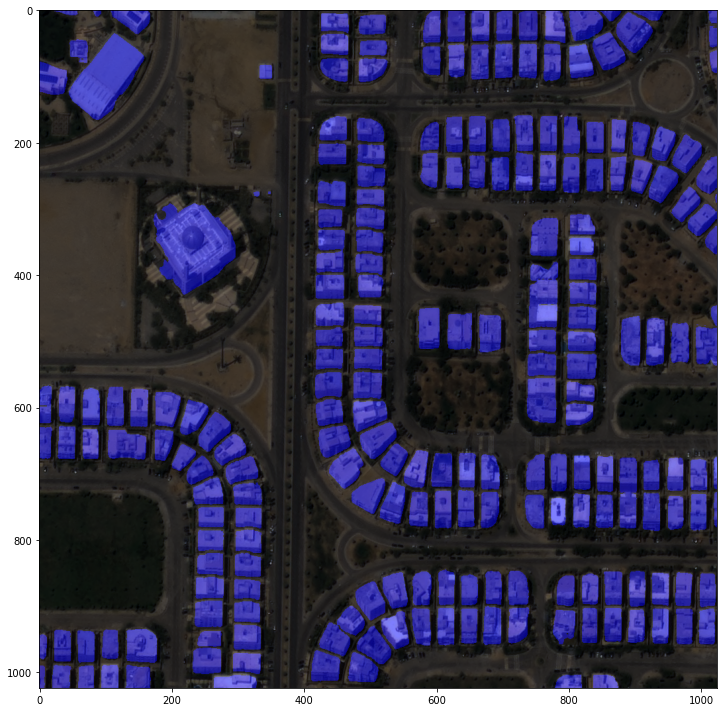

In [ ]:
model.cfg = cfg

img = mmcv.imread('/content/drive/Shareddrives/msmg/level2/dataset/validation/building/image/BLD00033_PS3_K3A_NIA0276.png')
result = inference_segmentor(model, img)
plt.figure(figsize=(10, 10))
show_result_pyplot(model, img, result, palette)

/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


<Figure size 720x720 with 0 Axes>

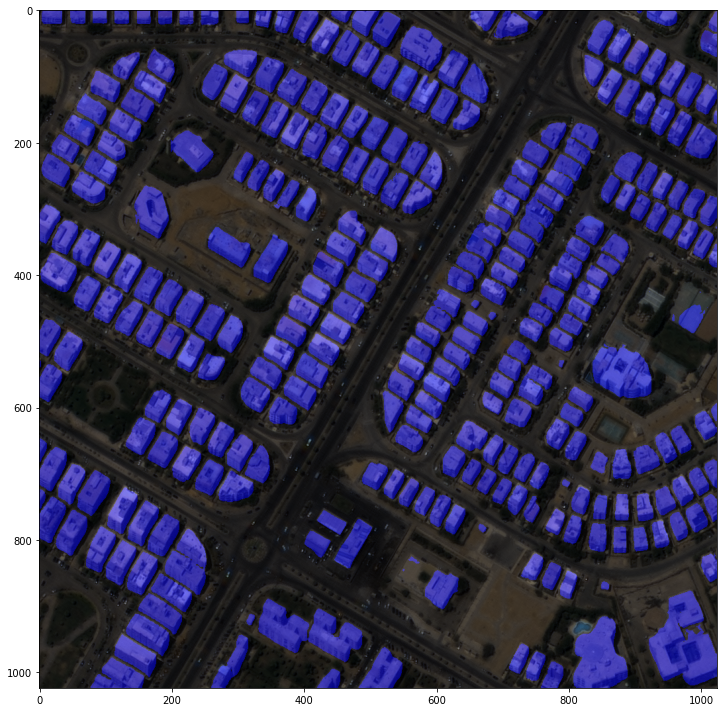

In [ ]:
img = mmcv.imread('/content/drive/Shareddrives/msmg/level2/dataset/validation/building/image/BLD00174_PS3_K3A_NIA0276.png')
result = inference_segmentor(model, img)
plt.figure(figsize=(10, 10))
show_result_pyplot(model, img, result, palette)

/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


<Figure size 720x720 with 0 Axes>

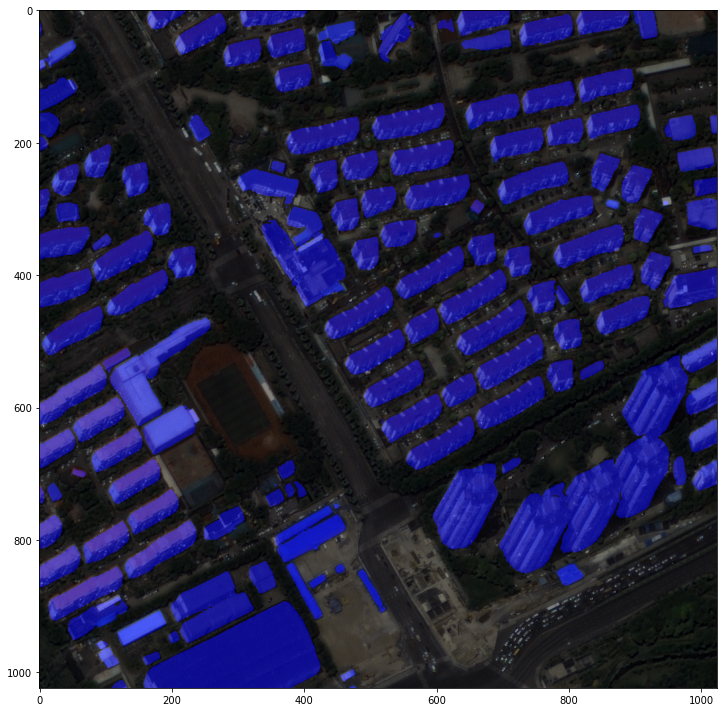

In [ ]:
img = mmcv.imread('/content/drive/Shareddrives/msmg/level2/dataset/validation/building/image/BLD01501_PS3_K3A_NIA0373.png')
result = inference_segmentor(model, img)
plt.figure(figsize=(10, 10))

show_result_pyplot(model, img, result, palette)

/content/mmsegmentation/mmseg/models/losses/cross_entropy_loss.py:236: UserWarning: Default ``avg_non_ignore`` is False, if you would like to ignore the certain label and average loss over non-ignore labels, which is the same with PyTorch official cross_entropy, set ``avg_non_ignore=True``.
  'Default ``avg_non_ignore`` is False, if you would like to '


load checkpoint from local path: /content/drive/MyDrive/SharedData/sia-satellite-data/Level2-Building-Instance-Segmentation/level2_ratio100_SemanticFPN_fpn_r101_512x1024_80k_cityscapes_resize1024_baseline_checkpoints/iter_5000.pth


/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


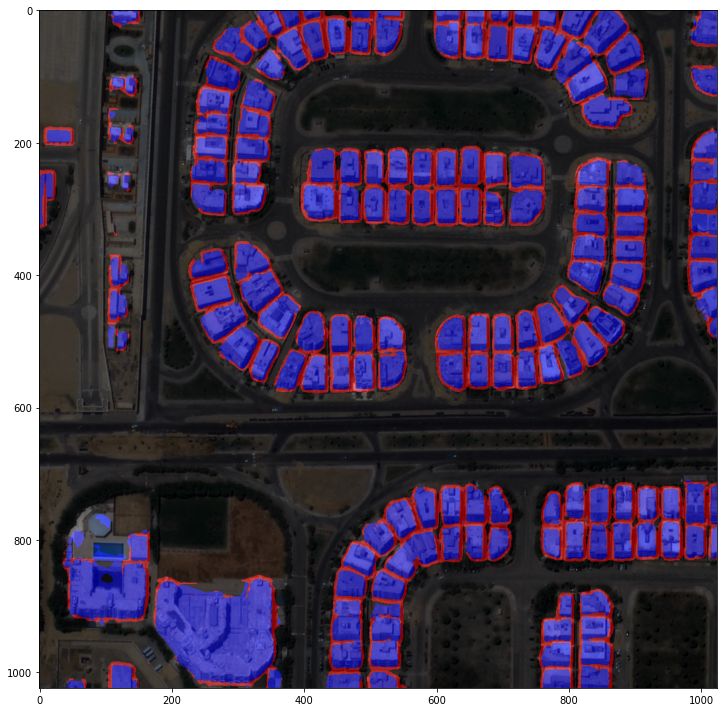

In [ ]:
checkpoint_file = '/content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no2_iter30000_checkpoint/best_mIoU_iter_XXXXX.pth'  # 학습된 가중치 파일

# checkpoint 저장된 model 파일을 이용하여 모델을 생성, 이때 Config는 위에서 update된 config 사용. 
model_ckpt = init_segmentor(cfg, checkpoint_file, device='cuda:0')  #cuda gpu 사용

img = mmcv.imread('/content/drive/Shareddrives/msmg/level2/dataset/validation/building/image/BLD00007_PS3_K3A_NIA0276.png') # inference할 이미지
result = inference_segmentor(model_ckpt, img)
show_result_pyplot(model_ckpt, img, result, palette)

# Inference and evaluation on the test dataset

In [1]:
import torch, torchvision

import mmseg
from mmseg.apis import inference_segmentor, init_segmentor, show_result_pyplot
from mmseg.core.evaluation import get_palette
from mmseg.datasets.builder import DATASETS
from mmseg.datasets.custom import CustomDataset
from mmseg.apis import set_random_seed

import mmcv
from mmcv import Config

import matplotlib.pyplot as plt
import os.path as osp
import numpy as np
from PIL import Image

In [2]:
# convert dataset annotation to semantic segmentation map
data_root = '/content/drive/Shareddrives/msmg/level2/dataset/train/building'
img_dir = 'image'
ann_dir = 'annotation'

# define class and plaette for better visualization
classes = ('background', 'building', 'border')
palette = [[0, 0, 0], [0, 0, 255], [255, 0, 0]]

In [3]:
config_file = '/content/mmsegmentation/configs/hrnet/fcn_hr48_512x512_160k_ade20k.py'
checkpoint_file = '/content/mmsegmentation/checkpoints/fcn_hr48_512x512_160k_ade20k_20200614_214407-a52fc02c.pth'
save_pth_path = '/content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint'

In [4]:
from mmseg.datasets.builder import DATASETS
from mmseg.datasets.custom import CustomDataset

@DATASETS.register_module(force=True)
class BuildingSemanticSegmentation(CustomDataset):
    CLASSES = classes
    PALETTE = palette
    def __init__(self, split, **kwargs):
        super().__init__(img_suffix='.png', seg_map_suffix='.png', split=split, **kwargs)
        assert osp.exists(self.img_dir) and self.split is not None

In [5]:
from mmcv import Config

cfg = Config.fromfile(config_file)

In [6]:
from mmseg.apis import set_random_seed

# add CLASSES and PALETTE to checkpoint
cfg.checkpoint_config.meta = dict(
    CLASSES=classes,
    PALETTE=palette)

# Since we use only one GPU, BN is used instead of SyncBN
cfg.norm_cfg = dict(type='BN', requires_grad=True)

#cfg.model.backbone.norm_cfg = cfg.norm_cfg
cfg.model.decode_head.norm_cfg = cfg.norm_cfg
cfg.model.backbone.norm_cfg = cfg.norm_cfg

# modify num classes of the model in decode/auxiliary head
cfg.model.decode_head.num_classes = 3

# modify loss function crossentropy
cfg.model.decode_head.loss_decode = [
                                     dict(type='CrossEntropyLoss', loss_weight = 1.0),
                                     dict(type='LovaszLoss', loss_weight = 10.0, reduction='none')]


# Modify dataset type and path
cfg.dataset_type = 'BuildingSemanticSegmentation'
cfg.data_root = data_root

cfg.data.samples_per_gpu = 8
cfg.data.workers_per_gpu = 8

# pipline
cfg.img_norm_cfg = dict(
    mean=[123.675, 116.28, 103.53], std=[58.395, 57.12, 57.375], to_rgb=True)
cfg.crop_size = (512, 512)
cfg.train_pipeline = [
    dict(type='LoadImageFromFile'),
    dict(type='LoadAnnotations'),
    dict(type='Resize', img_scale=(1024, 1024), ratio_range=(0.5, 1.5)),
    dict(type='RandomCrop', crop_size=cfg.crop_size, cat_max_ratio=0.75),
    dict(type='RandomFlip', flip_ratio=0.5),
    dict(type='PhotoMetricDistortion'),
    dict(type='Normalize', **cfg.img_norm_cfg),
    dict(type='Pad', size=cfg.crop_size, pad_val=0, seg_pad_val=255),
    dict(type='DefaultFormatBundle'),
    dict(type='Collect', keys=['img', 'gt_semantic_seg']),
]

cfg.test_pipeline = [
    dict(type='LoadImageFromFile'),
    dict(
        type='MultiScaleFlipAug',
        img_scale=(1024, 1024),
        # img_ratios=[0.5, 0.75, 1.0, 1.25, 1.5, 1.75],
        flip=False,
        transforms=[
            dict(type='Resize', keep_ratio=True),
            dict(type='RandomFlip'),
            dict(type='Normalize', **cfg.img_norm_cfg),
            dict(type='ImageToTensor', keys=['img']),
            dict(type='Collect', keys=['img']),
        ])
]

cfg.data.train.type = cfg.dataset_type
cfg.data.train.data_root = '/content/drive/Shareddrives/msmg/level2/dataset/train/building/'
cfg.data.train.img_dir = 'image'
cfg.data.train.ann_dir = 'annotation'
cfg.data.train.pipeline = cfg.train_pipeline
cfg.data.train.split = 'split/train_ratio95.txt'

cfg.data.val.type = cfg.dataset_type
cfg.data.val.data_root = '/content/drive/Shareddrives/msmg/level2/dataset/validation/building/'
cfg.data.val.img_dir = 'image'
cfg.data.val.ann_dir = 'annotation'
cfg.data.val.pipeline = cfg.test_pipeline
cfg.data.val.split = 'split/validation.txt'

cfg.data.test.type = cfg.dataset_type
cfg.data.test.data_root = '/content/drive/Shareddrives/msmg/level2/dataset/validation/building/'
cfg.data.test.img_dir = 'image'
cfg.data.test.ann_dir = 'annotation'
cfg.data.test.pipeline = cfg.test_pipeline
cfg.data.test.split = 'split/validation.txt'

# We can still use the pre-trained Mask RCNN model though we do not need to
# use the mask branch
cfg.load_from = checkpoint_file

# Set up working dir to save files and logs.
cfg.work_dir = save_pth_path

cfg.runner.max_iters = 30000
cfg.log_config.interval = 10
cfg.evaluation.interval = 100
cfg.evaluation.save_best = 'mIoU'
cfg.checkpoint_config.interval = 2000

# Set seed to facitate reproducing the result
cfg.seed = 0
set_random_seed(0, deterministic=False)
cfg.gpu_ids = range(1)

cfg.device='cuda' 

# We can also use tensorboard to log the training process
cfg.log_config.hooks = [
    dict(type='TextLoggerHook'),
    dict(type='TensorboardLoggerHook')]

# Let's have a look at the final config used for training
print(f'Config:\n{cfg.pretty_text}')

Config:
norm_cfg = dict(type='BN', requires_grad=True)
model = dict(
    type='EncoderDecoder',
    pretrained='open-mmlab://msra/hrnetv2_w48',
    backbone=dict(
        type='HRNet',
        norm_cfg=dict(type='BN', requires_grad=True),
        norm_eval=False,
        extra=dict(
            stage1=dict(
                num_modules=1,
                num_branches=1,
                block='BOTTLENECK',
                num_blocks=(4, ),
                num_channels=(64, )),
            stage2=dict(
                num_modules=1,
                num_branches=2,
                block='BASIC',
                num_blocks=(4, 4),
                num_channels=(48, 96)),
            stage3=dict(
                num_modules=4,
                num_branches=3,
                block='BASIC',
                num_blocks=(4, 4, 4),
                num_channels=(48, 96, 192)),
            stage4=dict(
                num_modules=3,
                num_branches=4,
                block='BASIC',
     

/content/mmsegmentation/mmseg/models/losses/cross_entropy_loss.py:236: UserWarning: Default ``avg_non_ignore`` is False, if you would like to ignore the certain label and average loss over non-ignore labels, which is the same with PyTorch official cross_entropy, set ``avg_non_ignore=True``.
  'Default ``avg_non_ignore`` is False, if you would like to '


load checkpoint from local path: /content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_26500.pth


/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


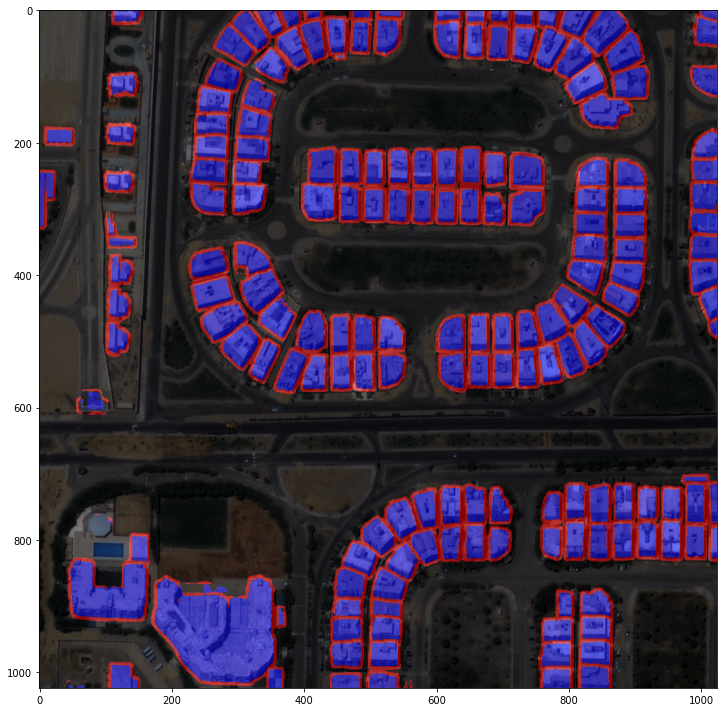

In [7]:
checkpoint_file = '/content/drive/Shareddrives/msmg/level2/source/hrnet/hrnetv2p-w48/no6_iter30000_checkpoint/best_mIoU_iter_26500.pth'  # 학습된 가중치 파일

# checkpoint 저장된 model 파일을 이용하여 모델을 생성, 이때 Config는 위에서 update된 config 사용. 
model_ckpt = init_segmentor(cfg, checkpoint_file, device='cuda:0')  #cuda gpu 사용

img = mmcv.imread('/content/drive/Shareddrives/msmg/level2/dataset/validation/building/image/BLD00007_PS3_K3A_NIA0276.png') # inference할 이미지
result = inference_segmentor(model_ckpt, img)
show_result_pyplot(model_ckpt, img, result, palette)

/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


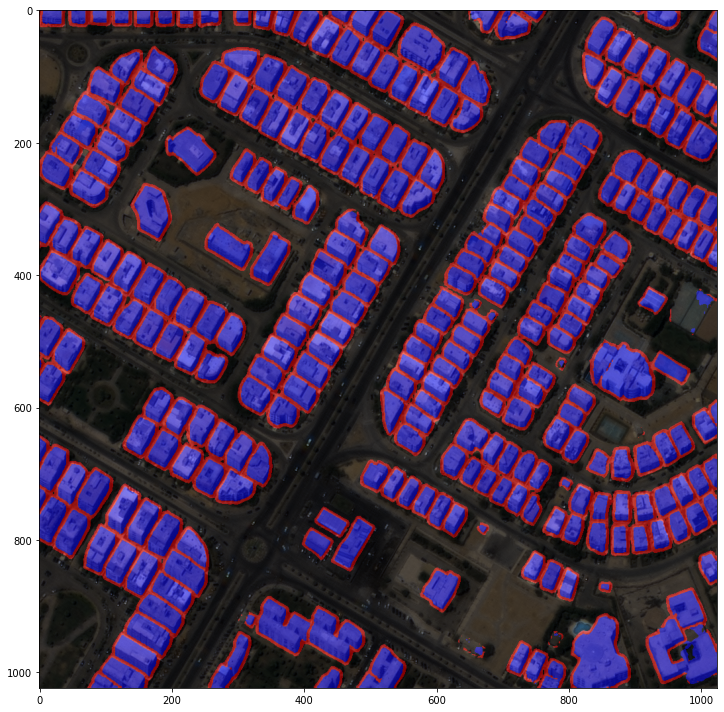

In [8]:
img = mmcv.imread('/content/drive/Shareddrives/msmg/level2/dataset/validation/building/image/BLD00174_PS3_K3A_NIA0276.png') # inference할 이미지
result = inference_segmentor(model_ckpt, img)
show_result_pyplot(model_ckpt, img, result, palette)

/content/mmsegmentation/mmseg/models/segmentors/base.py:289: UserWarning: show==False and out_file is not specified, only result image will be returned
  warnings.warn('show==False and out_file is not specified, only '


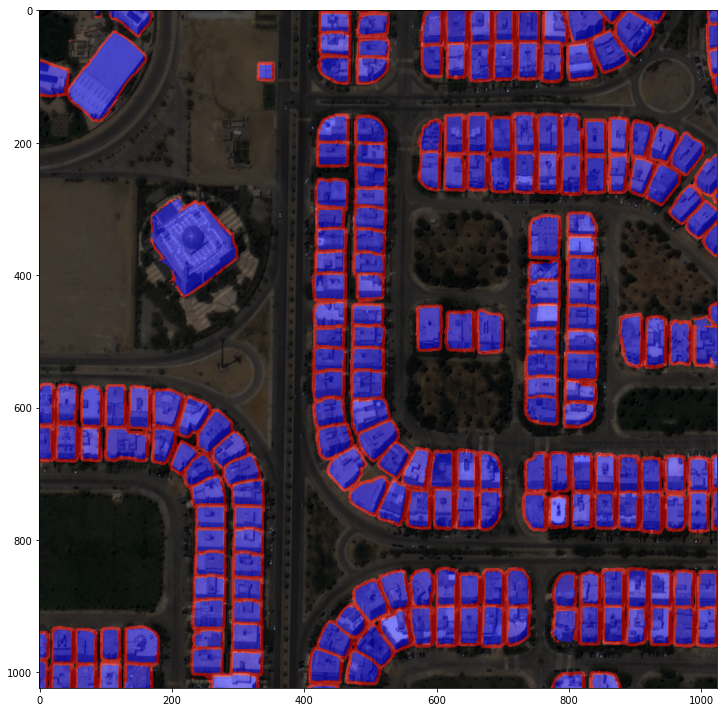

In [9]:
img = mmcv.imread('/content/drive/Shareddrives/msmg/level2/dataset/validation/building/image/BLD00033_PS3_K3A_NIA0276.png') # inference할 이미지
result = inference_segmentor(model_ckpt, img)
show_result_pyplot(model_ckpt, img, result, palette)

In [10]:
from mmseg.datasets import (build_dataloader, build_dataset)

# test용 Dataset과 DataLoader 생성. 
# build_dataset()호출 시 list로 감싸지 않는 것이 train용 dataset 생성시와 차이. 
dataset = build_dataset(cfg.data.test)
data_loader = build_dataloader(
        dataset,
        # 반드시 아래 samples_per_gpu 인자값은 1로 설정
        #samples_per_gpu=cfg.data.samples_per_gpu,
        #workers_per_gpu=cfg.data.workers_per_gpu,
        samples_per_gpu=1,
        workers_per_gpu=1,
        dist=False,
        shuffle=False)

2022-06-19 03:46:19,516 - mmseg - INFO - Loaded 159 images


In [11]:
from mmseg.apis import multi_gpu_test, single_gpu_test
from mmcv.parallel import MMDataParallel, MMDistributedDataParallel
#from mmseg.apis import inference_detector, init_detector, show_result_pyplot

model_ckpt = MMDataParallel(model_ckpt, device_ids=[0])

In [12]:
# single_gpu_test() 를 호출하여 test데이터 세트의 interence 수행. 반드시 batch size는 1이 되어야 함. 
# 위에서 만든 /content/show_test_output 디렉토리에 interence 결과가 시각화된 이미지가 저장됨. 
outputs = single_gpu_test(model_ckpt, data_loader, False, '/content/drive/Shareddrives/msmg/level2/train_output_test2', 1.0)

[                                                  ] 0/159, elapsed: 0s, ETA:

/content/mmsegmentation/mmseg/apis/test.py:69: UserWarning: DeprecationWarning: ``efficient_test`` will be deprecated, the evaluation is CPU memory friendly with pre_eval=True
  'DeprecationWarning: ``efficient_test`` will be deprecated, the '


[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 159/159, 1.9 task/s, elapsed: 82s, ETA:     0s

In [13]:
metric = dataset.evaluate(outputs, metric='mIoU')
print(metric)

per class results:

+------------+-------+-------+
|   Class    |  IoU  |  Acc  |
+------------+-------+-------+
| background | 93.83 | 96.97 |
|  building  | 79.68 | 88.35 |
|   border   | 49.91 | 66.46 |
+------------+-------+-------+
Summary:

+-------+-------+-------+
|  aAcc |  mIoU |  mAcc |
+-------+-------+-------+
| 92.44 | 74.47 | 83.93 |
+-------+-------+-------+
{'aAcc': 0.9244, 'mIoU': 0.7447, 'mAcc': 0.8393, 'IoU.background': 0.9383, 'IoU.building': 0.7968000000000001, 'IoU.border': 0.4991, 'Acc.background': 0.9697, 'Acc.building': 0.8835, 'Acc.border': 0.6646}
